# **Problem Statement**
---
---



#### **Overview:**

DTH company operates in a highly competitive market, where retaining existing customers is increasingly challenging.

---

#### **The Company's Challenge:**
The primary challenge is customer churn, where customers stop doing business.
This churn phenomenon poses a significant threat as losing one account can result in the loss of multiple customers.

---

#### **Why Is It Needed?:**
Addressing churn is crucial for the company:
Enhancing customer loyalty
Competing effectively in the market
Unlocking potential for revenue growth
Elevating the overall customer experience

---

#### **Objective:**
Our objective is to :
- Develop a churn prediction model that enables us to identify potential churners.
- Provide segmented offers to retain these customers. The recommendations will be subject to thorough evaluation by the revenue assurance team to ensure they are in line with our strategic business objectives

---

#### **What is Churn rate?**

---
---



Churn rate (sometimes called attrition rate), in its broadest sense, is a measure of the number of individuals or items moving out of a collective group over a specific period. It is one of two primary factors that determine the steady-state level of customers a business will support.




####          **Data Dictionary**

---
---
| Variable             | Description                                                         |
|----------------------|---------------------------------------------------------------------|
| AccountID            | Account unique identifier                                           |
| Churn                | Account churn flag (Target)                                         |
| Tenure               | Tenure of account                                                  |
| City_Tier            | Tier of the primary customer's city                                 |
| CC_Contacted_L1     | How many times all the customers of the account have contacted customer care in the last 12 months |
| Payment              | Preferred payment mode of the customers in the account              |
| Gender               | Gender of the primary customer of the account                       |
| Service_Score        | Satisfaction score given by customers of the account on the service provided by the company |
| Account_user_count   | Number of customers tagged with this account                        |
| account_segment      | Account segmentation based on spending                               |
| CC_Agent_Score       | Satisfaction score given by customers of the account on customer care service provided by the company |
| Marital_Status       | Marital status of the primary customer of the account                |
| rev_per_month        | Monthly average revenue generated by the account in the last 12 months |
| Complain_l12m        | Any complaints raised by the account in the last 12 months           |
| rev_growth_yoy       | Revenue growth percentage of the account (last 12 months vs. last 24 to 13 months) |
| coupon_used_l12m    | How many times customers have used coupons to make payments in the last 12 months |
| Day_Since_CC_connect | Number of days since no customers in the account have contacted customer care |
| cashback_l12m        | Monthly average cashback generated by the account in the last 12 months |
| Login_device         | Preferred login device                                              |


## Importing Libraries & Loading Data

---
---

In [ ]:
# Importing the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.subplots as sp

from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split, GridSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
import statsmodels.formula.api as SM
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, roc_auc_score, auc
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report

import warnings
warnings.filterwarnings("ignore")

colours = ['#1f77b4', '#fc6c44', '#2b8a2b', '#fc7c7c', '#9467bd', '#4ba4ad', '#c7ad18', '#7f7f7f', '#69d108'];
axtitle_dict = {'family': 'serif','color':  '#010D36','weight': 'bold','size': 16}
axlab_dict = {'family': 'serif', 'color': 'black','size': 14}


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#Loading the dataset
path ='/content/drive/MyDrive/Capstone/CC_EDTH_02_Customer+Churn_02/Customer Churn Data.xlsx'
df= pd.read_excel(path, sheet_name ='Data for DSBA' )


In [ ]:
#Let's check the first & last 5 samples of the data ( Transposed)
display('First 5 samples:',df.head())
display('Last 5 samples:',df.tail())

'First 5 samples:'

,AccountID,Churn,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
0,20000,1,4,3.0,6.0,Debit Card,Female,3.0,3,Super,2.0,Single,9,1.0,11,1,5,159.93,Mobile
1,20001,1,0,1.0,8.0,UPI,Male,3.0,4,Regular Plus,3.0,Single,7,1.0,15,0,0,120.9,Mobile
2,20002,1,0,1.0,30.0,Debit Card,Male,2.0,4,Regular Plus,3.0,Single,6,1.0,14,0,3,NaN,Mobile
3,20003,1,0,3.0,15.0,Debit Card,Male,2.0,4,Super,5.0,Single,8,0.0,23,0,3,134.07,Mobile
4,20004,1,0,1.0,12.0,Credit Card,Male,2.0,3,Regular Plus,5.0,Single,3,0.0,11,1,3,129.6,Mobile


'Last 5 samples:'

,AccountID,Churn,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
11255,31255,0,10,1.0,34.0,Credit Card,Male,3.0,2,Super,1.0,Married,9,0.0,19,1,4,153.71,Computer
11256,31256,0,13,1.0,19.0,Credit Card,Male,3.0,5,HNI,5.0,Married,7,0.0,16,1,8,226.91,Mobile
11257,31257,0,1,1.0,14.0,Debit Card,Male,3.0,2,Super,4.0,Married,7,1.0,22,1,4,191.42,Mobile
11258,31258,0,23,3.0,11.0,Credit Card,Male,4.0,5,Super,4.0,Married,7,0.0,16,2,9,179.9,Computer
11259,31259,0,8,1.0,22.0,Credit Card,Male,3.0,2,Super,3.0,Married,5,0.0,13,2,3,175.04,Mobile


# **Exploratory Data Analysis**

---
---


### **About the dataset**

In [ ]:
#Dimentions of the dataset
print('The number of rows are ',df.shape[0],'\n''The number of columns (variables) are',df.shape[1])

The number of rows are  11260 
The number of columns (variables) are 19


In [ ]:
#Information about the dataset
display(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   AccountID                11260 non-null  int64  
 1   Churn                    11260 non-null  int64  
 2   Tenure                   11158 non-null  object 
 3   City_Tier                11148 non-null  float64
 4   CC_Contacted_LY          11158 non-null  float64
 5   Payment                  11151 non-null  object 
 6   Gender                   11152 non-null  object 
 7   Service_Score            11162 non-null  float64
 8   Account_user_count       11148 non-null  object 
 9   account_segment          11163 non-null  object 
 10  CC_Agent_Score           11144 non-null  float64
 11  Marital_Status           11048 non-null  object 
 12  rev_per_month            11158 non-null  object 
 13  Complain_ly              10903 non-null  float64
 14  rev_growth_yoy        

None

In [ ]:
# Data Format Checks
format_issues = {}
for column in df.columns:
    if df[column].apply(lambda x: not str(x).replace('.', '', 1).replace('-', '', 1).replace('%', '', 1).isdigit()).any():
        format_issues[column] = df[column]
print("Data Format Issues:")
for column, values in format_issues.items():
    print(f"Column '{column}':")
    print(values)

Data Format Issues:
Column 'Tenure':
0         4
1         0
2         0
3         0
4         0
         ..
11255    10
11256    13
11257     1
11258    23
11259     8
Name: Tenure, Length: 11260, dtype: object
Column 'City_Tier':
0        3.0
1        1.0
2        1.0
3        3.0
4        1.0
        ... 
11255    1.0
11256    1.0
11257    1.0
11258    3.0
11259    1.0
Name: City_Tier, Length: 11260, dtype: float64
Column 'CC_Contacted_LY':
0         6.0
1         8.0
2        30.0
3        15.0
4        12.0
         ... 
11255    34.0
11256    19.0
11257    14.0
11258    11.0
11259    22.0
Name: CC_Contacted_LY, Length: 11260, dtype: float64
Column 'Payment':
0         Debit Card
1                UPI
2         Debit Card
3         Debit Card
4        Credit Card
            ...     
11255    Credit Card
11256    Credit Card
11257     Debit Card
11258    Credit Card
11259    Credit Card
Name: Payment, Length: 11260, dtype: object
Column 'Gender':
0        Female
1          Male
2  

#### **About Data**
---
---
The initial data review suggests the need for data preprocessing, including handling missing values and potentially converting data types. Additionally, feature engineering and cleaning will be required to prepare the data for analysis.Below are the key details:

1. **Data Size and Completeness:**
   - The dataset contains 11,260 rows and 19 columns.
   - There are missing values in several columns, indicated by the "Non-Null Count" being less than 11,260.

2. **Target Variable (Churn):**
   - The "Churn" column is binary, indicating whether an account churned or not. This is binary value, hence thisis a classification problem

3. **Categorical and Numerical Features:**
   - The dataset contains a mix of categorical and numerical features.
   - o	Several features are incorrectly labelled as type "object,"  and Numerical which will require data type conversion for analysis.

4. **Tenure and City_Tier:**
   - "Tenure" and "City_Tier" columns have missing values.
   - "City_Tier" is represented as a float, which suggests it may need conversion to an category data type.

5. **CC_Contacted_LY and CC_Agent_Score:**
   - "CC_Contacted_LY" and "CC_Agent_Score" are numerical columns with missing values.
   - These columns appear to relate to customer support or contact.

6. **Payment, Gender, and Marital_Status:**
   - "Payment," "Gender," and "Marital_Status" are categorical features with missing values.
   - They may require data imputation or cleaning.

7. **Service_Score and rev_growth_yoy:**
   - "Service_Score" and "rev_growth_yoy" are numerical columns with no missing values.
   - "rev_growth_yoy" appears to represent revenue growth.

8. **Account_user_count and Account_Segment:**
   - "Account_user_count" and "account_segment" are categorical features with missing values.
   - They may relate to customer segmentation.

9. **Complain_ly and Day_Since_CC_connect:**
   - "Complain_ly" and "Day_Since_CC_connect" have missing values.
   - "Day_Since_CC_connect" appears to relate to customer support.

10. **rev_per_month, coupon_used_for_payment, cashback, and Login_device:**
    - These columns are categorical features with missing values.
    - o	Rev_per_month, coupon_used_for_payment, cashback appears to be numeric that needs to be checked & correct data type assigned



### **Data Cleaning**
---
---


Let's start cleaning the data first. We'll start with the Categorical columns, wherein we will identify unique values in each column through a loop, and fix the values wherever we find data issues


#### Categorical
- Lots of Numeric values seems to be tagged as Object, let's find out by checking their values

In [ ]:
#Let's check unique values in each Categorical column
cat_columns = df.select_dtypes(include = ['object'])

for column in cat_columns:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'Tenure':
[4 0 2 13 11 '#' 9 99 19 20 14 8 26 18 5 30 7 1 23 3 29 6 28 24 25 16 10
 15 22 nan 27 12 21 17 50 60 31 51 61]

Value counts for column 'Payment':
['Debit Card' 'UPI' 'Credit Card' 'Cash on Delivery' 'E wallet' nan]

Value counts for column 'Gender':
['Female' 'Male' 'F' nan 'M']

Value counts for column 'Account_user_count':
[3 4 nan 5 2 '@' 1 6]

Value counts for column 'account_segment':
['Super' 'Regular Plus' 'Regular' 'HNI' 'Regular +' nan 'Super Plus'
 'Super +']

Value counts for column 'Marital_Status':
['Single' 'Divorced' 'Married' nan]

Value counts for column 'rev_per_month':
[9 7 6 8 3 2 4 10 1 5 '+' 130 nan 19 139 102 120 138 127 123 124 116 21
 126 134 113 114 108 140 133 129 107 118 11 105 20 119 121 137 110 22 101
 136 125 14 13 12 115 23 122 117 131 104 15 25 135 111 109 100 103]

Value counts for column 'rev_growth_yoy':
[11 15 14 23 22 16 12 13 17 18 24 19 20 21 25 26 '$' 4 27 28]

Value counts for column 'coupon_used_for_payment'

**Column value counts include a mix of valid and invalid entries, potentially requiring data cleaning and standardization.:**


**NAN / Missing Values:** Below columns have Nan present:
```
Tenure, City_Tier, CC_Contacted_LY, Payment, Gender, Service_Score, Account_user_count, account_segment,
CC_Agent_Score, Marital_Status, rev_per_month, Complain_ly, Day_Since_CC_connect, cashback, Login_device
```

**Unexpected Values:**
```
- Tenure (Unexpected values like '#', high numerical values)
- Account_user_count (Unexpected value '@' alongside numerical counts)
- Gender (Inconsistent formatting with 'F' and 'M' alongside 'Female' and 'Male')
- rev_per_month (Unexpected values like ' + ', high numerical values)
- rev_growth_yoy (Unexpected values like ' $ ' mixed with numerical values)
- coupon_used_for_payment (Unexpected values like '#', '$', and '*' mixed with numerical values)
- Day_Since_CC_connect (Unexpected values like '$' mixed with numerical values)
- Login_device (Unexpected value '&&&&' alongside 'Mobile' and 'Computer')
```
Let's address these issues one by one, first we will fix the unexpected values

In [ ]:
#Tenure
'''
- Tenure should be numeric , but mentioned object.
- Due to a "#" in the data, it shows wrong data type
- Let's first replace it with nan & change to numeric
'''

df['Tenure'] = df['Tenure'].replace('#', np.nan)
df['Tenure'] = pd.to_numeric(df['Tenure'], errors='coerce', downcast='integer')

In [ ]:
#Account_user
'''
- Account_user count should be numeric , but mentioned object.
- Due to a @ in the data, it shows wrong data type.
- Let's first replace it with NaN & change to numeric
'''

df['Account_user_count'] = df['Account_user_count'].replace('@', np.nan)
df['Account_user_count'] = pd.to_numeric(df['Account_user_count'], errors='coerce', downcast='integer')


In [ ]:
#"rev_per_month"
'''
- "rev_per_month"  should be numeric , but mentioned object.
- Due to a + in the data, it shows wrong data type.
- Let's first replace it with NaN & change to numeric
'''

df['rev_per_month'] = df['rev_per_month'].replace('+', np.nan)
df['rev_per_month'] = pd.to_numeric(df['rev_per_month'], errors='coerce', downcast='integer')


In [ ]:
#rev_growth_yoy
'''
- rev_growth_yoy should be numeric , but mentioned object.
- Due to a + in the data, it shows wrong data type.
- Let's first replace it with NaN & change to numeric
'''

df['rev_growth_yoy'] = df['rev_growth_yoy'].replace('$', np.nan)
df['rev_growth_yoy'] = pd.to_numeric(df['rev_growth_yoy'], errors='coerce', downcast='integer')


In [ ]:
#coupon_used_for_payment
'''
- coupon_used_for_payment  should be numeric , but mentioned object.
- Due to a #, $,* in the data, it shows wrong data type.
- Let's first replace it with NaN & change to numeric
'''

df['coupon_used_for_payment'] = df['coupon_used_for_payment'].replace(('$','*', '#'), np.nan)
df['coupon_used_for_payment'] = pd.to_numeric(df['coupon_used_for_payment'], errors='coerce', downcast='integer')


In [ ]:
#Day_Since_CC_connect
'''
- Day_Since_CC_connect  should be numeric , but mentioned object.
- Due to  $ in the data, it shows wrong data type.
- Let's first replace it with NaN & change to numeric
'''

df['Day_Since_CC_connect'] = df['Day_Since_CC_connect'].replace('$' , np.nan)
df['Day_Since_CC_connect'] = pd.to_numeric(df['Day_Since_CC_connect'], errors='coerce', downcast='integer')


In [ ]:
#Gender
'''
- m & F mentioned instead of male or Female for member in Gender
- Let's replace with Correct Values as 'F': 'Female', 'M':'Male'
'''

df['Gender'] = df['Gender'].replace({'F': 'Female', 'M':'Male'})


In [ ]:
#account_segment
'''
- In account segment we see values as  + as well as plus, for better understanding let's keep them same.
- Let's replace Regular +': 'Regular Plus', 'Super +':'Super Plus'
'''

df['account_segment'] = df['account_segment'].replace({'Regular +': 'Regular Plus', 'Super +':'Super Plus'})

In [ ]:
#Cashback
'''
- while checking unique, we couldn't find any issue in Cashback column due to large no of values
- Let's check which one is non-numeric column in Cashback by a function
'''

#Definimg custom function to find non-numeric
def has_non_numeric_chars(value):
    try:
        float(value)
        return False
    except ValueError:
        return True

non_numeric_mask = df['cashback'].apply(has_non_numeric_chars)
rows_with_non_numeric = df[non_numeric_mask]
unique_non_numeric_values = rows_with_non_numeric['cashback'].unique()
print(unique_non_numeric_values)

['$']


In [ ]:
# We found that there is presence of "$" in the values causing Cashbck to show as Object.
#Let's replace it with Nan

df['cashback'] = df['cashback'].replace('$' , np.nan)
df['cashback'] = pd.to_numeric(df['cashback'], errors='coerce', downcast='float')

In [ ]:
#Login_device
#This column has Unexpected value '&&&&' alongside 'Mobile' and 'Computer'. Let's replace it with Nan

df['Login_device'] = df['Login_device'].replace({'&&&&': np.nan })

In [ ]:
#Let's check unique values in each Categorical column after changes
cat_columns = df.select_dtypes(include = ['object'])

for column in cat_columns:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()


Value counts for column 'Payment':
['Debit Card' 'UPI' 'Credit Card' 'Cash on Delivery' 'E wallet' nan]

Value counts for column 'Gender':
['Female' 'Male' nan]

Value counts for column 'account_segment':
['Super' 'Regular Plus' 'Regular' 'HNI' nan 'Super Plus']

Value counts for column 'Marital_Status':
['Single' 'Divorced' 'Married' nan]

Value counts for column 'Login_device':
['Mobile' 'Computer' nan]



- We see that the unexpected values has been either replaced or converted to NaN.
- Further, the columns " rev_per_month", rev_growth_yoy", "coupon_used_for_payment ", "Day_Since_CC_connect ", "Cashback" post treatment has been changed to Numeric.
- We will Treat NaN's later

**The bad data is fixed for categorical. Now, let's check for Numerical columns**



#### Numeric columns

In [ ]:
#Dropping Target column & account id for numerical columns
num_columns = df.select_dtypes(include=['float64', 'int64']).drop(columns=['AccountID','Churn'])

In [ ]:
#Let's check unique values in each Numeric columns for any inconsistancy
for column in num_columns:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'Tenure':
[ 4.  0.  2. 13. 11. nan  9. 99. 19. 20. 14.  8. 26. 18.  5. 30.  7.  1.
 23.  3. 29.  6. 28. 24. 25. 16. 10. 15. 22. 27. 12. 21. 17. 50. 60. 31.
 51. 61.]

Value counts for column 'City_Tier':
[ 3.  1. nan  2.]

Value counts for column 'CC_Contacted_LY':
[  6.   8.  30.  15.  12.  22.  11.   9.  31.  18.  13.  20.  29.  28.
  26.  14.  10.  25.  27.  17.  23.  33.  19.  35.  24.  16.  32.  21.
  nan  34.   5.   4. 126.   7.  36. 127.  42.  38.  37.  39.  40.  41.
 132.  43. 129.]

Value counts for column 'Service_Score':
[ 3.  2.  1. nan  0.  4.  5.]

Value counts for column 'Account_user_count':
[ 3.  4. nan  5.  2.  1.  6.]

Value counts for column 'CC_Agent_Score':
[ 2.  3.  5.  4. nan  1.]

Value counts for column 'rev_per_month':
[  9.   7.   6.   8.   3.   2.   4.  10.   1.   5.  nan 130.  19. 139.
 102. 120. 138. 127. 123. 124. 116.  21. 126. 134. 113. 114. 108. 140.
 133. 129. 107. 118.  11. 105.  20. 119. 121. 137. 110.  22. 101. 136.
 125.  

- Column value counts vary and include missing(NaN)

In [ ]:
# Check Negative values
negative_values = (num_columns < 0).any()
print("Columns with negative values:")
print(negative_values[negative_values].index)


Columns with negative values:
Index([], dtype='object')


- No negative values in your numeric columns

In [ ]:
#Non -digit entries in Numeric columns other than NAN (Though we already checked this earlier)
non_digit_values = {}
for column in num_columns.columns:
    try:
        num_columns[column].astype(float)
    except ValueError:
        non_digit_values[column] = num_columns[~num_columns[column].str.replace('.', '', 1).str.isnumeric()][column]

print("Columns with non-digit entries:")
print(non_digit_values)


Columns with non-digit entries:
{}


In [ ]:
num_columns.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11042 non-null  float64
 1   City_Tier                11148 non-null  float64
 2   CC_Contacted_LY          11158 non-null  float64
 3   Service_Score            11162 non-null  float64
 4   Account_user_count       10816 non-null  float64
 5   CC_Agent_Score           11144 non-null  float64
 6   rev_per_month            10469 non-null  float64
 7   Complain_ly              10903 non-null  float64
 8   rev_growth_yoy           11257 non-null  float64
 9   coupon_used_for_payment  11257 non-null  float64
 10  Day_Since_CC_connect     10902 non-null  float64
dtypes: float64(11)
memory usage: 967.8 KB


- Numeric columns seems fine except the data types of : AccountID , Churn, City_Tier, Complain_ly , CC_Agent_Score.
Let's convert these to object since these are Ordinal/Categorical Variables


In [ ]:
# Change numeric columns to categorical
df['AccountID'] = df['AccountID'].astype(str)
df['City_Tier'] = df['City_Tier'].astype(str)
df['Complain_ly'] = df['Complain_ly'].astype(str)
df['Service_Score'] = df['Service_Score'].astype(str)
df['Account_user_count'] = df['Account_user_count'].astype(str)
df['CC_Agent_Score'] = df['CC_Agent_Score'].astype(str)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   AccountID                11260 non-null  object 
 1   Churn                    11260 non-null  int64  
 2   Tenure                   11042 non-null  float64
 3   City_Tier                11260 non-null  object 
 4   CC_Contacted_LY          11158 non-null  float64
 5   Payment                  11151 non-null  object 
 6   Gender                   11152 non-null  object 
 7   Service_Score            11260 non-null  object 
 8   Account_user_count       11260 non-null  object 
 9   account_segment          11163 non-null  object 
 10  CC_Agent_Score           11260 non-null  object 
 11  Marital_Status           11048 non-null  object 
 12  rev_per_month            10469 non-null  float64
 13  Complain_ly              11260 non-null  object 
 14  rev_growth_yoy        

Now, the data type has been fixed. We have 8 Numerical & 11 Categorical column. For Now, we have kept "Churn as Numeric", which is Target & binary column

In [ ]:
#Numerical Columns
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Churn,11260.0,0.168384,0.374223,0.0,0.000000,0.00,0.000000,1.0
Tenure,11042.0,11.025086,12.879782,0.0,2.000000,9.00,16.000000,99.0
CC_Contacted_LY,11158.0,17.867091,8.853269,4.0,11.000000,16.00,23.000000,132.0
rev_per_month,10469.0,6.362594,11.909686,1.0,3.000000,5.00,7.000000,140.0
rev_growth_yoy,11257.0,16.193391,3.757721,4.0,13.000000,15.00,19.000000,28.0
coupon_used_for_payment,11257.0,1.790619,1.969551,0.0,1.000000,1.00,2.000000,16.0
Day_Since_CC_connect,10902.0,4.633187,3.697637,0.0,2.000000,3.00,8.000000,47.0
cashback,10787.0,196.236343,178.660522,0.0,147.210007,165.25,200.009995,1997.0


**Descriptive Summary**
- The average **tenure** of accounts is approximately 11 months, with a wide range from 0 to 99 months.
- On average,  **customer care connect** in last yer was approximately 17.87 times in the last year, with a range from 4 to 132 times.
- The average **monthly revenue generated** by accounts is 6.36, with a wide range from 1.0 to 140.0.
- The accounts show an average **year-over-year revenue growth** of approximately 16.19%, with values ranging from 4.0% to 28.0%.
- On average, accounts use approximately 1.79 **coupons for payments**, with a range from 0 to 16 coupons.
- On average, accounts have not **contacted customer care** for approximately 4.63 days, with a range from 0 to 47 days
- The average **monthly cashback** generated by accounts is approximately 196.24, with a range from 0.0 to 1997.0.

In [ ]:
#Categorical COlumns
df.select_dtypes(include = ['object']).describe().T

,count,unique,top,freq
AccountID,11260,11260,20000,1
City_Tier,11260,4,1.0,7263
Payment,11151,5,Debit Card,4587
Gender,11152,2,Male,6704
Service_Score,11260,7,3.0,5490
Account_user_count,11260,7,4.0,4569
account_segment,11163,5,Regular Plus,4124
CC_Agent_Score,11260,6,3.0,3360
Marital_Status,11048,3,Married,5860
Complain_ly,11260,3,0.0,7792


**Descriptive Summary of Categorical columns**

- **AccountID**: All 11260 entries are unique.
- **City_Tier**: There are 4 unique city tiers. The most frequent city tier is 1.0, which appears 7263 times.
- **Payment**: There are 5 unique payment methods. The most frequent payment method is "Debit Card," occurring 4587 times.
- **Gender**: There are 2 unique genders. "Male" is the most frequent gender, with 6704 occurrences.
- **Service_Score**: There are 7 unique service scores. The most frequent service score is 3.0, appearing 5490 times.
- **Account User count**- Most of the accounts has user count of 4 (4569), with a minimum of 1 and a maximum of 6 users.
-**account_segment**: There are 5 unique account segments. "Regular Plus" is the most frequent account segment, occurring 4124 times.
- **CC_Agent_Score**: There are 6 unique customer care agent scores. The most frequent agent score is 3.0, with 3360 occurrences.
- **Marital_Status**: There are 3 unique marital statuses. "Married" is the most frequent status, occurring 5860 times.
- **Complain_ly**: There are 3 unique values. The most frequent value is 0.0, appearing 7792 times.
- **Login_device**: There are 2 unique login devices. "Mobile" is the most frequent login device, occurring 7482 times.

### Duplicate values

In [ ]:
print(' Total duplicates in the data are:', df.duplicated().sum())

 Total duplicates in the data are: 0


### Missing Values
- Below are the columns & corresponding missing values

In [ ]:
df = df.applymap(lambda x: np.nan if x == 'nan' else x) #Replacing all string NaN values to Np.nan, in case any

In [ ]:
#Let's see how much are the missing values from the datset
RED, BOLD, RESET = '\033[91m', '\033[1m','\033[0m'
total_missing = df.isnull().sum().sum()
total_cells = df.size
missing_percentage = (total_missing / total_cells) * 100
print(f"The total number of missing values are {BOLD}{RED}{total_missing}{RESET}, which is {BOLD}{RED}{missing_percentage:.2f}%{RESET} of total data.")

The total number of missing values are 4361, which is 2.04% of total data.


In [ ]:
# Lets check count & % of missing values in the dataset
missing = df.columns[df.isna().any()].tolist()
total_rows = len(df)
for column in missing:
    missing_count = df[column].isna().sum()
    missing_percentage = (missing_count / total_rows) * 100
    print(f"{BOLD}{column}{RESET} has {BOLD}{RED}{missing_count}{RESET} missing values, which is {BOLD}{RED}{missing_percentage:.2f}%{RESET} of the column.")


Tenure has 218 missing values, which is 1.94% of the column.
City_Tier has 112 missing values, which is 0.99% of the column.
CC_Contacted_LY has 102 missing values, which is 0.91% of the column.
Payment has 109 missing values, which is 0.97% of the column.
Gender has 108 missing values, which is 0.96% of the column.
Service_Score has 98 missing values, which is 0.87% of the column.
Account_user_count has 444 missing values, which is 3.94% of the column.
account_segment has 97 missing values, which is 0.86% of the column.
CC_Agent_Score has 116 missing values, which is 1.03% of the column.
Marital_Status has 212 missing values, which is 1.88% of the column.
rev_per_month has 791 missing values, which is 7.02% of the column.
Complain_ly has 357 missing values, which is 3.17% of the column.
rev_growth_yoy has 3 missing values, which is 0.03% of the column.
coupon_used_for_payment has 3 missing values, which is 0.03% of the column.
Day_Since_CC_connect has 358 missing values, which is 3.18

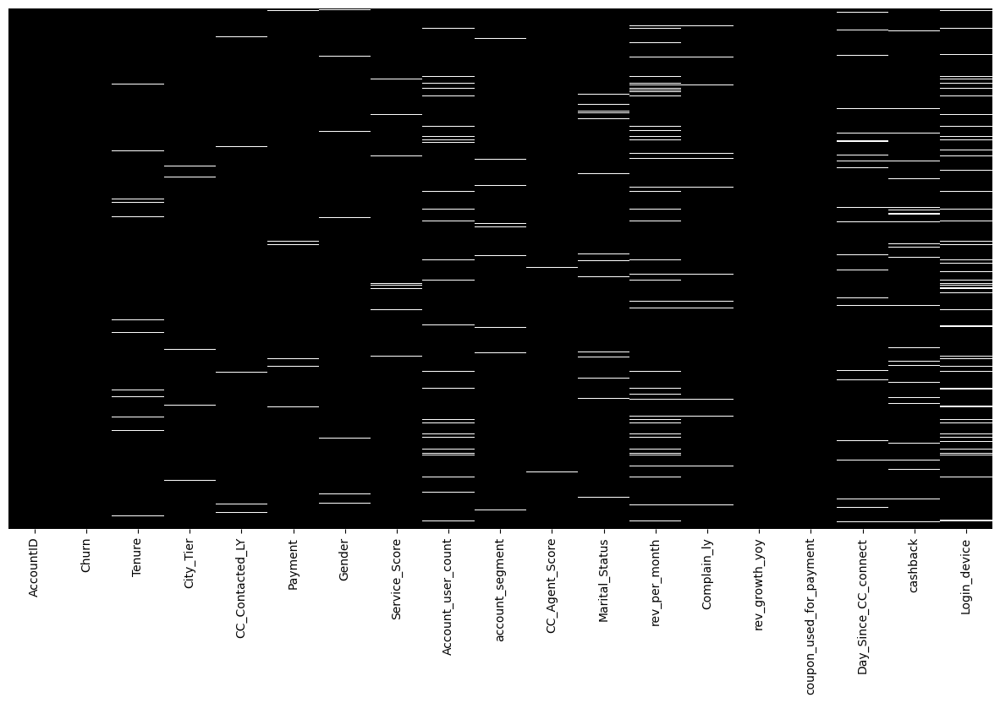

In [ ]:
#Plotting missing values across rows & columns
plt.figure(figsize=(15, 8))
plt.rcParams['axes.facecolor'] = 'black'
cmap = sns.color_palette(['black', 'white'])
sns.heatmap(df.isnull(), cbar=False, cmap=cmap,
            yticklabels=False, vmin=0, vmax=1, cbar_kws={'color': 'white'})
plt.show()

- Since no Column has Significant missing values (>25%), however, these are not too less to be dropped. Hence we can't drop them, we will treat them .

#### Let's inspect total missing values by each row.

In [ ]:
missing_rows = df.isna().sum(axis=1).sort_values(ascending=False)
print(missing_rows)

2312     3
9053     3
9868     3
3092     3
3086     3
        ..
4356     0
4357     0
4358     0
4361     0
11259    0
Length: 11260, dtype: int64


In [ ]:
#Let's filter the data which is >90% or more complete at the row level
df_temp = df[df.isnull().sum(axis = 1) <= 2]

In [ ]:
df_temp.shape

(10927, 19)

In [ ]:
df.shape #Original

(11260, 19)

- We originally had 11260 rows,  not much difference in terms of row reduction, hence we will not make changes on reducing rows here.

- No Column has significant missing values (>25%) hence we will not drop columns as well.

- Let's impute missing values


### Imputing Missing Values



- We will impute all missing in categorical using Mode
- For all Numeric, we will use KNN imputer


In [ ]:
for column in df:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'AccountID':
['20000' '20001' '20002' ... '31257' '31258' '31259']

Value counts for column 'Churn':
[1 0]

Value counts for column 'Tenure':
[ 4.  0.  2. 13. 11. nan  9. 99. 19. 20. 14.  8. 26. 18.  5. 30.  7.  1.
 23.  3. 29.  6. 28. 24. 25. 16. 10. 15. 22. 27. 12. 21. 17. 50. 60. 31.
 51. 61.]

Value counts for column 'City_Tier':
['3.0' '1.0' nan '2.0']

Value counts for column 'CC_Contacted_LY':
[  6.   8.  30.  15.  12.  22.  11.   9.  31.  18.  13.  20.  29.  28.
  26.  14.  10.  25.  27.  17.  23.  33.  19.  35.  24.  16.  32.  21.
  nan  34.   5.   4. 126.   7.  36. 127.  42.  38.  37.  39.  40.  41.
 132.  43. 129.]

Value counts for column 'Payment':
['Debit Card' 'UPI' 'Credit Card' 'Cash on Delivery' 'E wallet' nan]

Value counts for column 'Gender':
['Female' 'Male' nan]

Value counts for column 'Service_Score':
['3.0' '2.0' '1.0' nan '0.0' '4.0' '5.0']

Value counts for column 'Account_user_count':
['3.0' '4.0' nan '5.0' '2.0' '1.0' '6.0']

Value 

In [ ]:
df_X = df.drop(columns=['Churn','AccountID'], axis = 1)
df_Y = df['Churn']

In [ ]:
num_columns = df_X.select_dtypes(include=['number']).columns
cat_columns = df_X.select_dtypes(include = ['object'])


In [ ]:
display("Numerical:" , num_columns,  "Categiorical:" , cat_columns.columns)

'Numerical:'

Index(['Tenure', 'CC_Contacted_LY', 'rev_per_month', 'rev_growth_yoy',
       'coupon_used_for_payment', 'Day_Since_CC_connect', 'cashback'],
      dtype='object')

'Categiorical:'

Index(['City_Tier', 'Payment', 'Gender', 'Service_Score', 'Account_user_count',
       'account_segment', 'CC_Agent_Score', 'Marital_Status', 'Complain_ly',
       'Login_device'],
      dtype='object')

**Imputing Categorical Using Mode**


In [ ]:
#Imputing Categorical Using Mode
for i in cat_columns:
  df_X[i].fillna(df_X[i].mode()[0], inplace = True)

In [ ]:
cat_columns = df_X[['City_Tier', 'Payment', 'Gender', 'Service_Score', 'Account_user_count',
               'account_segment', 'CC_Agent_Score', 'Marital_Status', 'Complain_ly',
               'Login_device']]

In [ ]:
df_X.isnull().sum()

Tenure                     218
City_Tier                    0
CC_Contacted_LY            102
Payment                      0
Gender                       0
Service_Score                0
Account_user_count           0
account_segment              0
CC_Agent_Score               0
Marital_Status               0
rev_per_month              791
Complain_ly                  0
rev_growth_yoy               3
coupon_used_for_payment      3
Day_Since_CC_connect       358
cashback                   473
Login_device                 0
dtype: int64

**Imputing Numerical Using KNN**


##### Encoding the categorical variables

For Numerical, let's Encode & Scale the data

In [ ]:
#Label encoding for Nominal-categorical colums
from sklearn.preprocessing import LabelEncoder

label_encoders = {}
LE = LabelEncoder()
for i in ['City_Tier', 'CC_Agent_Score', 'Complain_ly','Service_Score','Account_user_count','Payment', 'Gender', 'account_segment','Marital_Status', 'Login_device' ]:
  df_X[i] = LE.fit_transform(df_X[i])
  label_encoders[i] = LE  # Save the label encoder for the columns

In [ ]:
df_X.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
0,4.0,2,6.0,2,0,3,2,3,1,2,9.0,1,11.0,1.0,5.0,159.929993,1
1,0.0,0,8.0,4,1,3,3,2,2,2,7.0,1,15.0,0.0,0.0,120.900002,1
2,0.0,0,30.0,2,1,2,3,2,2,2,6.0,1,14.0,0.0,3.0,NaN,1
3,0.0,2,15.0,2,1,2,3,3,4,2,8.0,0,23.0,0.0,3.0,134.070007,1
4,0.0,0,12.0,1,1,2,2,2,4,2,3.0,0,11.0,1.0,3.0,129.600006,1


In [ ]:
df_X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11042 non-null  float64
 1   City_Tier                11260 non-null  int64  
 2   CC_Contacted_LY          11158 non-null  float64
 3   Payment                  11260 non-null  int64  
 4   Gender                   11260 non-null  int64  
 5   Service_Score            11260 non-null  int64  
 6   Account_user_count       11260 non-null  int64  
 7   account_segment          11260 non-null  int64  
 8   CC_Agent_Score           11260 non-null  int64  
 9   Marital_Status           11260 non-null  int64  
 10  rev_per_month            10469 non-null  float64
 11  Complain_ly              11260 non-null  int64  
 12  rev_growth_yoy           11257 non-null  float64
 13  coupon_used_for_payment  11257 non-null  float64
 14  Day_Since_CC_connect  

In [ ]:
df_Y.info()

<class 'pandas.core.series.Series'>
RangeIndex: 11260 entries, 0 to 11259
Series name: Churn
Non-Null Count  Dtype
--------------  -----
11260 non-null  int64
dtypes: int64(1)
memory usage: 88.1 KB


#### Scaling

In [ ]:
#Scale the Predictors
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df_X[num_columns] = pd.DataFrame(scaler.fit_transform(df_X[num_columns]), columns=num_columns)


In [ ]:
df1 = pd.concat([df_X,df_Y], axis = 1)
df1.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2,-1.340479,2,0,3,2,3,1,2,0.221461,1,-1.382120,-0.401439,0.099207,-0.203224,1,1
1,-0.856038,0,-1.114564,4,1,3,3,2,2,2,0.053522,1,-0.317598,-0.909191,-1.253070,-0.421693,1,1
2,-0.856038,0,1.370505,2,1,2,3,2,2,2,-0.030447,1,-0.583728,-0.909191,-0.441704,NaN,1,1
3,-0.856038,2,-0.323860,2,1,2,3,3,4,2,0.137492,0,1.811447,-0.909191,-0.441704,-0.347974,1,1
4,-0.856038,0,-0.662733,1,1,2,2,2,4,2,-0.282355,0,-1.382120,-0.401439,-0.441704,-0.372995,1,1


##### Imputing the remaining missing values

In [ ]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=5)

In [ ]:
df1 = pd.DataFrame(imputer.fit_transform(df1), columns = df1.columns)

In [ ]:
df1.isnull().sum()

Tenure                     0
City_Tier                  0
CC_Contacted_LY            0
Payment                    0
Gender                     0
Service_Score              0
Account_user_count         0
account_segment            0
CC_Agent_Score             0
Marital_Status             0
rev_per_month              0
Complain_ly                0
rev_growth_yoy             0
coupon_used_for_payment    0
Day_Since_CC_connect       0
cashback                   0
Login_device               0
Churn                      0
dtype: int64

In [ ]:
#Let's check missing values post treatmenr
print('Missing Values in the dataset after treatment :', df1.isnull().sum().sum())

Missing Values in the dataset after treatment : 0


- Finally, all missing values imputed in the dataset.
- The  predictors are scaled as we used the KNN imputer to impute the missing values.
- Let's Proceed further

In [ ]:
df1.head() #This is out scaled & encoded dataframe for further modeling

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,1.0


In [ ]:
#Creating a copy of scaled dataframe df1
df2= df1.copy()

In [ ]:
#We will reverse scale the numerical column for Visualization
df2[num_columns] = scaler.inverse_transform(df2[num_columns])

In [ ]:
#Storing it in df_temp for Visualization
df_temp = pd.concat([df2[num_columns],cat_columns,df_Y], axis = 1)
df_temp.head()

,Tenure,CC_Contacted_LY,rev_per_month,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,City_Tier,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,Complain_ly,Login_device,Churn
0,4.0,6.0,9.0,11.0,1.0,5.0,159.929993,3.0,Debit Card,Female,3.0,3.0,Super,2.0,Single,1.0,Mobile,1
1,0.0,8.0,7.0,15.0,0.0,0.0,120.900002,1.0,UPI,Male,3.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1
2,0.0,30.0,6.0,14.0,0.0,3.0,128.001999,1.0,Debit Card,Male,2.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1
3,0.0,15.0,8.0,23.0,0.0,3.0,134.070007,3.0,Debit Card,Male,2.0,4.0,Super,5.0,Single,0.0,Mobile,1
4,0.0,12.0,3.0,11.0,1.0,3.0,129.600006,1.0,Credit Card,Male,2.0,3.0,Regular Plus,5.0,Single,0.0,Mobile,1


In [ ]:
df_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11260 non-null  float64
 1   CC_Contacted_LY          11260 non-null  float64
 2   rev_per_month            11260 non-null  float64
 3   rev_growth_yoy           11260 non-null  float64
 4   coupon_used_for_payment  11260 non-null  float64
 5   Day_Since_CC_connect     11260 non-null  float64
 6   cashback                 11260 non-null  float64
 7   City_Tier                11260 non-null  object 
 8   Payment                  11260 non-null  object 
 9   Gender                   11260 non-null  object 
 10  Service_Score            11260 non-null  object 
 11  Account_user_count       11260 non-null  object 
 12  account_segment          11260 non-null  object 
 13  CC_Agent_Score           11260 non-null  object 
 14  Marital_Status        

In [ ]:
round(df_temp.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
Tenure,11260.0,11.01,12.81,0.0,2.00,9.00,16.00,99.0
CC_Contacted_LY,11260.0,17.86,8.84,4.0,11.00,16.00,23.00,132.0
rev_per_month,11260.0,6.35,11.57,1.0,3.00,5.00,7.00,140.0
rev_growth_yoy,11260.0,16.19,3.76,4.0,13.00,15.00,19.00,28.0
coupon_used_for_payment,11260.0,1.79,1.97,0.0,1.00,1.00,2.00,16.0
Day_Since_CC_connect,11260.0,4.63,3.68,0.0,2.00,3.00,8.00,47.0
cashback,11260.0,196.10,175.71,0.0,147.18,165.24,200.25,1997.0
Churn,11260.0,0.17,0.37,0.0,0.00,0.00,0.00,1.0


- Post Null Imputation, the Statistical summary of data apears to almost same as earlier

In [ ]:
#Categorical COlumns
df_temp.select_dtypes(include = ['object']).describe().T

,count,unique,top,freq
City_Tier,11260,3,1.0,7375
Payment,11260,5,Debit Card,4696
Gender,11260,2,Male,6812
Service_Score,11260,6,3.0,5588
Account_user_count,11260,6,4.0,5013
account_segment,11260,5,Regular Plus,4221
CC_Agent_Score,11260,5,3.0,3476
Marital_Status,11260,3,Married,6072
Complain_ly,11260,2,0.0,8149
Login_device,11260,2,Mobile,8242


- For categorical columns, since mode imputation was done, the Frequenct of Top value has been increased which is expected

### Data Visualization
---
---


Note: Univariate & Bivariate Analysis is done on the original data, not the treated datset.

#### **Univariate Analysis**



##### Distribution of Target Variable

In [ ]:
# Distribution of Target Variable
fig = px.pie(
    df_temp.assign(ClassMap=df.Churn.map({0: "Not Churn", 1: "Churn"})),
    names="ClassMap", hole=0.5,
    color_discrete_sequence=["#79a5db", "#e0a580"])
fig.update_layout(
    height=540,width=900,
    title_font_size=18, plot_bgcolor='#ffffff', paper_bgcolor='#ffffff',  showlegend=False,)
fig.add_annotation(
    x=0.5, y=0.5, align="center", xref="paper",
    yref="paper", showarrow=False, font_size=22, text="Target<br>Variable",)
fig.update_traces(
    hovertemplate=None, textposition="outside", texttemplate="%{label}<br>%{value} - %{percent}",
    textfont_size=16,rotation=-20, marker_line_width=25,  marker_line_color='#ffffff',)
fig.show()

- We can clearly see the class Imbalance here. only 16.8% of the customers are churned

#### Distribution of Numerical variables
---
---

Let's check an overview of how each feature is distributed. We'll plot a **histogram to check the distribution outliers**. Further, we'll print the descriptive statistics of each feature along with **Skewness & Kurtosis**

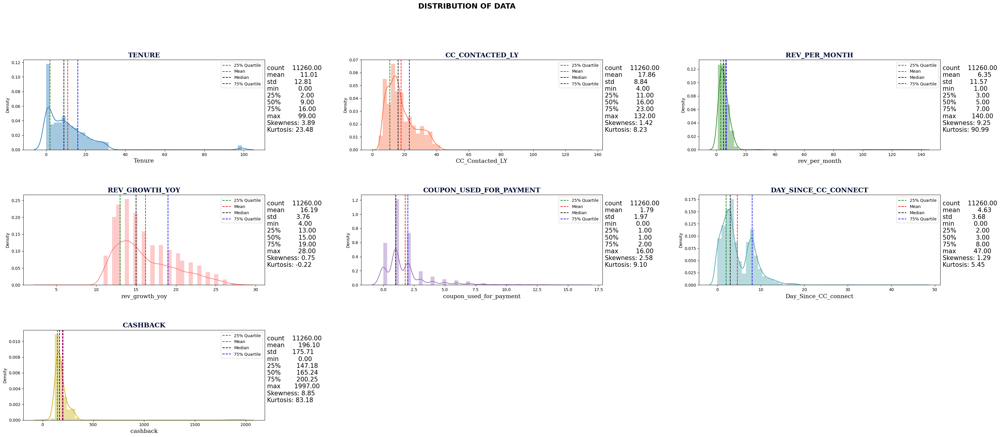

In [ ]:
num_columns = df_temp.select_dtypes(include=['float64', 'int64']).columns.drop('Churn')

# Distribution of Numeric Columns
plt.rcParams['axes.facecolor'] = 'white'
fig = plt.figure(figsize=[40, 32])
fig.suptitle('DISTRIBUTION OF DATA', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92)
fig.subplots_adjust(hspace=0.5, wspace=0.4)
for i, col in enumerate(num_columns):
    ax = fig.add_subplot(6, 3, i + 1)
    # Plot the histogram
    sns.distplot(df_temp[col], color=colours[i], ax=ax)
    ax.axvline(df_temp[col].quantile(q=0.25), color='green', linestyle='--', label='25% Quartile')
    ax.axvline(df_temp[col].mean(), color='red', linestyle='--', label='Mean')
    ax.axvline(df_temp[col].median(), color='black', linestyle='--', label='Median')
    ax.axvline(df_temp[col].quantile(q=0.75), color='blue', linestyle='--', label='75% Quartile')
    skewness = round(df_temp[col].skew(), 2)
    kurtosis = round(df_temp[col].kurtosis(), 2)
    description_lines = [line for line in str(df_temp[col].describe().round(2)).split('\n') if 'Name' not in line and 'dtype' not in line]
    description_text = '\n'.join(description_lines)
    description_text += f"\nSkewness: {skewness:.2f}\nKurtosis: {kurtosis:.2f}"
    ax.annotate(description_text, xy=(1.01, 0.2), xycoords='axes fraction', fontsize=15)
    ax.set_xlabel(f'{col}', fontdict=axlab_dict)
    ax.set_title(f'{col.upper()}', fontdict=axtitle_dict)
    ax.legend(fontsize=10)
plt.show()

**Key Pointers from Univeariate Analysis**

---
---
1. **Tenure**:
   - The tenure values have a wide range from 0 to 99 months, indicating variability in customer loyalty.
   - The distribution is positively skewed (skewness 3.90), suggesting that more customers have shorter tenure.
   - There are significant outliers on the higher end (kurtosis 23.37), which might represent long-term loyal customers or data anomalies.

2. **CC_Contacted_LY**:
   - The number of CC contacts in the last year ranges from 4 to 132, indicating variation in customer interactions.
   - The distribution is moderately positively skewed (skewness 1.42), suggesting that most customers had relatively fewer contacts.
   - There are some outliers with a higher number of contacts (kurtosis 8.23), indicating potential high engagement customers or data anomalies.

3. **rev_per_month**:
   - Monthly revenue varies significantly, with values ranging from 1 to 140.
   - The distribution is highly positively skewed (skewness 9.09), indicating that most customers generate lower revenue.
   - There are many extreme outliers (kurtosis 86.96), potentially representing high-revenue customers or data anomalies.

4. **rev_growth_yoy**:
   - Year-over-year revenue growth percentages range from 4% to 28%.
   - The distribution is moderately positively skewed (skewness 0.75), suggesting steady growth rates.
   - The kurtosis value is close to zero (kurtosis -0.22), indicating a distribution with lighter tails and fewer outliers.

5. **coupon_used_for_payment**:
   - Most customers use 1 to 2 coupons for payments, with a range of 0 to 16.
   - The distribution is positively skewed (skewness 2.58), indicating that a significant portion of customers uses coupons for payment.
   - The kurtosis value is relatively high (kurtosis 9.10), suggesting a distribution with some outliers related to coupon usage.

6. **Day_Since_CC_connect**:
   - The number of days since the last customer care connect spans from 0 to 47 days.
   - The distribution is positively skewed (skewness 1.27), indicating that most customers recently connected contact center.
   - The kurtosis value is 5.33, suggesting a distribution with some customers having longer periods since the last connect.

7. **cashback**:
   - Cashback values vary widely from 0 to 1997.
   - The distribution is highly positively skewed (skewness 8.77), indicating that most customers receive lower cashback amounts.
   - There are numerous extreme outliers (kurtosis 81.11), which could represent customers with exceptionally high cashback or anomalies in the data.

#### Distribution of Categorical variables
---
---

In [ ]:
cat_colums = df_temp.select_dtypes(include = ['object'])

In [ ]:
def univariateAnalysis_category(cols):
    print('__' * 41)
    colors = ['#79a5db', '#e0a580', '#6fab90', '#896ca8', '#ADD8E6']
    value_counts = df_temp[cols].value_counts()
    # Bar plot
    fig = px.bar(
        value_counts, x=value_counts.index,
        y=cols, title=f'Distribution of {cols}', labels={cols: "Count"},color_discrete_sequence=[colors])
    fig.update_traces(text=value_counts.values, textposition='outside')
    fig.update_layout(width=700)
    fig.update_xaxes(title_text=cols)
    fig.update_layout( plot_bgcolor='#fcfaf7',paper_bgcolor='#fcfaf7')
    fig.show()
    # Donut chart
    percentage = (value_counts / value_counts.sum()) * 100
    fig = px.pie(
        values=percentage, names=value_counts.index,
        labels={'names': 'Categories', 'values': 'Percentage'}, hole=0.5,color_discrete_sequence=colors)
    fig.add_annotation( x=0.5, y=0.5, align="center", xref="paper",
    yref="paper", showarrow=False, font_size=18, text=f'{cols}')
    fig.update_layout(legend=dict(x=0.9, y=0.5))
    fig.update_layout(width=700)
    fig.update_layout( plot_bgcolor='#fcfaf7',paper_bgcolor='#fcfaf7')
    fig.show()
for x in cat_colums:
    univariateAnalysis_category(x)

__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


**Key inferences:**

---
---

- Approximately 65.50% of customers are in City Tier 1 while around 30.24% of customers are in City Tier 3.
- The data suggests that most customers prefer "Debit Card"(41.71%) and "Credit Card"(31.18%) as payment method
- 60.50% of customers are male(Majority)
-  A significant portion of customers have "Service_Score" of 3.0 (49.63%)suggesting relatively neutral score.
- "Regular Plus" and "Super" are the most common account segments, making up 37.49% and 36.07% of the customer base, respectively.
- 38.35% customers having score 4 & 5 suggesting a ratio of Satisfied users while 30.78% havings core 1& 2 suggesting a high dissatisfaction.
- Account_user_count: Most customers have 3 to 4 account users, with a range of 1 to 6 users.
- Most customers (72.37%) did not file any complaints in the last year which indicates a good sign of less customers facing issues.
- A large portion of customers use mobile devices(73.20%) for login.


##### Bivariate Analysis

In [ ]:
color_map = {'Not Churn': '#79a5db', 'Churn': '#e0a580'}
print('Bivariate Analysis : Distribution of Columns with Churn ')

for column in cat_colums:
    print('__' * 41)

    # Prepare the data for the bar chart
    bar_data = df_temp.groupby([column, 'Churn']).size().reset_index(name='count')
    bar_data['Churn'] = bar_data['Churn'].map({0: 'Not Churn', 1: 'Churn'})

    # Create the bar chart
    fig_bar = px.bar(bar_data, x=column, y='count', color='Churn', title=f'Distribution of {column} on customer churn ',
                     color_discrete_map=color_map, text='count', labels={'count': 'Count'})
    fig_bar.update_layout(width=700)
    fig_bar.update_layout(plot_bgcolor='#fcfaf7', paper_bgcolor='#fcfaf7')
    fig_bar.update_traces(textposition='outside')
    fig_bar.show()
    # Sunburst chart
    sunburst_data = df_temp.groupby([column, 'Churn']).size().reset_index(name='count')
    sunburst_data['Churn'] = sunburst_data['Churn'].map({0: 'Not Churn', 1: 'Churn'})
    fig_sunburst = px.sunburst(sunburst_data, path=[column, 'Churn'], values='count', color='Churn',
                              color_discrete_map=color_map)
    fig_sunburst.update_layout(width=700)
    fig_sunburst.update_layout(plot_bgcolor='#fcfaf7', paper_bgcolor='#fcfaf7')
    fig_sunburst.update_traces(textinfo='label + percent parent')
    fig_sunburst.show()


Bivariate Analysis : Distribution of Columns with Churn 
__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


**Key Inferences**

---
---

- Payment method, City_Tier, and account segment seem to be strong indicators of customer churn.
- Customers who use 'Cash on Delivery' and belong to City_Tier 1.0 have the highest churn rates.
- 'Regular Plus' account segment and 'CC_Agent_Score' of 5.0 are associated with higher churn.
- Gender, marital status, and login device appear to have a relatively lower impact on customer churn, but there are still variations.
- It's essential to focus on improving the customer experience for the high-churn-rate segments and tailor retention strategies accordingly.

**Let's check in Each Variable**

**City_Tier:**
- City_Tier 1.0 has the highest percentage of churn (14.55%) followed by City_Tier 3.0 (21.35%).
- City_Tier 2.0 has the lowest churn at 20.00%.

**Payment:**
- Customers who use 'Cash on Delivery' as their payment method have the highest churn rate (25.05%).
- 'Credit Card' and 'Debit Card' users have lower churn rates compared to 'Cash on Delivery' users.
- 'E wallet' and 'UPI' users have relatively lower churn rates.

**Gender:**
- Churn is slightly higher among 'Male' customers (17.72%) compared to 'Female' customers (15.49%).

**Account Segment:**
- 'Regular Plus' account segment has the highest churn rate (27.13%).
- 'Regular' and 'Super' segments have the lowest churn rates.
- 'Super Plus' and 'HNI' segments also have relatively low churn rates.

**CC_Agent_Score:**
- Customers with 'CC_Agent_Score' of 5.0 have the highest churn rate (23.82%).
- 'CC_Agent_Score' of 1.0 and 2.0 have the lowest churn rates (11.47% and 12.63% respectively).
- As 'CC_Agent_Score' decreases, the churn rate increases.

**Marital Status:**
- Customers with 'Single' marital status have the highest churn rate (26.90%).
- 'Married' customers have a lower churn rate (11.61%).
- 'Divorced' customers have a moderate churn rate (14.63%).

**Complain_ly:**
- Customers who have complained in the last year ('Complain_ly' = 1.0) have a significantly higher churn rate (31.76%).
- Customers who did not complain ('Complain_ly' = 0.0) have a lower churn rate (11.14%).

**Login Device:**
- Customers who use 'Computer' as their login device have a higher churn rate (19.78%).
- Customers who use 'Mobile' devices have a relatively lower churn rate (15.76%).


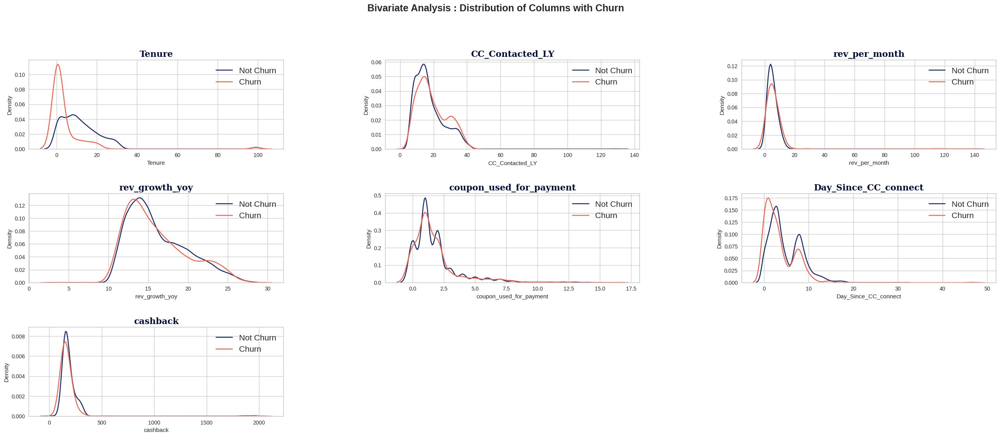

In [ ]:
fig = plt.figure(figsize=[32, 24])
fig.suptitle('Bivariate Analysis : Distribution of Columns with Churn ', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92)
fig.subplots_adjust(hspace=0.5, wspace=0.4)
for i, col in enumerate(num_columns):
    a = fig.add_subplot(6, 3, i+1)
    sns.distplot(df_temp[df_temp['Churn'] == 0][col], color='#142863', ax=a, hist=False, label='Not Churn')
    sns.distplot(df_temp[df_temp['Churn'] == 1][col], color='#f2634e', ax=a, hist=False, label='Churn')
    a.set_title(col, fontdict=axtitle_dict)
    a.legend(fontsize=15)

In [ ]:
def plot_hist(df_temp, feature):
    print('__' * 60)
    color_map = {0: '#79a5db', 1: '#f2634e'}
    fig = px.histogram(df_temp, x=feature, color="Churn", marginal="box",
                       barmode ="overlay", color_discrete_map=color_map, histnorm ='density')
    fig.update_layout(title_font_color="black", legend_title_font_color="black",
        title={ 'text': feature+" histogram",'x':0.5,
            'xanchor': 'center','yanchor': 'top'},
        paper_bgcolor="#fcfaf7",
        plot_bgcolor='#fcfaf7',
        font_color="black")
    fig.update_layout(width=1000)
    fig.show()
for col in num_columns:
  plot_hist(df, col)

________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


**Key Inferences**

---
---

- Tenure and customer contact with customer care (CC_Contacted_LY) have a significant impact on churn. Customers with longer tenure and more contact with customer care are less likely to churn.
- Account user count, monthly revenue, and year-over-year revenue growth also influence churn. Fewer account users, lower monthly revenue, and lower revenue growth are associated with higher churn.
- The use of coupons for payment and the time since the last contact with customer care are additional factors affecting churn.
- Cashback also plays a role, with higher cashback amounts associated with lower churn.


**Let's check for each variable**

**Tenure:**
- Customers with lower tenure (recent customers) have a higher churn rate.
- Customers with longer tenure (loyal customers) have a lower churn rate.

**CC_Contacted_LY:**
- Customers with lower CC_Contacted_LY (less contact with customer care last year) have a higher churn rate.
- Customers with higher CC_Contacted_LY (more contact with customer care last year) have a lower churn rate.

**Account_user_count:**
- Customers with fewer account users tend to have a higher churn rate.
- Customers with more account users have a lower churn rate.

**rev_per_month:**
- Customers with lower monthly revenue tend to have a higher churn rate.
- Customers with higher monthly revenue have a lower churn rate.

**rev_growth_yoy:**
- Customers with lower year-over-year revenue growth tend to have a higher churn rate.
- Customers with higher year-over-year revenue growth have a lower churn rate.

**coupon_used_for_payment:**
- Customers who use fewer coupons for payment tend to have a higher churn rate.
- Customers who use more coupons for payment have a lower churn rate.

**Day_Since_CC_connect:**
- Customers with a shorter time since the last contact with customer care tend to have a higher churn rate.
- Customers with a longer time since the last contact with customer care have a lower churn rate.

**cashback:**
- Customers with lower cashback amounts tend to have a higher churn rate.
- Customers with higher cashback amounts have a lower churn rate.


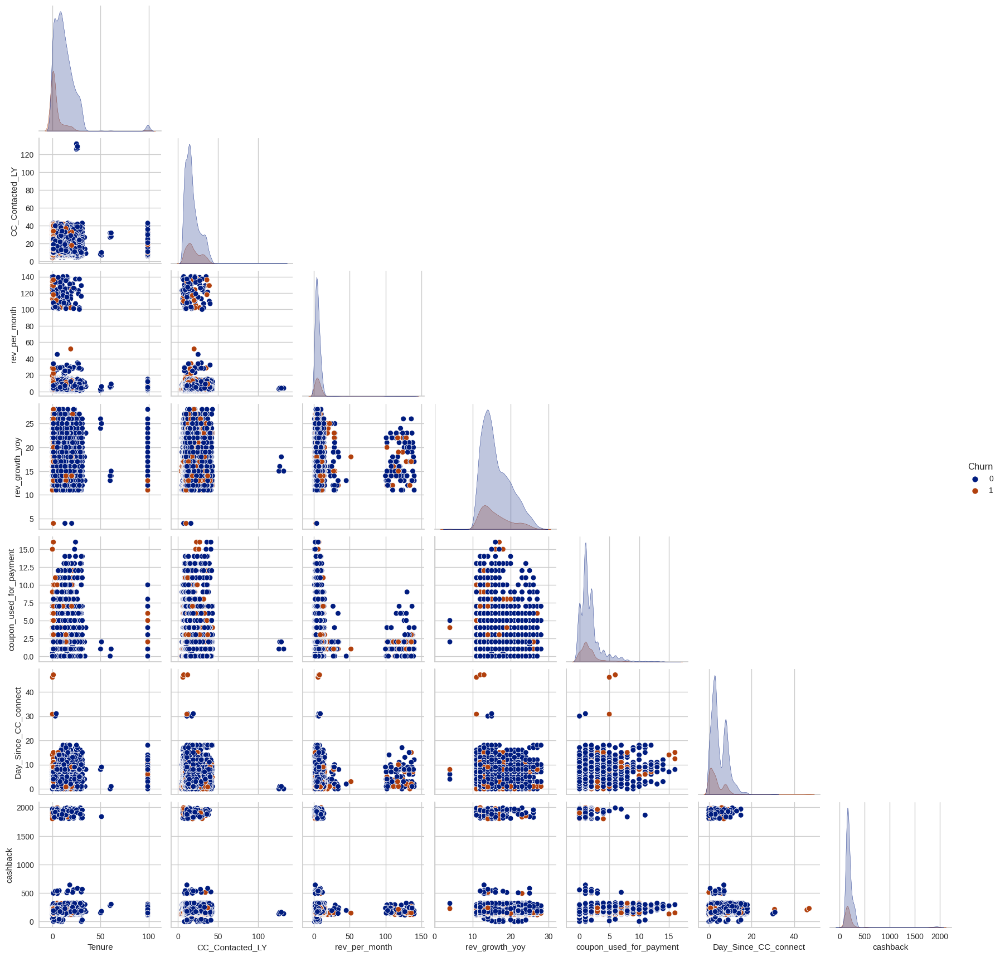

In [ ]:
#Pairplot
sns.pairplot(df_temp, corner=True, hue= 'Churn', palette='dark')
plt.show()

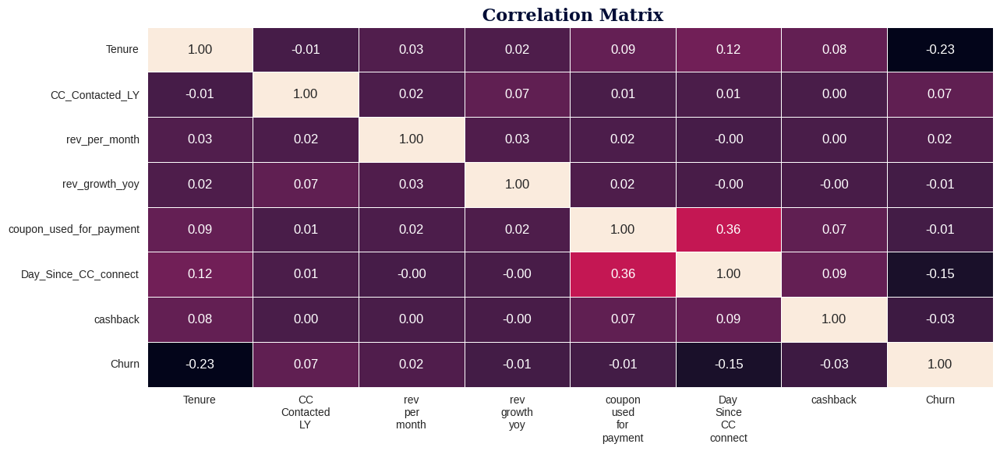

In [ ]:
#Correlation heatmap
corr = df_temp.corr(method='pearson')
fig = plt.subplots(figsize=(14, 6))
ax = sns.heatmap(corr, annot=True, fmt='.2f', cbar=None, linewidth=0.5)
ax.set_xticklabels([label.get_text().replace('_', '\n') for label in ax.get_xticklabels()], rotation=0, horizontalalignment='center')
ax.set_title(' Correlation Matrix', fontdict=axtitle_dict)
plt.show()

**Multicollinearity**

---
---

- Tenure, the time since the last contact with customer care (Day_Since_CC_connect), and cashback appear to have the most significant impact on churn. Customers with longer tenure, recent contact with customer care, and higher cashback are less likely to churn.
- Other variables, such as CC_Contacted_LY, Account_user_count, and usage of coupons for payment, have weaker correlations with churn and may have a less pronounced impact.
- Monthly revenue and year-over-year revenue growth do not have strong correlations with churn, indicating that these factors may not be the primary drivers of customer churn.


1. **Positive Relationships:**
   - Customers with longer tenure tend to generate higher monthly revenue and have been using their credit cards for a longer period.
   - There is a strong positive relationship between monthly revenue and cashback, indicating that customers who generate more revenue receive higher cashback.
   - In higher city tiers, customers are more likely to use E-wallets for payments.

2. **Negative Relationships:**
   - Longer-tenured customers are less likely to belong to the "Regular Plus" account segment and are slightly less likely to be married.
   - Customers in higher city tiers are less likely to be in the "Regular Plus" account segment.
   - Customers receiving higher cashback are less likely to be in the "Regular Plus" account segment.

3. **Low Relationships:**
   - Gender does not strongly correlate with most variables, suggesting that it may not significantly impact other customer behaviors.
   - Contacting customer care in the last year does not show strong correlations with other variables, indicating that this activity might not strongly influence other aspects of customer behavior.


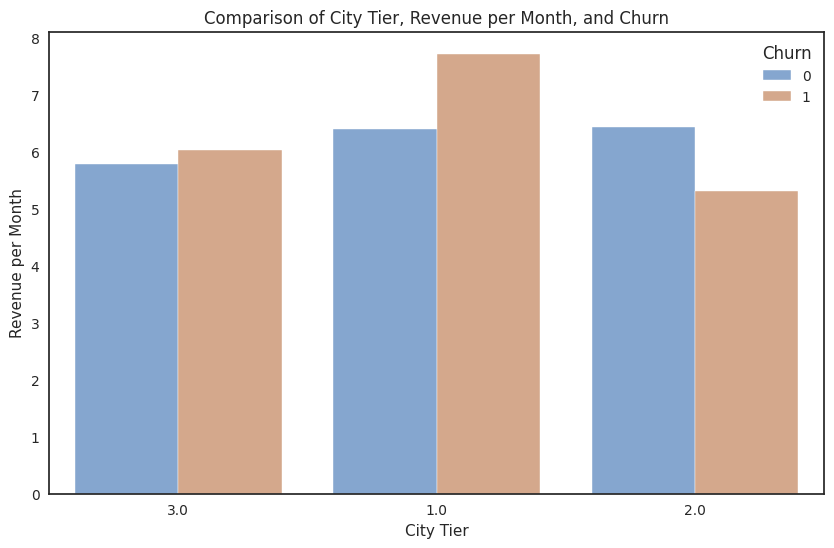

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
sns.barplot(data=df_temp, x="City_Tier", y="rev_per_month", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("City Tier")
plt.ylabel("Revenue per Month")
plt.title("Comparison of City Tier, Revenue per Month, and Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

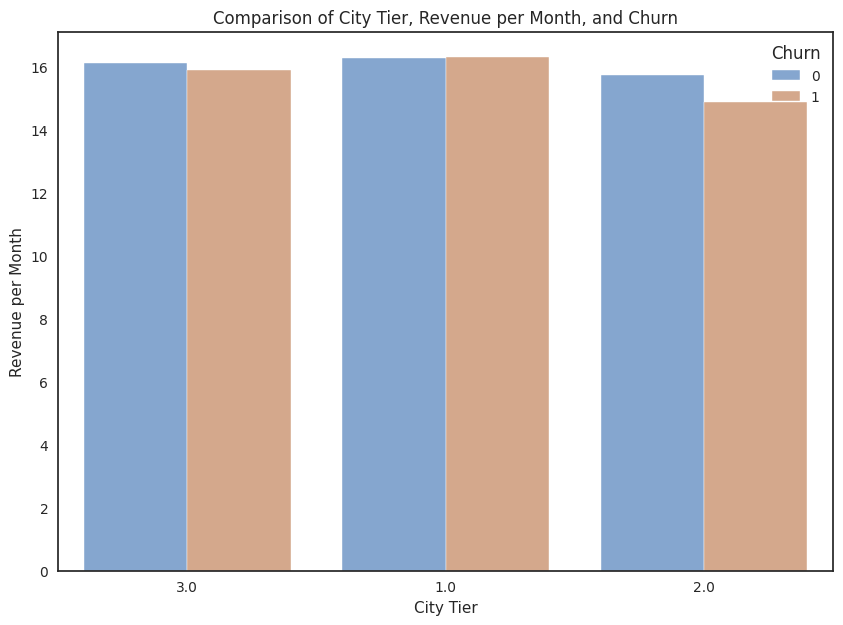

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x="City_Tier", y="rev_growth_yoy", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("City Tier")
plt.ylabel("Revenue per Month")
plt.title("Comparison of City Tier, Revenue per Month, and Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

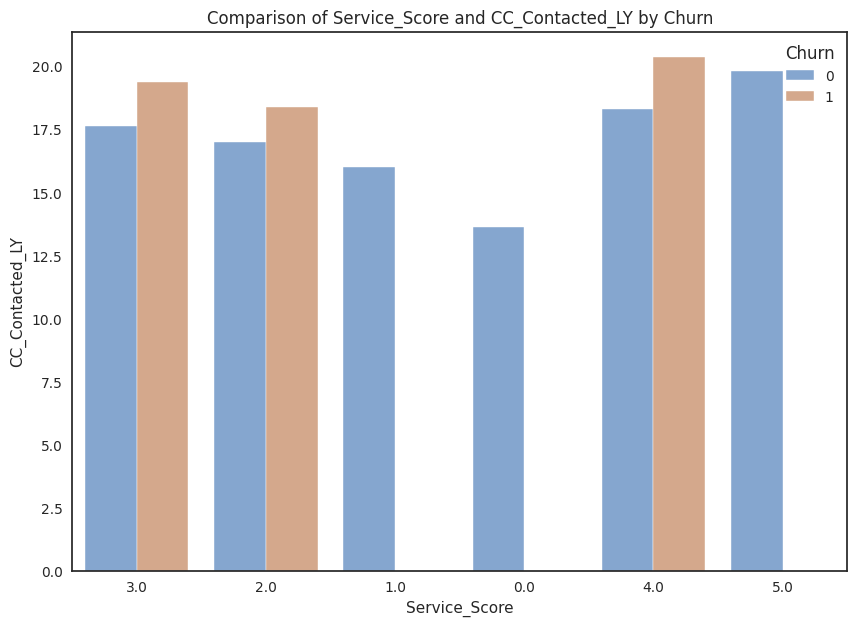

In [ ]:

x = "Service_Score"
y = "CC_Contacted_LY"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

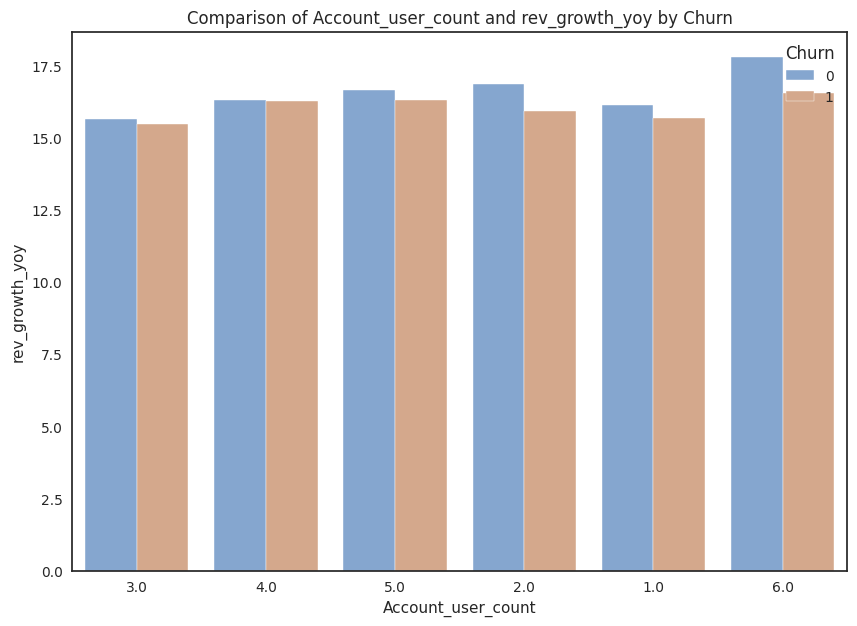

In [ ]:

x = "Account_user_count"
y = "rev_growth_yoy"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

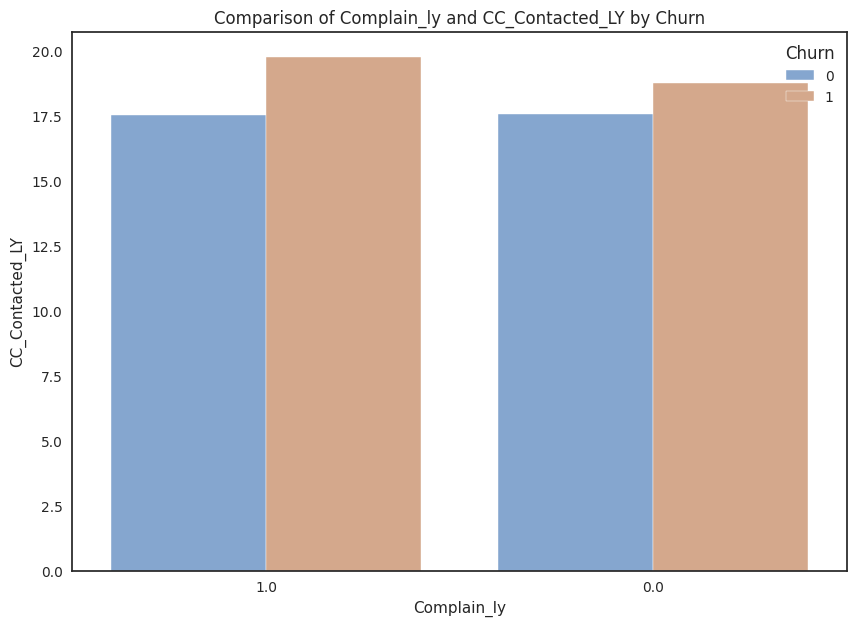

In [ ]:

x = "Complain_ly"
y = "CC_Contacted_LY"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

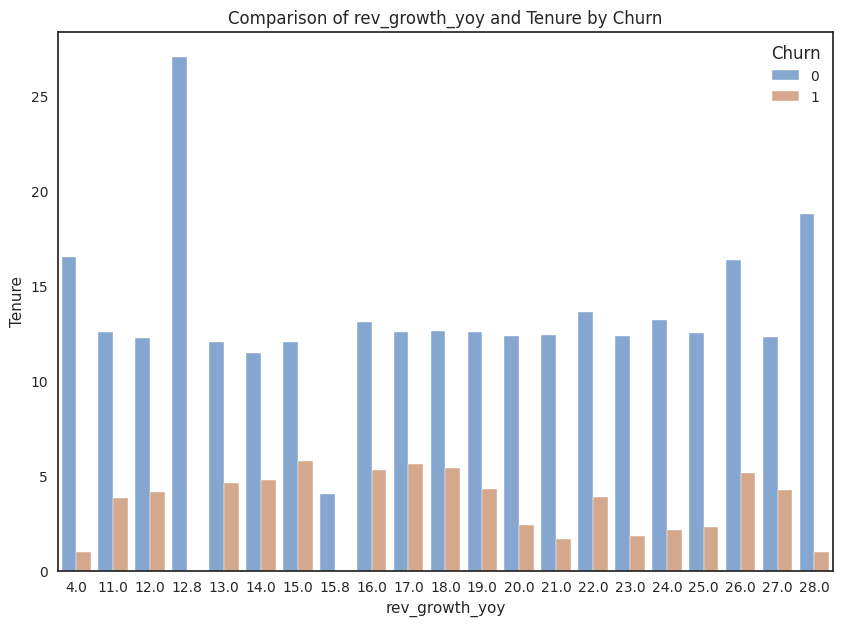

In [ ]:

x = "rev_growth_yoy"
y = "Tenure"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

#### Outliers

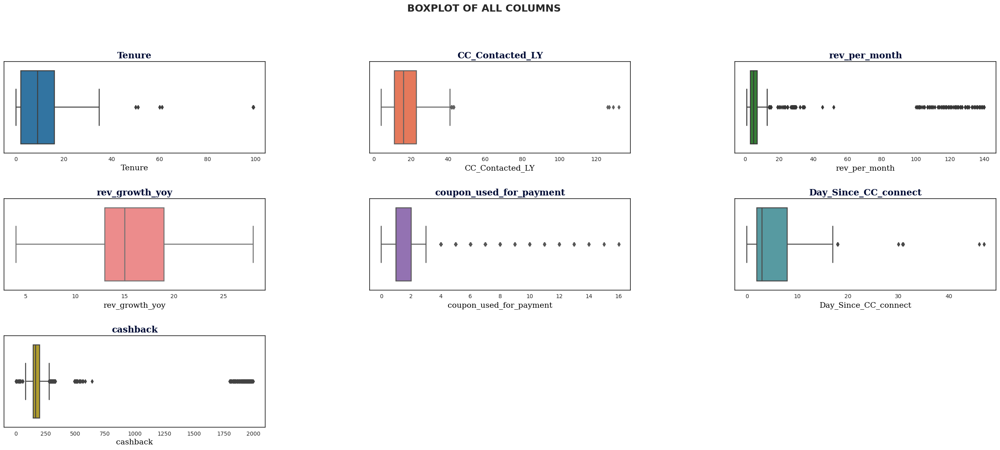

In [ ]:
#Outliers in each Columns
plt.rcParams['axes.facecolor'] = 'white'
fig = plt.figure(figsize=[32,24])
fig.suptitle('BOXPLOT OF ALL COLUMNS', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(num_columns):
    ax1 = fig.add_subplot(6,3, i+1);
    ax1 = sns.boxplot(data = df_temp, x=col ,  color= colours[i]);
    ax1.set_title(f'{col}', fontdict=axtitle_dict)
    ax1.set_xlabel(f'{col}', fontdict=axlab_dict)

In [ ]:
#Checking numbers of observations beyond Upper & Lower Limit
Q1 = df_temp.quantile(0.01)
Q99 = df_temp.quantile(0.99)
UL = Q99
LL = Q1
outliers = ((df_temp > UL) | (df < LL)).sum()
print("Number of Observations Beyond Upper & Lower Limit for Each Column:")
display(outliers)

Number of Observations Beyond Upper & Lower Limit for Each Column:


AccountID                    0.0
Account_user_count           0.0
CC_Agent_Score               0.0
CC_Contacted_LY             80.0
Churn                        0.0
City_Tier                    0.0
Complain_ly                  0.0
Day_Since_CC_connect        94.0
Gender                       0.0
Login_device                 0.0
Marital_Status               0.0
Payment                      0.0
Service_Score                0.0
Tenure                       0.0
account_segment              0.0
cashback                   225.0
coupon_used_for_payment     98.0
rev_growth_yoy              52.0
rev_per_month              113.0
dtype: float64

We see the outliers are present in columns:


```
CC_Contacted_LY             80
rev_per_month              113
rev_growth_yoy              52
coupon_used_for_payment     98
Day_Since_CC_connect        94
cashback                   226
```

We will cap the outliers to 1st & 99th %tile.
Since our data in df1 was already scaled & treated, we will do the outlier treatment on scaled data.
The result of Outlier treatment on Original as well as on Scaled data is same, hence we are considering scaled data for ease of further analysis in model building

In [ ]:
# For refrence, outliers in scaled columns are same as Original.
# Validation here
Q1 = df1[num_columns].quantile(0.01)
Q99 = df1[num_columns].quantile(0.99)
UL = Q99
LL = Q1
outlier = ((df1[num_columns] > UL) | (df1[num_columns] < LL)).sum()
print("Number of Observations Beyond Upper & Lower Limit for Each Column:")
display(outlier)

Number of Observations Beyond Upper & Lower Limit for Each Column:


Tenure                       0
CC_Contacted_LY              0
rev_per_month              113
rev_growth_yoy               0
coupon_used_for_payment      0
Day_Since_CC_connect         0
cashback                   226
dtype: int64

In [ ]:
#Function which returns the Upper and Lower limit to detect outliers for each feature
def treat_outlier(col):
    q1  , q99 = np.percentile(col, [1, 99])
    return q1, q99

for i in num_columns:
    LR, UR  = treat_outlier(df1[i])
    df1[i] = np.where(df1[i] > UR, UR, df1[i])
    df1[i] = np.where(df1[i] < LR, LR, df1[i])


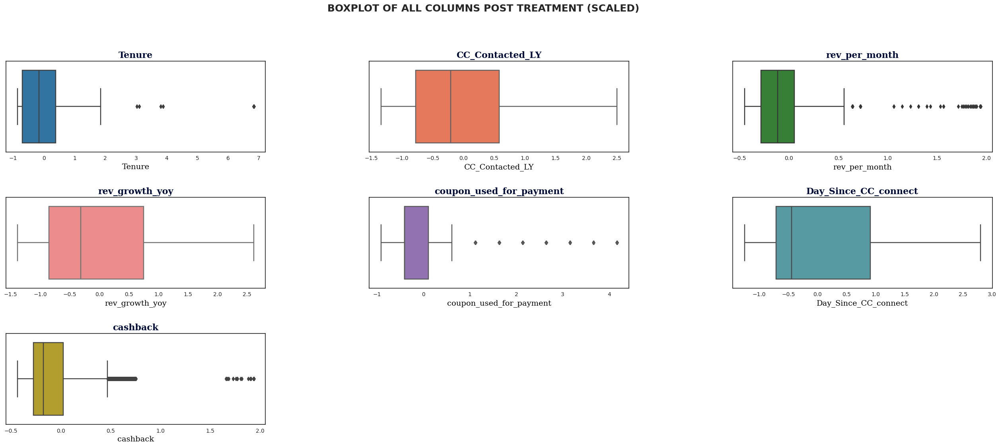

In [ ]:
#Outliers in each Columns
plt.rcParams['axes.facecolor'] = 'white'
fig = plt.figure(figsize=[32,24])
fig.suptitle('BOXPLOT OF ALL COLUMNS POST TREATMENT (SCALED)', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(num_columns):
    ax1 = fig.add_subplot(6,3, i+1);
    ax1 = sns.boxplot(data = df1, x=col ,  color= colours[i]);
    ax1.set_title(f'{col}', fontdict=axtitle_dict)
    ax1.set_xlabel(f'{col}', fontdict=axlab_dict)

In [ ]:
df1.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,1.0


#### **Clustering**

- Now we have done basic pre-processing, we will be performing clustering via KMeans clustering.

**Steps involved in the Clustering**

- We will drop the Target column to see what clusters are formed & the insights we get from it
- Elbow Method to determine the number of clusters to be formed
- Clustering via Kmeans Clustering
- Examining the clusters formed via scatter plot


In [ ]:
clust_df= df1.drop('Churn', axis=1)
clust_df.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0


##### Method 1- **DIMENSIONALITY REDUCTION**
Dimensionality reduction is the process of reducing the number of random variables under consideration, by obtaining a set of principal variables.

Principal component analysis (PCA) is a technique for reducing the dimensionality of such datasets, increasing interpretability but at the same time minimizing information loss.

Steps in this section:

Dimensionality reduction with PCA
Plotting the reduced dataframe
Dimensionality reduction with PCA

For this project, I will be reducing the dimensions to 3.



In [ ]:
from matplotlib import colors
from matplotlib.colors import ListedColormap

sns.set(rc={"axes.facecolor":"#FFF9ED","figure.facecolor":"#fcfaf7"})
pallet = ["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"]
cmap = colors.ListedColormap(["#682F2F", "#9E726F", "#D6B2B1", "#B9C0C9", "#9F8A78", "#F3AB60"])

In [ ]:
#Initiating PCA to reduce dimentions aka features to 3
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
pca.fit(clust_df)
PCA_ds = pd.DataFrame(pca.transform(clust_df), columns=(["col1","col2", "col3"]))
PCA_ds.describe().T

,count,mean,std,min,25%,50%,75%,max
col1,11260.0,-7.824805e-17,1.376688,-2.414921,-0.981447,0.045882,1.090166,2.421368
col2,11260.0,6.057913e-17,1.202237,-2.833853,-0.870708,-0.119300,0.671353,6.304202
col3,11260.0,-2.322200e-16,1.132984,-3.127315,-0.799235,-0.037459,0.800209,4.343771


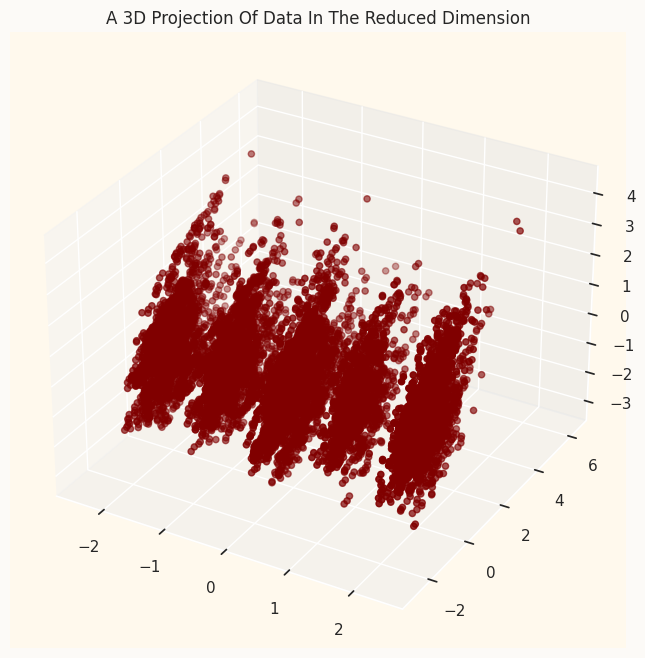

In [ ]:
#A 3D Projection Of Data In The Reduced Dimension
x =PCA_ds["col1"]
y =PCA_ds["col2"]
z =PCA_ds["col3"]
#To plot
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(x,y,z, c="maroon", marker="o" )
ax.set_title("A 3D Projection Of Data In The Reduced Dimension")
plt.show()


Elbow Method to determine the number of clusters to be formed:


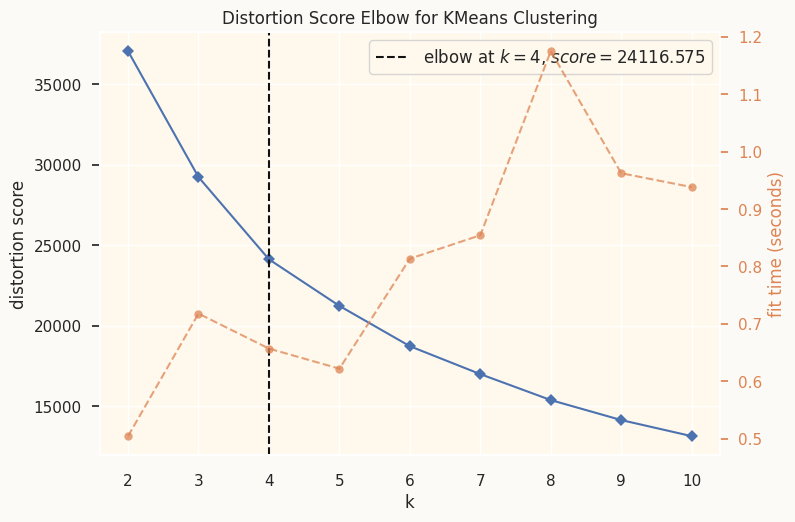

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(KMeans(), k=10)
Elbow_M.fit(PCA_ds)
Elbow_M.show()

 - Let's check for k=4

In [ ]:
# K =4
k_means = KMeans(n_clusters = 4, random_state = 42)
k_means.fit(PCA_ds)
clust_df['Clusters_4'] = k_means.labels_


In [ ]:
PCA_ds['Clusters_4'] = k_means.labels_

In [ ]:
clust_df.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Clusters_4
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,0


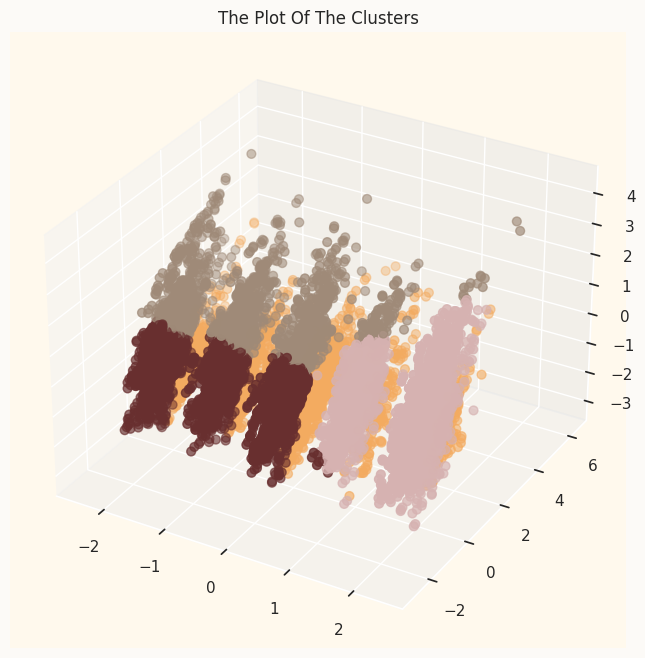

In [ ]:
#Plotting the clusters
fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=PCA_ds["Clusters_4"], marker='o', cmap = cmap )
ax.set_title("The Plot Of The Clusters")
plt.show()


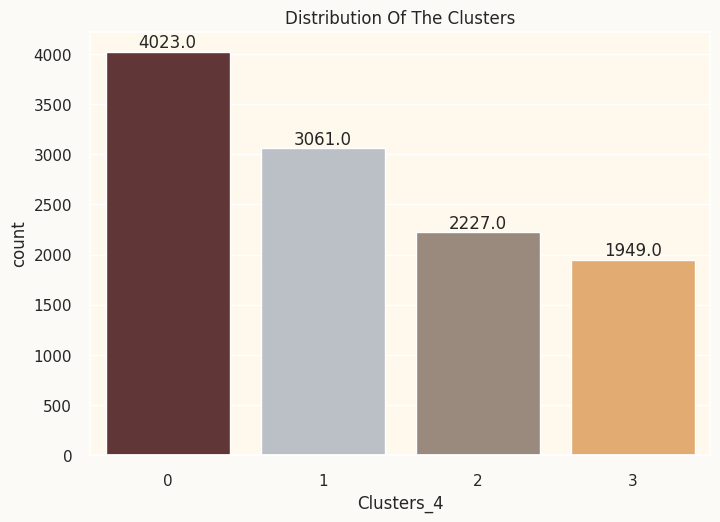

In [ ]:
#Plotting countplot of clusters
pal = ["#682F2F","#B9C0C9", "#9F8A78","#F3AB60"]
pl = sns.countplot(x=clust_df["Clusters_4"], palette= pal)
pl.set_title("Distribution Of The Clusters")
for p in pl.patches:
    pl.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='bottom')
plt.show()


##### **Method 2:- without doing PCA on scaled data**
The above plot indicates that 4 will be an optimal number of clusters for this data, however, sicne we only considered 3 PCA components, which might have captured much variance.

We can also plot wss and see the ideal number of clusters using silhouette score. Also, we will not use the PCA data, instead use the original scaled data - clust_df , without churn

In [ ]:
clust_df= df1.drop('Churn', axis=1)

Elbow Method to determine the number of clusters to be formed:


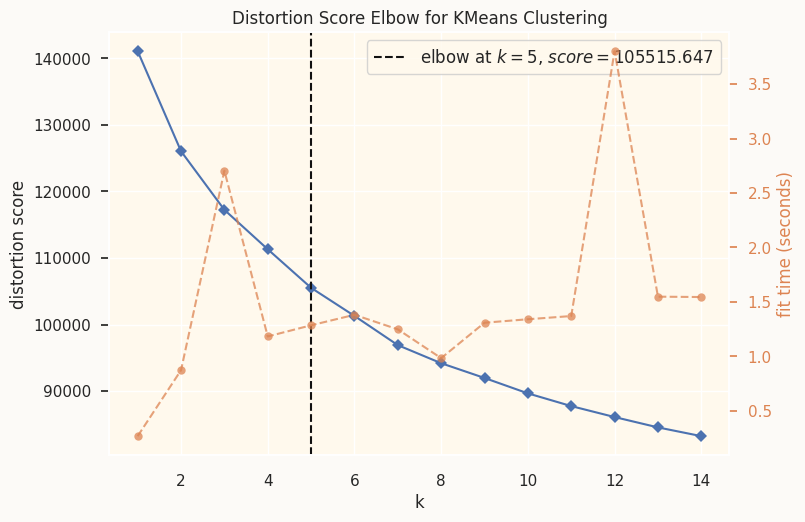

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
k = range(1, 15)
km = KMeans(max_iter=1000, random_state=42)
Elbow_M = KElbowVisualizer(km, k=k)
Elbow_M.fit(clust_df)
Elbow_M.show()

The Elobow method shows ideal clusters as 6. Let's check the value of k among these using silhouette score. We'll check on 2 to  8

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples

for i in range(2, 9):
  k_means = KMeans(n_clusters = i, random_state = 42)
  k_means.fit(clust_df)
  labels = k_means.labels_
  print('k =', i)
  print('Silhouette Score =', silhouette_score(clust_df, labels))
  print('Minimum Sil Width =', silhouette_samples(clust_df, labels).min(), '\n')

k = 2
Silhouette Score = 0.11751856507352751
Minimum Sil Width = 0.005477006977261093 

k = 3
Silhouette Score = 0.11515166633363734
Minimum Sil Width = -0.051164575892963804 

k = 4
Silhouette Score = 0.0956215333954927
Minimum Sil Width = -0.08547512254387817 

k = 5
Silhouette Score = 0.10321484062643388
Minimum Sil Width = -0.0747943751579846 

k = 6
Silhouette Score = 0.09039610127839054
Minimum Sil Width = -0.08978432517595535 

k = 7
Silhouette Score = 0.08970130060994297
Minimum Sil Width = -0.11895926433216886 

k = 8
Silhouette Score = 0.0884297249347357
Minimum Sil Width = -0.1220145694631032 



```
- Silhouette Score close to 1 => Clusters are well seperated from each other.

- Minimum Sil-Width = +ve => No Data points are mapped incorrectly to their cluster
```
- In this case, the other clusters don't well differentiate because 2 groups out of a set of data points are obvious.
- For k = 2, we have the highest Silhouette Score (0.134) among the options. The Minimum Silhouette Width is also positive (0.012), indicating that there is a reasonable separation between the clusters.

- Taking 6 Clusters basis previous elbow method shows that increasing k post 6  found the point where adding more clusters provides diminishing returns in terms of reducing the inertia. However, having 6 cluster might become difficult in interpretability and practical implications of the resulting clusters.

We wil go ahead with k=2 for easier interpretation

In [ ]:
# K =2
k_means = KMeans(n_clusters = 2, random_state = 42)
k_means.fit(clust_df)
clust_df['Clusters_2'] = k_means.labels_

In [ ]:
aggdata = clust_df.groupby('Clusters_2').mean()
aggdata['freq'] = clust_df['Clusters_2'].value_counts().sort_index()
display( round(aggdata,2))

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,freq
Clusters_2,,,,,,,,,,,,,,,,,,
0,0.02,0.68,-0.02,1.81,0.63,2.88,2.73,2.20,0.34,1.18,-0.09,0.30,0.06,-0.03,-0.02,-0.07,0.73,3466
1,-0.01,0.63,0.00,1.74,0.59,2.91,2.69,2.16,2.84,1.16,-0.06,0.26,-0.03,-0.00,-0.01,-0.07,0.73,7794


In [ ]:
aggdata[num_columns] = pd.DataFrame(scaler.inverse_transform(aggdata[num_columns]), columns = aggdata[num_columns].columns)
display( round(aggdata,2).T)

Clusters_2,0,1
Tenure,11.23,10.91
City_Tier,0.68,0.63
CC_Contacted_LY,17.68,17.88
Payment,1.81,1.74
Gender,0.63,0.59
Service_Score,2.88,2.91
Account_user_count,2.73,2.69
account_segment,2.20,2.16
CC_Agent_Score,0.34,2.84
Marital_Status,1.18,1.16


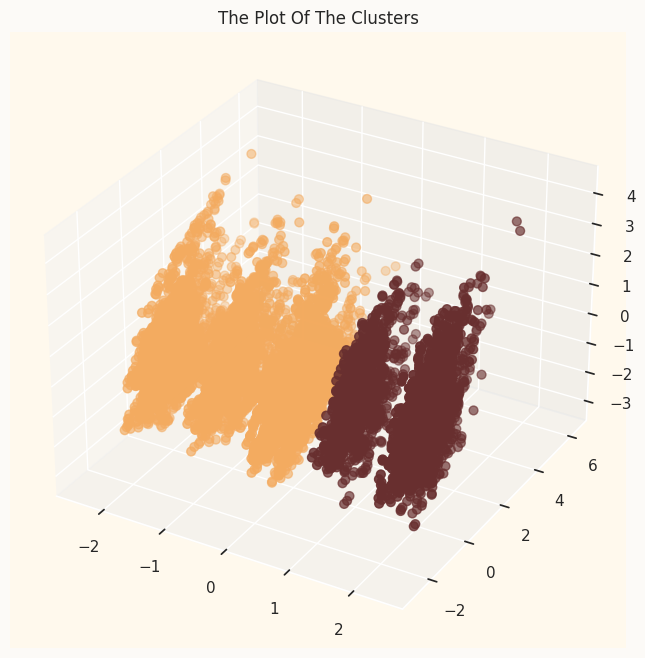

In [ ]:
#Plotting the clusters

fig = plt.figure(figsize=(10,8))
ax = plt.subplot(111, projection='3d', label="bla")
ax.scatter(x, y, z, s=40, c=clust_df["Clusters_2"], marker='o', cmap = cmap )
ax.set_title("The Plot Of The Clusters")
plt.show()


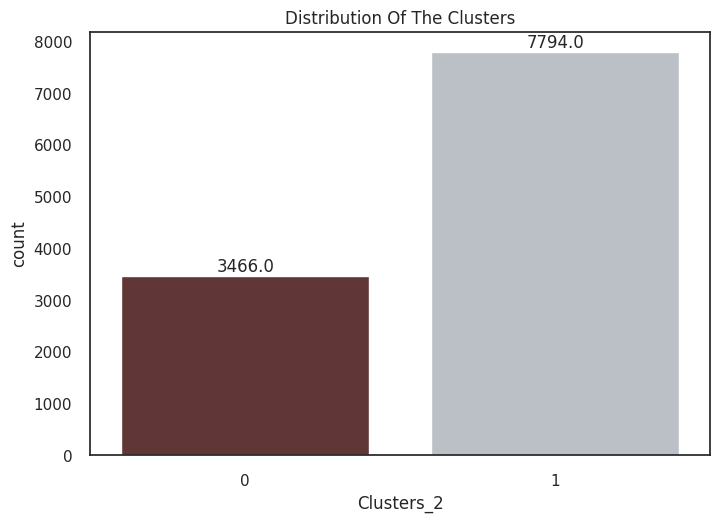

In [ ]:
#Plotting countplot of clusters
sns.set_style("white")
pal = ["#682F2F","#B9C0C9", "#9F8A78","#F3AB60"]
pl = sns.countplot(x=clust_df["Clusters_2"], palette= pal)
pl.set_title("Distribution Of The Clusters")
for p in pl.patches:
    pl.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='bottom')
plt.show()


**Cluster 0:**
- Customers in Cluster 0 have a slightly longer tenure of approximately 11.23 months, indicating loyal relationships.
-  They exhibit moderate service satisfaction with a service score of 2.88 but generate significant monthly revenue of approximately 5.27 units.
- Cluster 0 has lower customer care agent scores (0.34) and a higher percentage of married customers (approximately 1.18), which suggests an area for improvement.
-  These customers file relatively fewer complaints, with a complaint rate of about 0.30, indicating overall satisfaction.

**Cluster 1:**
-  Customers in Cluster 1 have a slightly shorter tenure of approximately 10.91 months but higher customer care agent scores (2.84).
- They generate slightly higher monthly revenue (approximately 5.59 units) and have a lower number of complaints (around 0.26).
-  The majority of customers in this cluster are male (approximately 0.63) and unmarried (around 1.16).
-  Cluster 1 represents a larger customer base with significantly more frequent interactions (7794 times).

**Insights**

- **Tenure Variation:** The average tenure of customers in both clusters is quite close, with Cluster 0 having slightly higher tenure compared to Cluster 1.

- **Contact Frequency:** Cluster 1 has a slightly higher average contact frequency in the last year compared to Cluster 0, suggesting that Cluster 1 customers may have more interactions with the company.

- **Gender Balance:** Both clusters have a balanced distribution of gender, and there is no gender bias in either group.

- **Service Satisfaction:** Cluster 1 has a slightly higher average service score, indicating higher levels of satisfaction with the service offered by the company.

- **Account User Count:** Customers in Cluster 0 have a slightly higher average account user count compared to Cluster 1.

- **CC Agent Score:** Cluster 1 stands out with a significantly higher average agent score compared to Cluster 0, indicating more positive interactions with customer care agents.

- **Revenue per Month:** Cluster 1 exhibits a slightly higher average monthly revenue per customer compared to Cluster 0, indicating that Cluster 1 customers may be more profitable.

- **Interaction Frequency:** Cluster 1 has a significantly higher average interaction frequency compared to Cluster 0, suggesting that these customers are more engaged and active.



**Recommendations:**

Cluster 1 may represent the company's most loyal and engaged customers, while Cluster 0 could be targeted for improvements in services and addressing complaints.

- Focus on improving customer care agent interactions for Cluster 0 to raise agent scores.
- Address the concerns of married customers in Cluster 0 to improve their satisfaction.
- Enhance services and engagement strategies for male customers in Cluster 1, given their significant presence.
- Monitor and maintain the positive customer care experience in Cluster 1 to retain a larger customer base.

- Let's check Clusters with Original data & against Churn

In [ ]:
df_temp= pd.concat((df_temp, clust_df['Clusters_2']), axis=1)
df_temp.head()

,Tenure,CC_Contacted_LY,rev_per_month,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,City_Tier,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,Complain_ly,Login_device,Churn,Clusters_2
0,4.0,6.0,9.0,11.0,1.0,5.0,159.929993,3.0,Debit Card,Female,3.0,3.0,Super,2.0,Single,1.0,Mobile,1,0
1,0.0,8.0,7.0,15.0,0.0,0.0,120.900002,1.0,UPI,Male,3.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1,1
2,0.0,30.0,6.0,14.0,0.0,3.0,128.001999,1.0,Debit Card,Male,2.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1,1
3,0.0,15.0,8.0,23.0,0.0,3.0,134.070007,3.0,Debit Card,Male,2.0,4.0,Super,5.0,Single,0.0,Mobile,1,1
4,0.0,12.0,3.0,11.0,1.0,3.0,129.600006,1.0,Credit Card,Male,2.0,3.0,Regular Plus,5.0,Single,0.0,Mobile,1,1


In [ ]:
clust_profile=df_temp
clust_profile=clust_profile.groupby('Clusters_2').mean()
clust_profile['freq']=df_temp.Clusters_2.value_counts().sort_index()
np.round(clust_profile,2).T

Clusters_2,0,1
Tenure,11.23,10.91
CC_Contacted_LY,17.79,17.89
rev_per_month,5.99,6.50
rev_growth_yoy,16.42,16.09
coupon_used_for_payment,1.75,1.81
Day_Since_CC_connect,4.57,4.65
cashback,197.67,195.39
Churn,0.12,0.19
freq,3466.00,7794.00


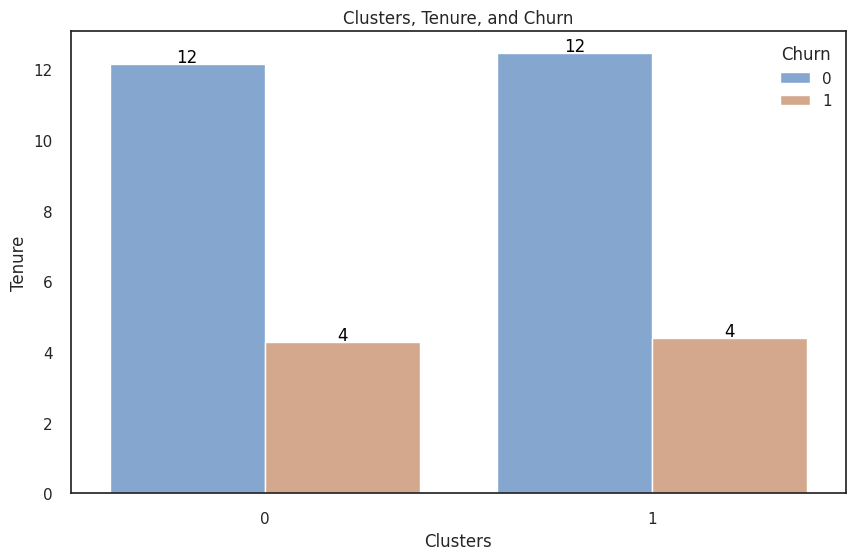

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="Tenure", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("Tenure")
plt.title("Clusters, Tenure, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

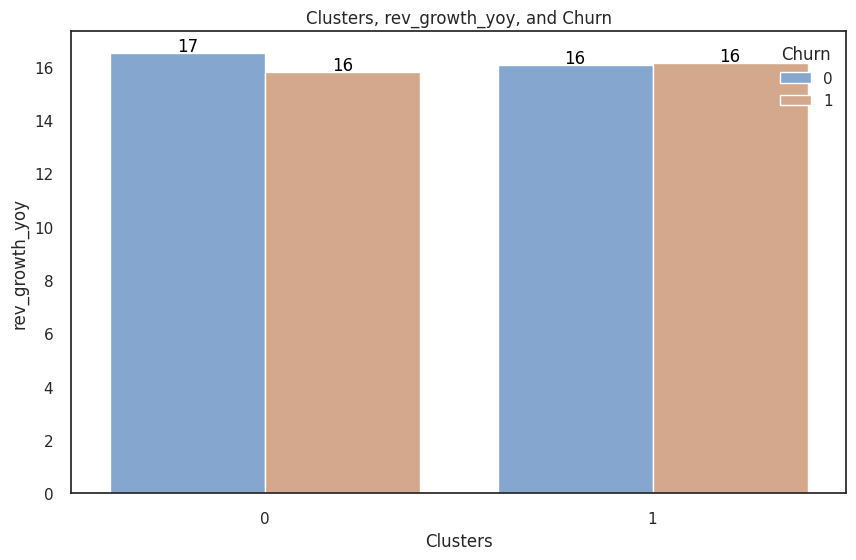

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="rev_growth_yoy", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("rev_growth_yoy")
plt.title("Clusters, rev_growth_yoy, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

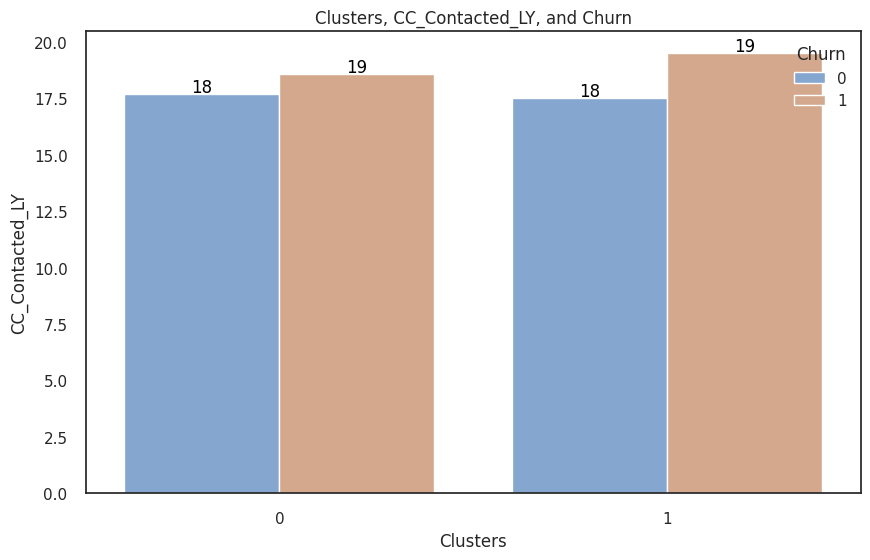

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="CC_Contacted_LY", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("CC_Contacted_LY")
plt.title("Clusters, CC_Contacted_LY, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

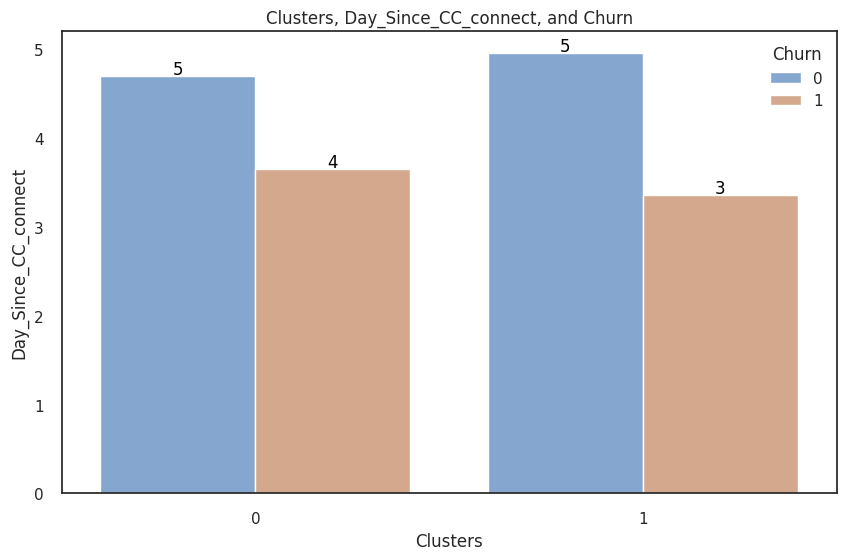

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="Day_Since_CC_connect", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("Day_Since_CC_connect")
plt.title("Clusters, Day_Since_CC_connect, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

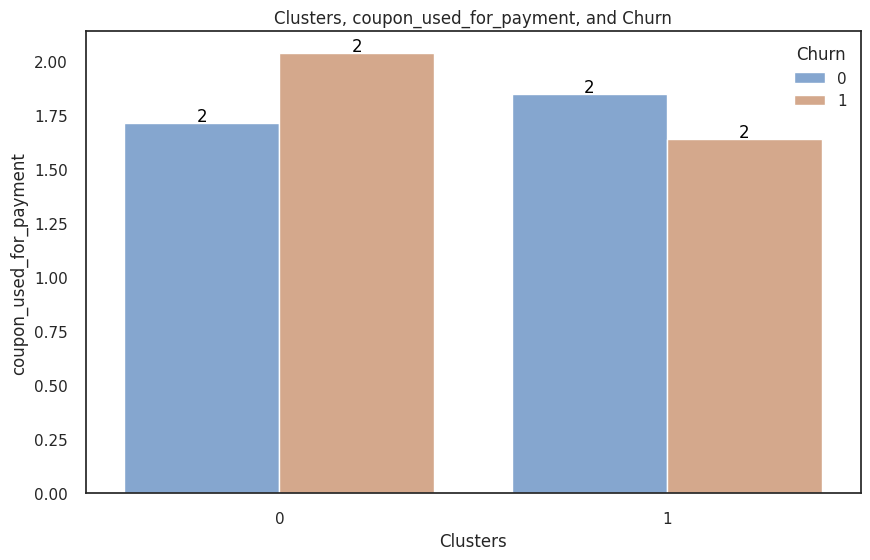

In [ ]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="coupon_used_for_payment", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("coupon_used_for_payment")
plt.title("Clusters, coupon_used_for_payment, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

## **EDA Summary**

---




**Executive Summary:**

1. **Data Collection and Preprocessing:**
   - The dataset appears to be derived from a DTH (Direct-To-Home) service provider, containing records over an unspecified period, possibly in Indian states with payments in Rupees via UPI.
   - Data preprocessing was performed to address missing values, correct data types, and standardize data. Anomalies and unexpected values were resolved.
   
2. **Exploratory Data Analysis:**
   - The dataset consists of 11,260 rows and 19 columns with a binary target variable, "Churn," representing customer attrition.
   - Key findings include class imbalance with only 16.8% of customers marked as churned.
   - Numerical features exhibit varying distributions, such as positively skewed tenure, moderate-skewed revenue, and highly skewed cashback.
   - Categorical variables like "City_Tier" show that the majority of customers are in Tier 1 cities, and payment methods like "Debit Card" and "Credit Card" are popular.
   
3. **Bivariate Analysis:**
   - Analysis of categorical variables indicated relationships between features and churn, highlighting the impact of "City_Tier," "Payment," and "Complain_ly" on customer attrition.
   - In numerical features, lower tenure, higher CC contacts in the last year, lower monthly revenue, and higher cashback amounts were associated with higher churn rates.

4. **Data Preparation:**
   - Unwanted variables were removed, and missing values were imputed using appropriate methods, with 2.04% of the data containing missing values.
   - Outliers were treated by capping values at the 1st and 99th percentiles. Standard scaling was applied to the dataset.

**Business Insights:**

1. **Churn Analysis:**
   - The class imbalance, with only 16.8% churned customers, indicates the need to focus on retaining existing customers to maintain business stability.
   
2. **Demographics and Churn:**
   - Customers from City_Tier 3 have a higher churn rate, suggesting that tailored offerings or incentives may be needed to retain these customers.
   - Churn rates differ based on payment methods and gender. Efforts should be made to engage male customers more effectively.

3. **Service and Customer Care:**
   - The "Service_Score" analysis shows that higher scores don't necessarily lead to lower churn. Service quality may need improvement.
   - Customers who complained in the last year had a significantly higher churn rate, indicating a need to address their issues promptly.

4. **Engagement and Loyalty:**
   - Increasing the number of account users leads to a higher churn rate. Strategies for retaining multi-user accounts should be explored.
   - Encouraging customers to use mobile devices for logins may reduce churn, as mobile users exhibit a lower attrition rate.

**Recommendations:**

1. **Balancing Churn Rate:**
   - Implement strategies to retain existing customers, including offering personalized deals and promotions.
   
2. **Customized Service Quality:**
   - Enhance services for specific segments, like "Regular Plus" customers, who have a higher churn rate. Address service quality issues identified in the data.
   
3. **Prompt Complaint Resolution:**
   - Improve customer care and promptly address customer complaints to prevent churn.
   
4. **Multi-User Account Strategies:**
   - Create incentives or tailored offerings for multi-user accounts to reduce attrition.
   
5. **Mobile Login Promotion:**
   - Promote mobile login to lower churn by making it more convenient for customers.


# **Model Building**
---

#### **Tree Based Models**
- We will use original dataset df1- which was scaled & encoded to have the models learn from original data, not the VIF treated dataset as these have no effect on tree based model


In [ ]:
df1.shape

(11260, 18)

In [ ]:
df1.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,1.0


In [ ]:
# Split Predictors & response
X = df1.drop('Churn', axis=1)
y= df1['Churn']

In [ ]:
#Train & Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size =0.2, random_state=42)

In [ ]:
print("Shape of Train dataset:", X_train.shape)
print("Shape of Train dataset:",X_test.shape)

Shape of Train dataset: (9008, 17)
Shape of Train dataset: (2252, 17)


**Function to display confusion matrix and ROC curve**

In [ ]:
#Defining function to plot confusion matrix and ROC curve
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve
def plot_model_evaluation(model, X_train, y_train, X_test, y_test, model_name):
    # Confusion Matrix
    cm_train = confusion_matrix(y_train, model.predict(X_train))
    cm_test = confusion_matrix(y_test, model.predict(X_test))
    fig, axes = plt.subplots(1, 2, figsize=(9, 4))
    # Train Data
    sns.heatmap(cm_train, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[0])
    axes[0].set_title(f"Confusion Matrix ({model_name} - Train Data)")
    axes[0].set_xlabel("Predicted")
    axes[0].set_ylabel("Actual")
    # Test Data
    sns.heatmap(cm_test, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[1])
    axes[1].set_title(f"Confusion Matrix ({model_name} - Test Data)")
    axes[1].set_xlabel("Predicted")
    axes[1].set_ylabel("Actual")
    # Annotate TP, TN, FP, FN
    for i, cm in enumerate([cm_train, cm_test]):
        axes[i].annotate("TP", xy=(1.45, 1.7), fontsize=10, color='black', va='center')
        axes[i].annotate("TN", xy=(0.45, 0.7), fontsize=10, color='white', va='center')
        axes[i].annotate("FP", xy=(1.45, 0.7), fontsize=10, color='black', va='center')
        axes[i].annotate("FN", xy=(0.45, 1.7), fontsize=10, color='black', va='center')
    plt.tight_layout()
    plt.show()
    # ROC curve
    Y_train_predict_prob = model.predict_proba(X_train)
    probs_train = Y_train_predict_prob[:, 1]
    auc_train = roc_auc_score(y_train, probs_train)
    fpr_train, tpr_train, thresholds_train = roc_curve(y_train, probs_train)
    Y_test_predict_prob = model.predict_proba(X_test)
    probs_test = Y_test_predict_prob[:, 1]
    auc_test = roc_auc_score(y_test, probs_test)
    fpr_test, tpr_test, thresholds_test = roc_curve(y_test, probs_test)
    plt.figure(figsize=(9, 4))
    # ROC curve of training data
    plt.subplot(1, 2, 1)
    plt.title(f'ROC Curve {model_name} Train Data')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.plot(fpr_train, tpr_train, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.text(0.6, 0.3, f'AUC = {round(auc_train, 2)}', fontsize=10)
    # ROC curve of testing data
    plt.subplot(1, 2, 2)
    plt.title(f'ROC Curve {model_name} Test Data')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.plot(fpr_test, tpr_test, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.text(0.6, 0.3, f'AUC = {round(auc_test, 2)}', fontsize=10)
    plt.tight_layout()
    plt.show()

**Function to display Learning Curve and CV scores**

In [ ]:
#Plot Learning Curve & print CV score
from sklearn.model_selection import cross_val_score, learning_curve
def plot_model_learning_curve(model, model_name, X_train, y_train):
    num_folds = 5
    scoring_metric = 'recall'
    train_sizes = np.linspace(0.1, 1.0, 10)
    # Cross-validation scores
    cv_scores = cross_val_score(model, X_train, y_train, cv=num_folds, scoring=scoring_metric)
    # Learning curve
    sizes, train, test = learning_curve(model, X_train, y_train, cv=num_folds, scoring=scoring_metric, train_sizes=train_sizes)
    # Plot learning curve
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.title(f"Learning Curve for {model_name}")
    plt.xlabel("Training Examples")
    plt.ylabel(f"{scoring_metric} Score")
    plt.grid()
    plt.plot(sizes, np.mean(train, axis=1), 'o-', color="r", label="Training Score")
    plt.plot(sizes, np.mean(test, axis=1), 'o-', color="g", label="Cross-Validation Score")
    plt.legend(loc="best")
    # Print CV scores and variances
    print(f"Model: {model_name}")
    print(f"Cross-Validation Scores: {cv_scores}")
    print(f"Mean CV Score: {np.mean(cv_scores):.3f}")
    print(f"Cross-Validation Variance: {np.var(cv_scores):.3f}")
    print("")

## Decision Tree Model

---

A decision tree, as the term suggests, uses a tree-like model to make predictions. It resembles an upside-down tree and uses a similar process that we do to make decisions in real life, i.e., by asking a series of questions to arrive at a decision .




 <img src="https://media.geeksforgeeks.org/wp-content/uploads/20230424141727/Decision-Tree.webp" width="800" height="250" alt="Confusion Matrix">


- A decision tree splits data into multiple sets of data. Each of these sets is then further split into subsets to arrive at a decision

-  It can be used to model highly non-linear data.
- Decision trees are non-parametric means no specific data distribution is necessary. Decision trees easily handle continuous and categorical variables.
- A decision tree is scale-invariant. It does not require normalisation, as it only has to compare the values within an attribute, and it handles multicollinearity better. (We have done scaling here, it does not impact)



In [ ]:
from sklearn.tree import DecisionTreeClassifier

dtcla = DecisionTreeClassifier(random_state=42, criterion = 'gini')
dtcla.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

In [ ]:
pred_train=dtcla.predict(X_train)
pred_test=dtcla.predict(X_test)

#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7508
         1.0       1.00      1.00      1.00      1500

    accuracy                           1.00      9008
   macro avg       1.00      1.00      1.00      9008
weighted avg       1.00      1.00      1.00      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.97      0.97      1856
         1.0       0.84      0.84      0.84       396

    accuracy                           0.94      2252
   macro avg       0.90      0.90      0.90      2252
weighted avg       0.94      0.94      0.94      2252



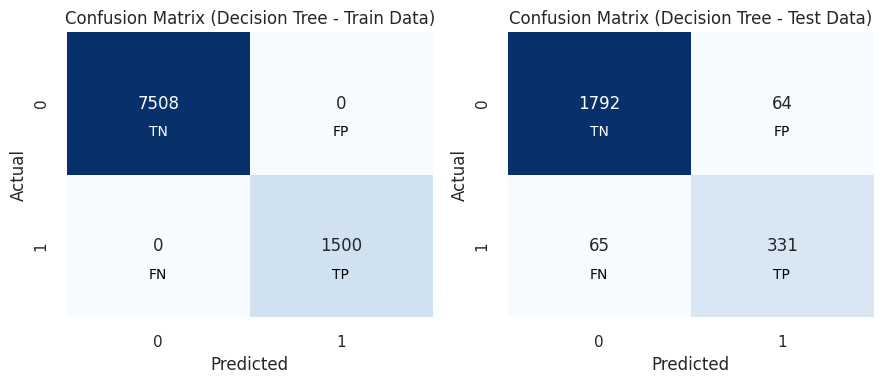

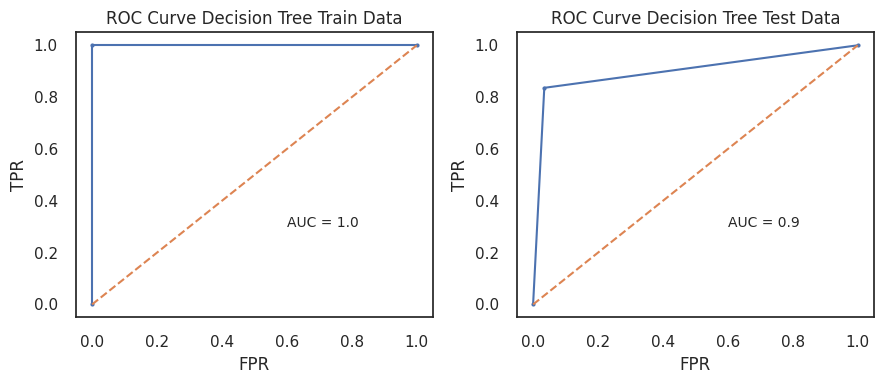

In [ ]:
plot_model_evaluation(dtcla, X_train, y_train, X_test, y_test, "Decision Tree")

- The recall of the minority class (1) is 84% on the test set. This means that the model is able to identify 84% of the actual positive cases

- The AUC for train data is 1.0 while 0.9 for training data


Model: Decision Tree
Cross-Validation Scores: [0.82333333 0.85333333 0.86333333 0.82666667 0.80666667]
Mean CV Score: 0.835
Cross-Validation Variance: 0.000



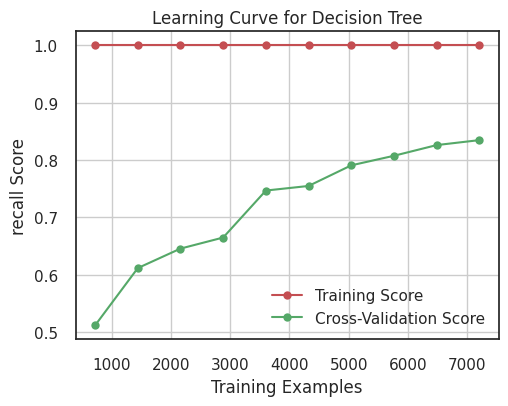

In [ ]:
plot_model_learning_curve(dtcla, "Decision Tree", X_train, y_train)

- The cross-validation scores show that the model is overfitting the training data. The mean cross-validation score is 83.5%, while the training accuracy is 100%. This suggests that the model is learning the training data too well and is not able to generalize to new data.

- The learning curve also shows signs of overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus.

- This suggests that the model is learning the training data too well and is not able to generalize to new data.


In [ ]:
!pip install pydotplus
!pip install graphviz


In [ ]:
from sklearn import tree
import pydotplus
from IPython.display import Image

train_char_label = ['0', '1']

dot_data = tree.export_graphviz(dtcla, out_file=None, feature_names=list(X_train), class_names=train_char_label, filled=True, rounded=True)
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

                              Imp
Tenure                   0.317485
City_Tier                0.021378
CC_Contacted_LY          0.050265
Payment                  0.066690
Gender                   0.015594
Service_Score            0.014390
Account_user_count       0.029016
account_segment          0.031458
CC_Agent_Score           0.066481
Marital_Status           0.034712
rev_per_month            0.058072
Complain_ly              0.051826
rev_growth_yoy           0.053173
coupon_used_for_payment  0.016921
Day_Since_CC_connect     0.082955
cashback                 0.069577
Login_device             0.020008


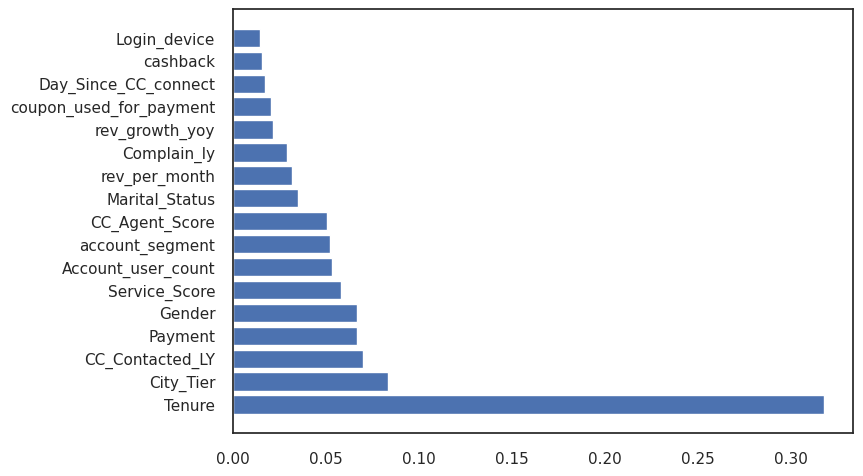

In [ ]:
# importance of features in the tree building ( The importance of a feature is computed as the
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print (pd.DataFrame(dtcla.feature_importances_, columns = ["Imp"], index = X_train.columns))
plt.barh(X_train.columns, np.array(pd.DataFrame(dtcla.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

Feature importance
- Customers with shorter tenure are more likely to churn. This could be because they are less invested in the company and are more likely to switch to a competitor.
- Customers who have not connected to their CC in a while are more likely to churn. This could be because they are
 not using the company's services very often and are therefore more likely to switch to a competitor.
- Customers who receive higher cashback rewards are less likely to churn. This is because they are getting more value from the company's services and are therefore more likely to stay.
- Customers who have a lower CC Agent Score are more likely to churn. This could be because they have had a negative experience with the company's customer service team.


**Insights**

- The model is able to identify a good proportion of the actual positive cases (84% recall for the minority class). This is important for applications where it is critical to avoid false negatives.
- The model is overfitting the training data. This is evident from the relatively large difference between the training accuracy and the cross-validation score.
- The model may not generalize well to new data. This is evident from the plateau in the learning curve.
- Regularization can help to prevent the model from overfitting the training data. Or Pruning the tree can help to reduce the complexity of the tree and prevent overfitting

## Random Forest Model

---
---




Random Forest is a powerful ensemble learning technique, often regarded as an extension of decision trees. It operates through the following steps:-
1. Random Sampling: Random Forest selects random subsets of data from the given dataset.
2. Decision Trees: For each of these data subsets, it constructs a decision tree, making predictions on each subset.
3. Voting: Random Forest then aggregates the predictions from all decision trees through a voting mechanism.
4. Majority Rule: The prediction result with the highest number of votes becomes the final prediction.


 <img src="https://www.tibco.com/sites/tibco/files/media_entity/2021-05/random-forest-diagram.svg" width="900" height="400" alt="Confusion Matrix">



In [ ]:
rfcl = RandomForestClassifier(random_state=42)
rfcl.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
# Make predictions on the training and test data
pred_train = rfcl.predict(X_train)
pred_test = rfcl.predict(X_test)

#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7508
         1.0       1.00      1.00      1.00      1500

    accuracy                           1.00      9008
   macro avg       1.00      1.00      1.00      9008
weighted avg       1.00      1.00      1.00      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.99      0.98      1856
         1.0       0.96      0.89      0.92       396

    accuracy                           0.97      2252
   macro avg       0.97      0.94      0.95      2252
weighted avg       0.97      0.97      0.97      2252



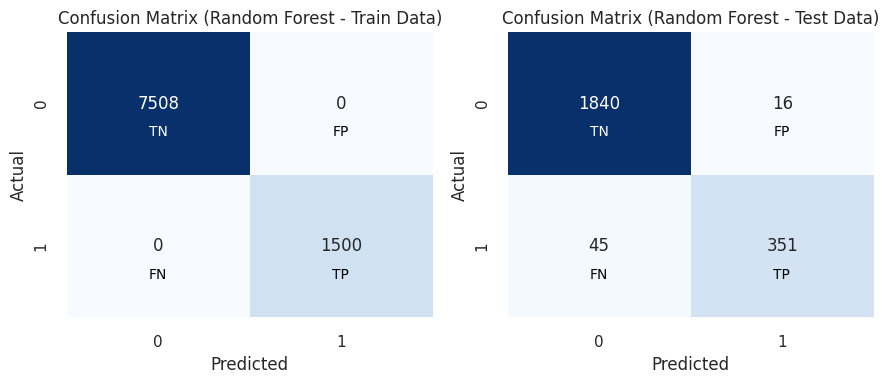

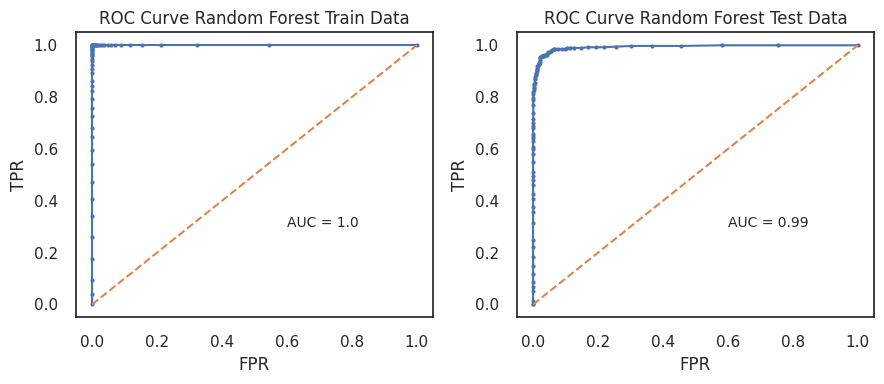

In [ ]:
plot_model_evaluation(rfcl, X_train, y_train, X_test, y_test, "Random Forest")

- The recall of the minority class (1) is 89% on the test set.

- This means that the model is able to identify 89% of the actual positive cases. This is a good result, and it is better than the recall of the decision tree model (84%).






Model: Random Forest
Cross-Validation Scores: [0.84       0.87333333 0.9        0.85333333 0.84      ]
Mean CV Score: 0.861
Cross-Validation Variance: 0.001



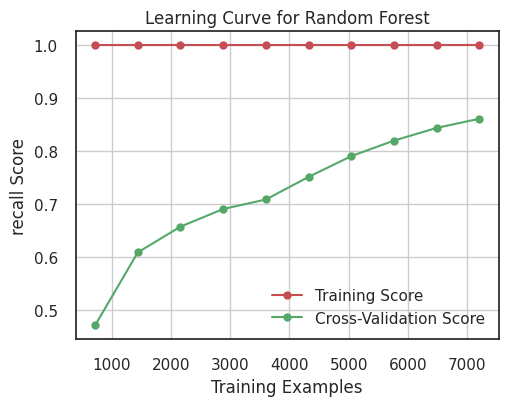

In [ ]:
plot_model_learning_curve(rfcl, "Random Forest", X_train, y_train)

- The cross-validation scores show that the model is slightly overfitting the training data. The mean cross-validation score is 86.1%, while the training accuracy is 100%.

- The learning curve also shows some signs of overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus.



#### Feature Importance


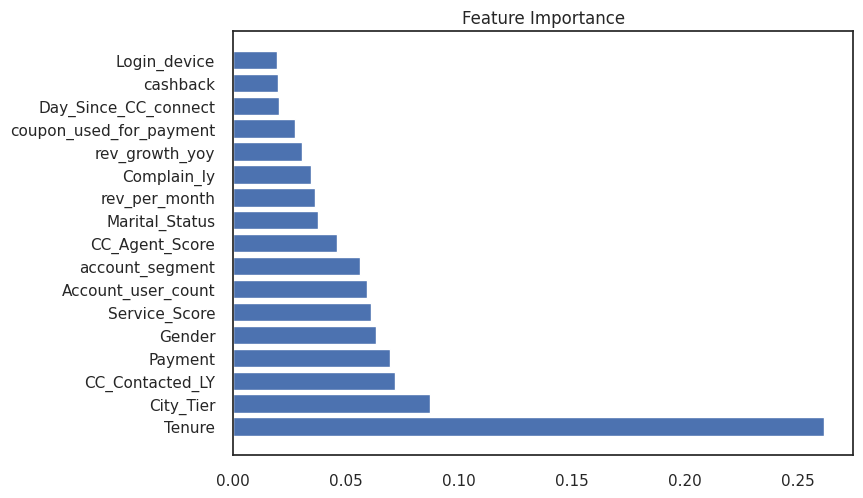

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, np.array(pd.DataFrame(rfcl.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

- Customers with shorter tenure, longer time since last CC connect, lower cashback, and lower CC Agent Score are more likely to churn.


**Insights**

- The random forest model is performing well on the test set, with a high recall for the minority class and a low level of overfitting.
- The model is able to identify a good proportion of the actual positive cases (89% recall for the minority class). This is important for applications where it is critical to avoid false negatives.
- The model is slightly overfitting the training data. However, the overfitting is not severe and the model is still able to generalize well to new data.

- However, we will hypertune the model to reduce overfitting & see if it improves recall

## Linear Discriminant Analysis ( LDA)

---



Linear Discriminant Analysis predicts the class in dependent variable using a linear combination of independent variables.

LDA projects the features in higher-dimensional space onto a lower dimensional space. LDA then searches for a linear combination of independent variables (line, plane, or hyperplane) that best separates the classes of the dependent variable.


  
Assumptions of LDA:
1. Each feature in the dataset is a gaussian distribution
2. Each feature has the same variance, the value of each feature varies around the  mean with the same amount on average.
3. Each feature is assumed to be randomly sampled.
4. Lack of multicollinearity in independent features. Increase in correlations between independent features and the power of prediction decreases.


<img src="https://lh6.googleusercontent.com/ar5TGG5URcdr3EWHMPDIzovIZp_v0KzrXHraV06tMQEHBCdyrncGshMkTD438QRNmnesmunAvuzzp1xvTEjhqLkm9XR-wIOviiOpqsplTirUZBmx9Ymm1SOuM60K1-mszWaOpvIy" width="800" height="300" alt="Confusion Matrix">


In [ ]:
lda = LinearDiscriminantAnalysis()
lda.fit(X_train, y_train)

LinearDiscriminantAnalysis()

In [ ]:
pred_train = lda.predict(X_train)
pred_test = lda.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.88      0.98      0.92      7508
         1.0       0.74      0.30      0.43      1500

    accuracy                           0.87      9008
   macro avg       0.81      0.64      0.68      9008
weighted avg       0.85      0.87      0.84      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.87      0.98      0.92      1856
         1.0       0.76      0.33      0.46       396

    accuracy                           0.86      2252
   macro avg       0.82      0.65      0.69      2252
weighted avg       0.85      0.86      0.84      2252



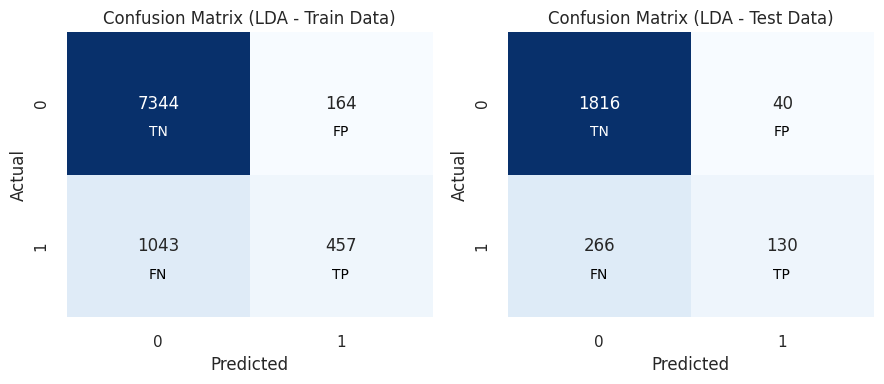

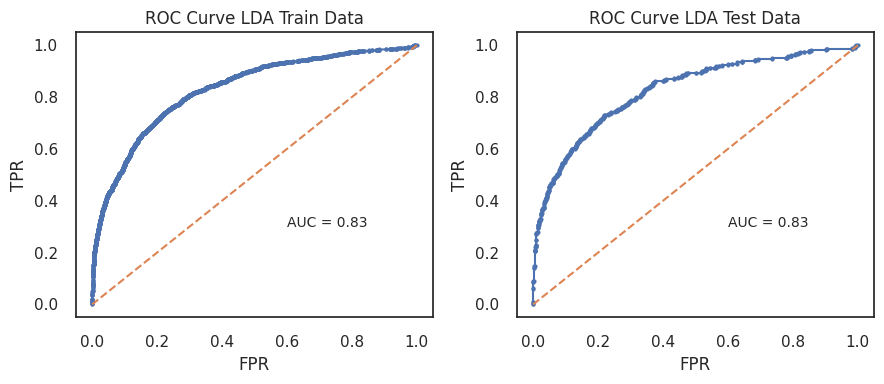

In [ ]:
plot_model_evaluation(lda, X_train, y_train, X_test, y_test, "LDA")

- The LDA model has a low recall score of 0.33 on the test data.
- It is only able to correctly predict 33% of the churn customers. This is a very low recall score, and it is not good enough for churn prediction.




Model: LDA
Cross-Validation Scores: [0.31       0.28666667 0.31666667 0.28333333 0.31333333]
Mean CV Score: 0.302
Cross-Validation Variance: 0.000



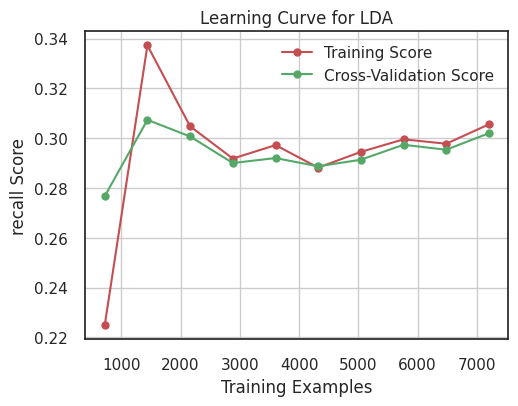

In [ ]:
plot_model_learning_curve(lda, "LDA", X_train, y_train)

- The cross-validation scores are also very low, with a mean of 30.2%. This shows that the model is overfitting.

- The learning curve shows that the training accuracy and cross-validation accuracy both saturate early, which is  sign of overfitting.



#### Feature Importance

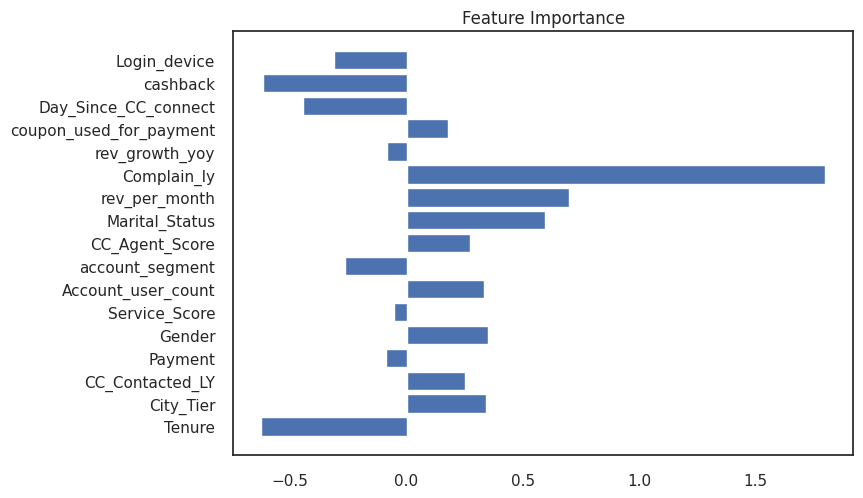

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, lda.coef_[0]);

**Insights**:

- The model is only able to correctly predict 33% of the churn customers. This is a very low recall score, and it is not good enough for churn prediction
- The LDA Model is overfitting the training data.
- Not able to generalize well to unseen data hence not a good model for predicting churn.


## K-Nearest Neighbors (KNN)

---

The data-point in KNN is classified on the basis of its k Nearest Neighbors, followed by the majority vote of those nearest neighbors; a query point is assigned the data class which has the most representatives within the nearest neighbors of the point

K-NN is a non-parametric algorithm, which means it does not make any assumptions on underlying data


In [ ]:
from sklearn.neighbors import KNeighborsClassifier


- We initally used k -5 wherein the model was overfitting
- We changed to lower value of k = 3 as the optimum value

In [ ]:
knn = KNeighborsClassifier(n_neighbors = 3, weights = 'uniform')

In [ ]:
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=3)

In [ ]:
pred_train = knn.predict(X_train)
pred_test = knn.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      1.00      1.00      7508
         1.0       0.99      0.97      0.98      1500

    accuracy                           0.99      9008
   macro avg       0.99      0.99      0.99      9008
weighted avg       0.99      0.99      0.99      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.99      0.98      1856
         1.0       0.96      0.89      0.92       396

    accuracy                           0.97      2252
   macro avg       0.97      0.94      0.95      2252
weighted avg       0.97      0.97      0.97      2252



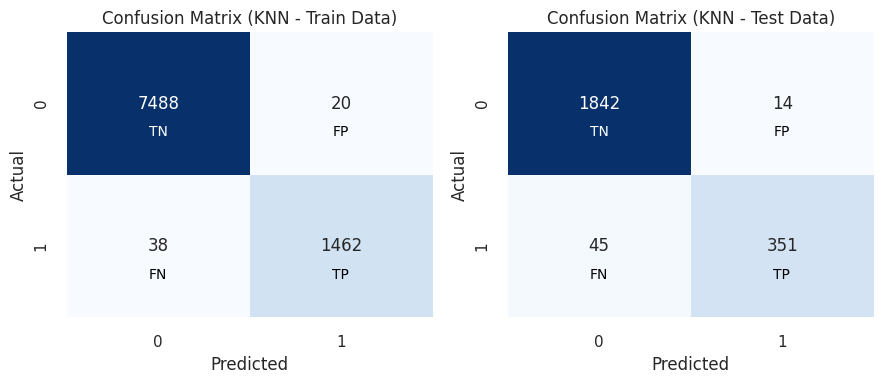

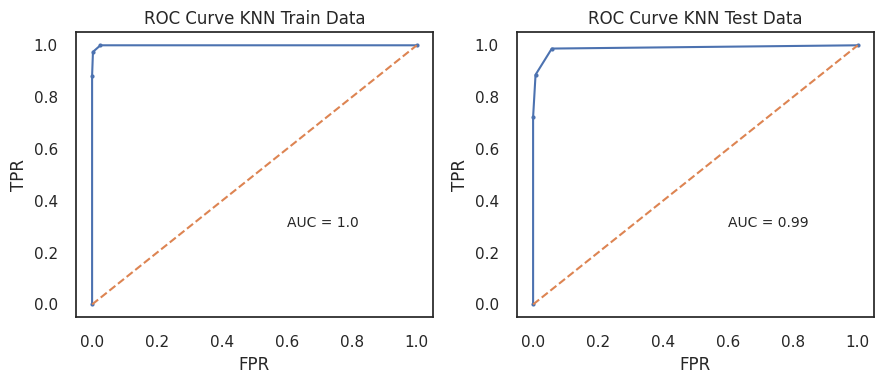

In [ ]:
plot_model_evaluation(knn, X_train, y_train, X_test, y_test, "KNN")

- The KNN model has a good recall score of 0.97 on training data, however, it drops to 0.89 on the test data.

- This suggests that the model may be overfitting slightly on the training data ie.e model is learning the patterns in the training data, but it is not able to generalize these patterns to the test data with same accuracy

Model: KNN
Cross-Validation Scores: [0.85333333 0.86333333 0.92       0.88       0.9       ]
Mean CV Score: 0.883
Cross-Validation Variance: 0.001



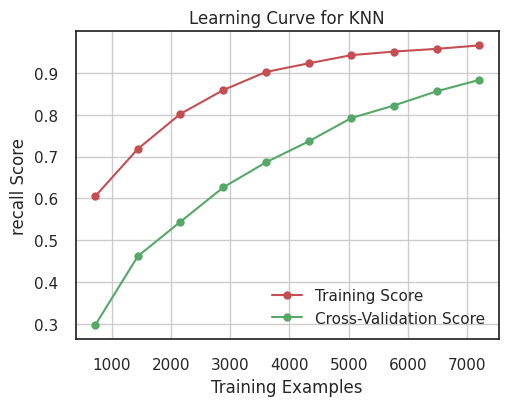

In [ ]:
plot_model_learning_curve(knn, "KNN", X_train, y_train)

-  The KNN model's cross-validation scores are reasonably consistent, with a mean score of approximately 0.883 and minimal variance.

- Slight overfitting can be observed here.

- The learning curve for the KNN model shows training recall score and cross-validation score both converge quickly.

**Insights**

- Model Performance: The K-Nearest Neighbors (KNN) model exhibits overall good performance on both the training and test data. It achieves high precision, recall, and F1-score, particularly for non-churn cases (0.0) while drops slightily on test data

- The learning curve shows that the training accuracy and cross-validation accuracy both converge quickly. The model slightly overfits






## Naive Bays

---


Naïve Bayes Classifier can be trained easily and fast and can be used as benchmark model

It requires a strong assumption of independent predictors, so when the model has a bad performance, the reason leading to that may be the dependence between predictors.


In [ ]:
#Naive Bayes Classfier
from sklearn.naive_bayes import BernoulliNB

NB_model = BernoulliNB()
NB = NB_model.fit(X_train, y_train)
pred = NB.predict(X_test)
pred_prob = NB.predict_proba(X_test)

In [ ]:
pred_train = NB_model.predict(X_train)
pred_test = NB_model.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.86      0.98      0.91      7508
         1.0       0.61      0.19      0.29      1500

    accuracy                           0.84      9008
   macro avg       0.73      0.58      0.60      9008
weighted avg       0.82      0.84      0.81      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.85      0.98      0.91      1856
         1.0       0.67      0.21      0.32       396

    accuracy                           0.84      2252
   macro avg       0.76      0.59      0.61      2252
weighted avg       0.82      0.84      0.81      2252



- The Naive Bayes model in the given report has a low recall score of 0.21 on the test data. This means that the model is only able to correctly identify 21% of churn customers on the test data.

-  This is a very low recall score, and it suggests that the model is not able to identify churn customers with a high degree of accuracy.



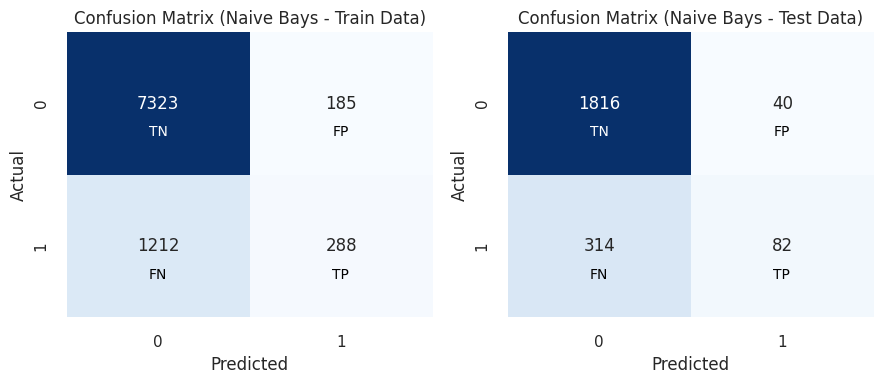

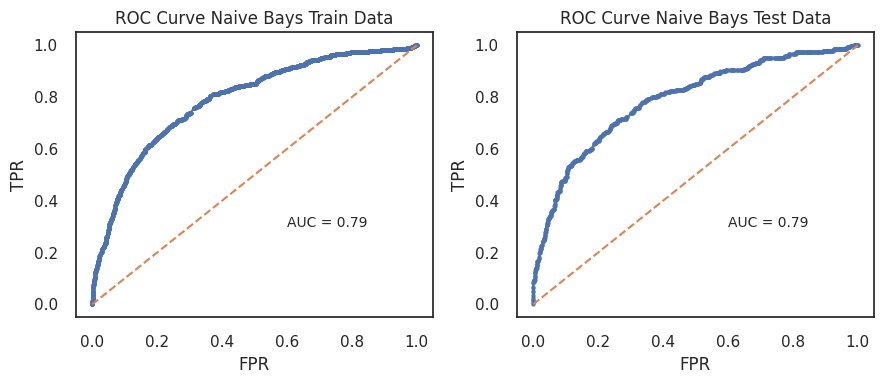

In [ ]:
plot_model_evaluation(NB_model, X_train, y_train, X_test, y_test, "Naive Bays")

Model: Naive Bays
Cross-Validation Scores: [0.18       0.17333333 0.21333333 0.18       0.20333333]
Mean CV Score: 0.190
Cross-Validation Variance: 0.000



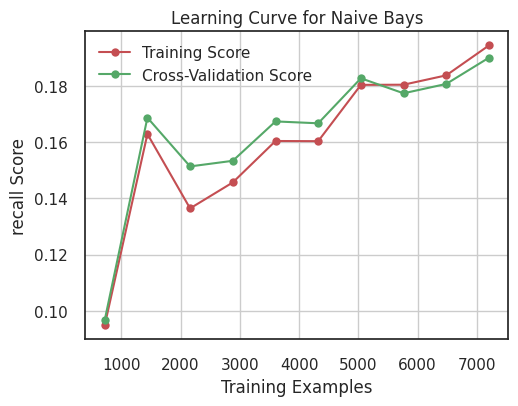

In [ ]:
plot_model_learning_curve(NB_model, "Naive Bays", X_train, y_train)

- The Naive Bayes model has a low mean cross-validation score of 0.19. This further confirms that the model is overfitting the training data.

- The learning curve for the Naive Bayes model shows that the training accuracy and cross-validation accuracy both saturate early. This is a sign of overfitting.



**Insights**

- The Naive Bayes model in the given report is not a good model for predicting churn. It has a low recall score on the test data
- The model is overfitting the training data, it is not likely to generalize well to unseen data.
- The Naive Bayes model is not a good model for predicting churn.



## Model Tuning- Ensemble methods & Hyperparameter Tuning

## Regularised Decision Tree
Hyperparameter Tuning

In [ ]:
# Defining the hyperparameter grid with max_depth, min_samples_split, and min_samples_leaf
param_grid = {
    'max_depth': [7, 8, 9, 10, 11, 12],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [ ]:
reg_dtcl = DecisionTreeClassifier(random_state=42, criterion='gini')
grid_search = GridSearchCV(reg_dtcl, param_grid, cv=5, scoring='recall')
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': [7, 8, 9, 10, 11, 12],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10]},
             scoring='recall')

In [ ]:
# Best hyperparameters
best_max_depth = grid_search.best_params_['max_depth']
best_min_samples_split = grid_search.best_params_['min_samples_split']
best_min_samples_leaf = grid_search.best_params_['min_samples_leaf']

print("Best max_depth:", best_max_depth)
print("Best min_samples_split:", best_min_samples_split)
print("Best min_samples_leaf:", best_min_samples_leaf)


Best max_depth: 12
Best min_samples_split: 2
Best min_samples_leaf: 1


Best max_depth: 12
Best min_samples_split: 2
Best min_samples_leaf: 1


In [ ]:
# Create a DecisionTreeClassifier with the best hyperparameters
reg_dtcl = DecisionTreeClassifier(
    max_depth=best_max_depth,
    min_samples_split=best_min_samples_split,
    min_samples_leaf=best_min_samples_leaf,
    random_state=42,
    criterion='gini')

In [ ]:
reg_dtcl.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=12, random_state=42)

In [ ]:
pred_train = reg_dtcl.predict(X_train)
pred_test = reg_dtcl.predict(X_test)

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      1.00      0.99      7508
         1.0       0.98      0.94      0.96      1500

    accuracy                           0.99      9008
   macro avg       0.98      0.97      0.98      9008
weighted avg       0.99      0.99      0.99      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.95      0.97      0.96      1856
         1.0       0.84      0.78      0.81       396

    accuracy                           0.94      2252
   macro avg       0.90      0.88      0.89      2252
weighted avg       0.94      0.94      0.94      2252



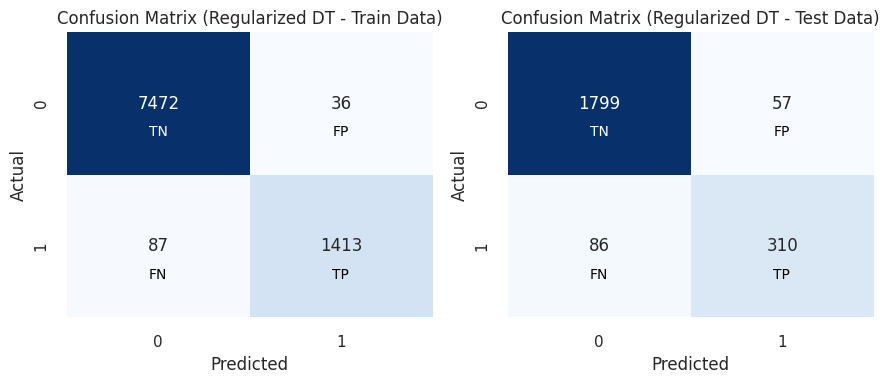

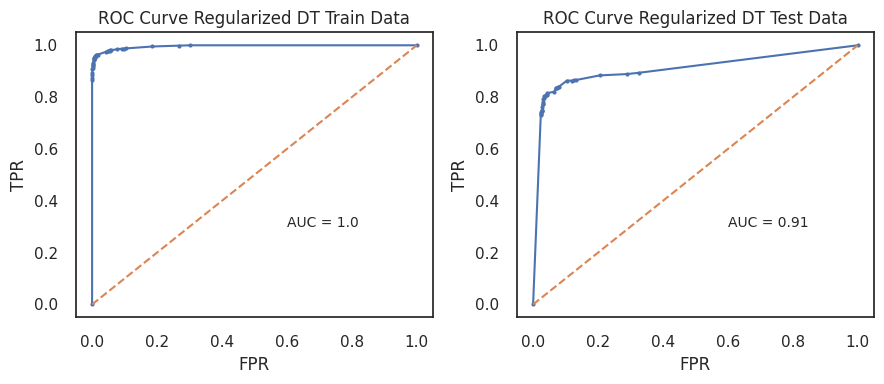

In [ ]:
plot_model_evaluation(reg_dtcl, X_train, y_train, X_test, y_test, "Regularized DT")

- The recall of the minority class (1) is 78% on the test set. This means that the model is able to identify 78% of the actual positive cases.

- This is a moderate result, but it still need improvement, we will look at other models

- The AUC score of 1.0 on the training data and 0.91 on the test data also suggests that the model is performing well.


Model: Regularized Decision Tree
Cross-Validation Scores: [0.76333333 0.81666667 0.82666667 0.82333333 0.76666667]
Mean CV Score: 0.799
Cross-Validation Variance: 0.001



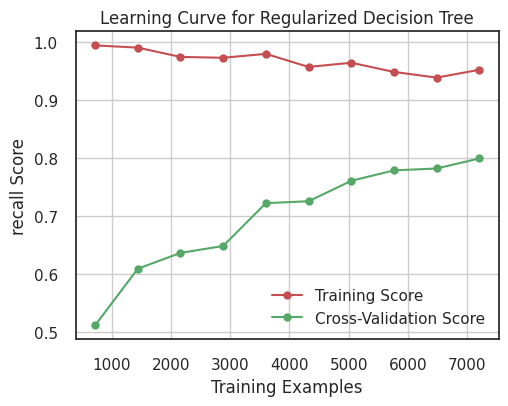

In [ ]:
plot_model_learning_curve(reg_dtcl, "Regularized Decision Tree", X_train, y_train)

- The cross-validation scores show that the model is overfitting the training data. The mean cross-validation score is 79.9%, which is significantly lower than the training accuracy of 99%.
- The learning curve also shows that the model is overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus.

- This suggests that the model is learning the training data too well and is not able to generalize to new data.


In [ ]:
dot_data = tree.export_graphviz(reg_dtcl, out_file=None, feature_names=list(X_train), class_names=train_char_label, filled=True, rounded=True)
graph = pydotplus.graph_from_dot_data(dot_data)

Image(graph.create_png())


                              Imp
Tenure                   0.335063
City_Tier                0.024298
CC_Contacted_LY          0.046445
Payment                  0.062728
Gender                   0.017716
Service_Score            0.012866
Account_user_count       0.027539
account_segment          0.027604
CC_Agent_Score           0.060235
Marital_Status           0.029049
rev_per_month            0.057662
Complain_ly              0.056238
rev_growth_yoy           0.058401
coupon_used_for_payment  0.016160
Day_Since_CC_connect     0.084966
cashback                 0.061883
Login_device             0.021148


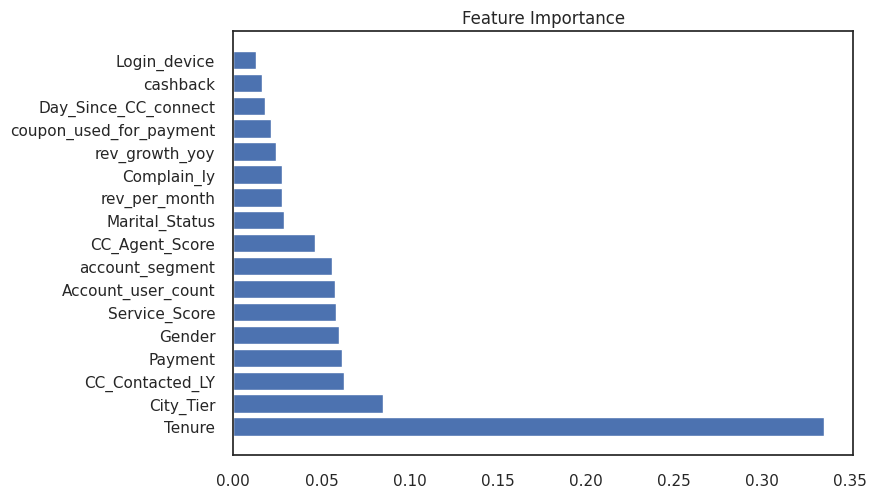

In [ ]:
print (pd.DataFrame(reg_dtcl.feature_importances_, columns = ["Imp"], index = X_train.columns))
plt.title('Feature Importance')
plt.barh(X_train.columns, np.array(pd.DataFrame(reg_dtcl.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

Feature importance:
- Tenure: Longer customer tenure is top factors reducing churn.

- Revenue and Complaints: Higher spending, positive revenue growth, and fewer complaints decrease churn likelihood.

- Service and Payment: Positive service experiences and certain payment methods influence churn prediction.


**Insights**
- The model is able to identify a moderate proportion of the actual positive cases (78% recall for the minority class). This may be sufficient for some applications, but it may not be sufficient for applications where it is critical to avoid false negatives.
- The model is overfitting the training data. This is evident from the large gap between the cross-validation scores and the training accuracy.
- The model may not generalize well to new data. This is evident from the plateau in the learning curve.

- Overall, the regularized decision tree model is performing moderately on the test set, with a moderate recall for the minority class and overfitting.




## Bagging

- We are going to use the regularized decision Tree as base estimator for the Bagging

In [ ]:
from sklearn.ensemble import BaggingClassifier

bagging_classifier = BaggingClassifier(
    base_estimator=reg_dtcl,  #  regularized Decision Tree
    n_estimators=10,
    random_state=42
)

In [ ]:
bagging_classifier.fit(X_train, y_train)


BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=12,
                                                        random_state=42),
                  random_state=42)

In [ ]:
pred_train = bagging_classifier.predict(X_train)
pred_test = bagging_classifier.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      1.00      1.00      7508
         1.0       1.00      0.96      0.98      1500

    accuracy                           0.99      9008
   macro avg       0.99      0.98      0.99      9008
weighted avg       0.99      0.99      0.99      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.99      0.98      1856
         1.0       0.93      0.83      0.88       396

    accuracy                           0.96      2252
   macro avg       0.95      0.91      0.93      2252
weighted avg       0.96      0.96      0.96      2252



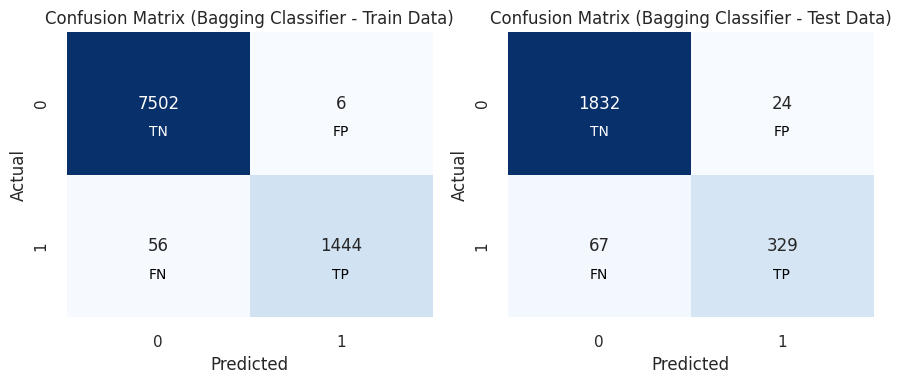

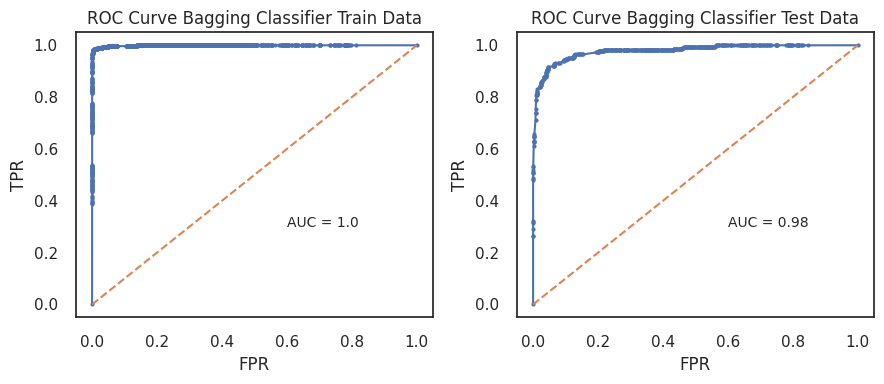

In [ ]:
plot_model_evaluation(bagging_classifier, X_train, y_train, X_test, y_test, "Bagging Classifier")

- The Bagging Classifier has a very good recall score of 0.83 on the test data for the minority class (churn).

- This means that the model is able to correctly identify 83% of churn customers on the test data.

- The AUC score of 1.0 on the training data and 0.98 on the test data also suggests that the model is performing very well.


Model: Bagging Classifier
Cross-Validation Scores: [0.76666667 0.82       0.87666667 0.78666667 0.78666667]
Mean CV Score: 0.807
Cross-Validation Variance: 0.001



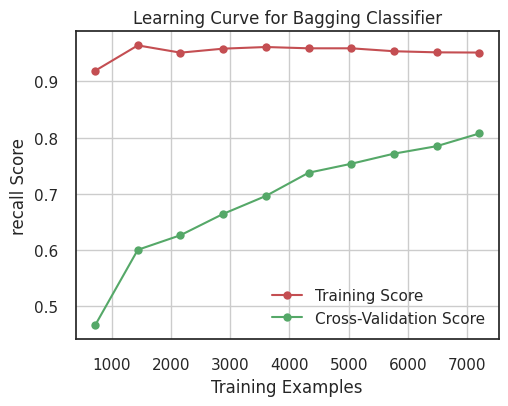

In [ ]:
plot_model_learning_curve(bagging_classifier, "Bagging Classifier", X_train, y_train)

- The cross-validation scores show that the bagging classifier is overfitting the training data. The mean cross-validation score is 80.7%, which is significantly lower than the training accuracy of 99%.

- The learning curve also shows that the bagging classifier is overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus.

-  This suggests that the model is learning the training data too well and is not able to generalize to new data.



**Insights**

- The model is able to identify a good proportion of the actual positive cases (83% recall for the minority class). This may be sufficient for some applications, but it may not be sufficient for applications where it is critical to avoid false negatives.
- The model is overfitting the training data. This is evident from the large gap between the cross-validation scores and the training accuracy.
- The model may not generalize well to new data. This is evident from the plateau in the learning curve.
Overall, the bagging classifier is performing moderately on the test set, with a good recall for the minority class and overfitting.



## Tuned LDA

In [ ]:
#Discriminant Analysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

param_grid = {'solver': ['lsqr', 'eigen', 'svd'],
              'tol': [0.1, 0.01, 0.001]
              }
model = LinearDiscriminantAnalysis()
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='recall')


In [ ]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=LinearDiscriminantAnalysis(),
             param_grid={'solver': ['lsqr', 'eigen', 'svd'],
                         'tol': [0.1, 0.01, 0.001]},
             scoring='recall')

In [ ]:
grid_search.best_params_

{'solver': 'lsqr', 'tol': 0.1}

{'solver': 'lsqr', 'tol': 0.1}


In [ ]:
best_lda = grid_search.best_estimator_

In [ ]:
Y_train_tlda = best_lda.predict(X_train)
Y_test_tlda = best_lda.predict(X_test)

#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train, Y_train_tlda))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, Y_test_tlda))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.88      0.98      0.92      7508
         1.0       0.74      0.30      0.43      1500

    accuracy                           0.87      9008
   macro avg       0.81      0.64      0.68      9008
weighted avg       0.85      0.87      0.84      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.87      0.98      0.92      1856
         1.0       0.76      0.33      0.46       396

    accuracy                           0.86      2252
   macro avg       0.82      0.65      0.69      2252
weighted avg       0.85      0.86      0.84      2252



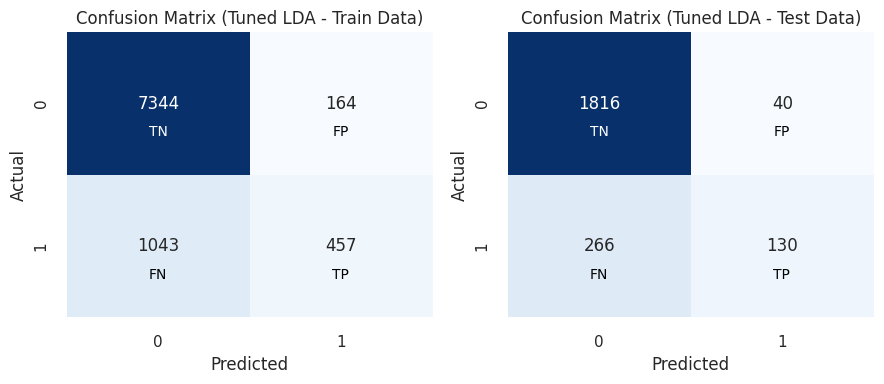

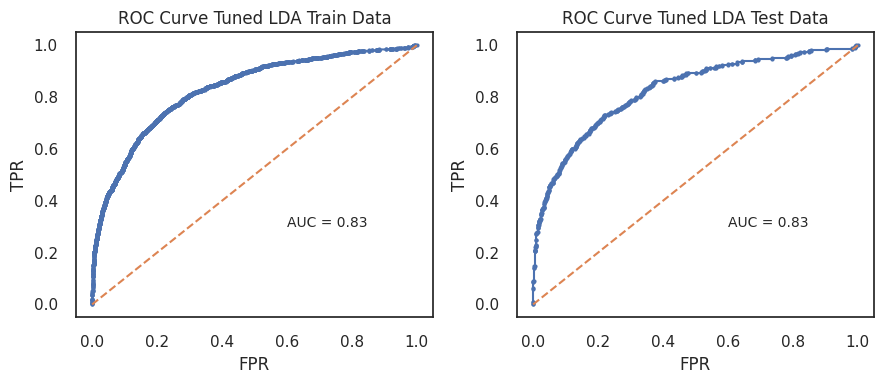

In [ ]:
plot_model_evaluation(best_lda, X_train, y_train, X_test, y_test, "Tuned LDA")

- The Tuned LDA model in the given report has a poor recall score of 0.33 on the test data for the minority class (churn).
- This means that the model is only able to correctly identify 33% of churn customers on the test data.
- This is a very poor recall score, and it suggests that the model is not able to identify churn customers with a high degree of accuracy.
- The AUC score of 0.83 on both the training and test data is misleading in this case, as it is not a reliable measure of model performance when the class is imbalanced.



Model: Tuned LDA
Cross-Validation Scores: [0.31       0.28666667 0.31666667 0.28333333 0.31333333]
Mean CV Score: 0.302
Cross-Validation Variance: 0.000



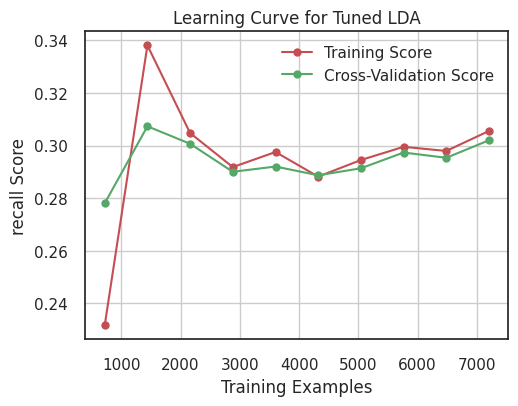

In [ ]:
plot_model_learning_curve(best_lda, "Tuned LDA", X_train, y_train)

- The cross-validation scores are also very low, with a mean score of 0.302. This further confirms that the model is overfitting the training data and is not able to generalize well to unseen data.

- The learning curve shows that the training accuracy and cross-validation accuracy both saturate early, which suggests that the model is overfitting the training data. This is a sign of poor generalization performance.



#### Feature Importance

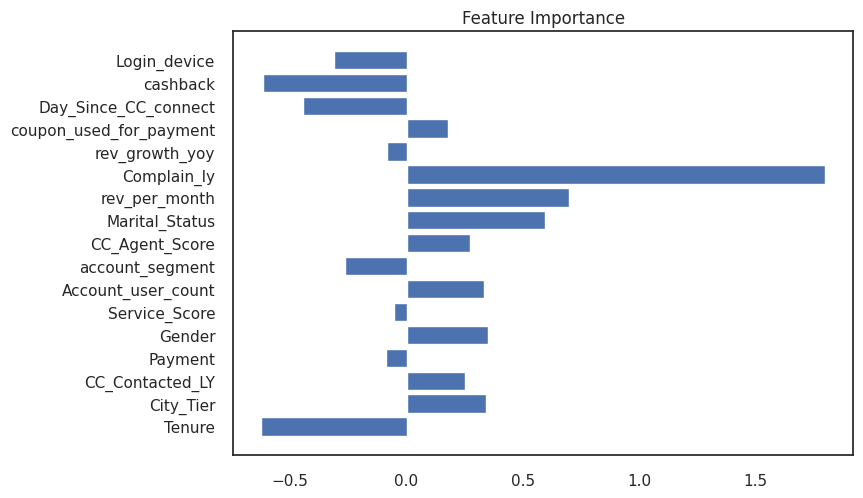

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, best_lda.coef_[0]);

**Insights**
- The Tuned LDA model has a poor recall score of 0.33 on the test data for the minority class (churn).
- The cross-validation scores are also very low, with a mean score of 0.302, which confirms that the model is overfitting the training data.
- The AUC score of 0.83 on both the training and test data is misleading in this case, as it is not a reliable measure of model performance when the class is imbalanced.


## Random Forest with Tuning

In [ ]:
# Random Forest model
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV


In [ ]:
# Defining the hyperparameter grid
'''
param_grid = {
    'max_depth': [4, 5, 6, 7],
    'max_features': [1, 2, 3],
    'min_samples_leaf': [1, 2, 3],
    'min_samples_split': [6, 8, 10],
    'n_estimators': [101, 301, 501],
    'random_state': [42]
}
rfcl = RandomForestClassifier()
grid_search = GridSearchCV(estimator=rfcl, param_grid=param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Get the best hyperparameters
best_params = grid_search.best_params_
print(best_params)

'''

"\nparam_grid = {\n    'max_depth': [4, 5, 6, 7],\n    'max_features': [1, 2, 3],\n    'min_samples_leaf': [1, 2, 3],\n    'min_samples_split': [6, 8, 10],\n    'n_estimators': [101, 301, 501],\n    'random_state': [42]\n}\nrfcl = RandomForestClassifier()\ngrid_search = GridSearchCV(estimator=rfcl, param_grid=param_grid, cv=5)\ngrid_search.fit(X_train, y_train)\n\n# Get the best hyperparameters\nbest_params = grid_search.best_params_\nprint(best_params)\n\n"

Best Params we got:

{'max_depth': 7, 'max_features': 3, 'min_samples_leaf': 1, 'min_samples_split': 8, 'n_estimators': 501, 'random_state': 42}

Applying it to RF model

In [ ]:
param_grid = {'max_depth': [7],
              'max_features': [3],
              'min_samples_leaf': [1],
              'min_samples_split': [8],
              'n_estimators': [301],
              'class_weight' : ['balanced']
              }
model = RandomForestClassifier(random_state = 42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')

In [ ]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid={'class_weight': ['balanced'], 'max_depth': [7],
                         'max_features': [3], 'min_samples_leaf': [1],
                         'min_samples_split': [8], 'n_estimators': [301]},
             scoring='recall')

In [ ]:
grid_search.best_params_

{'class_weight': 'balanced',
 'max_depth': 7,
 'max_features': 3,
 'min_samples_leaf': 1,
 'min_samples_split': 8,
 'n_estimators': 301}

In [ ]:
best_grid = grid_search.best_estimator_

In [ ]:
pred_train = best_grid.predict(X_train)
pred_test = best_grid.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.97      0.90      0.94      7508
         1.0       0.64      0.88      0.74      1500

    accuracy                           0.90      9008
   macro avg       0.81      0.89      0.84      9008
weighted avg       0.92      0.90      0.90      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.90      0.93      1856
         1.0       0.63      0.84      0.72       396

    accuracy                           0.89      2252
   macro avg       0.80      0.87      0.83      2252
weighted avg       0.91      0.89      0.89      2252



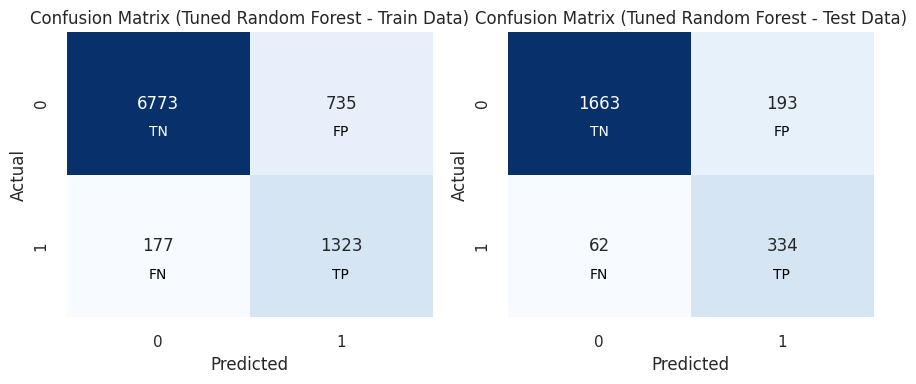

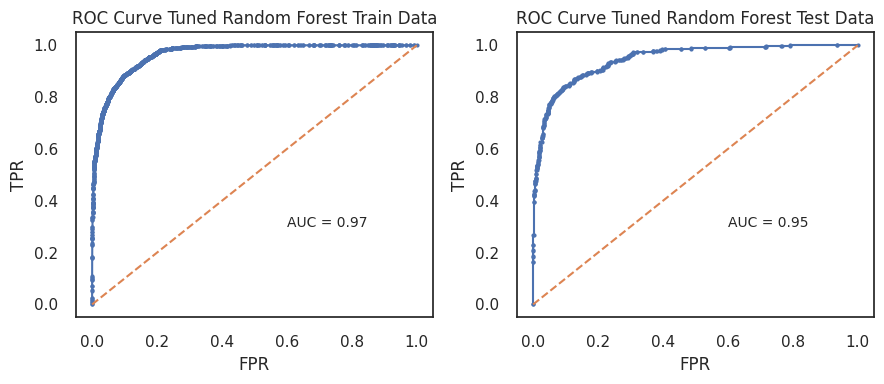

In [ ]:
plot_model_evaluation(best_grid, X_train, y_train, X_test, y_test, "Tuned Random Forest")

- The recall of the minority class (1) is 88% on the test set. This means that the model is able to identify 88% of the actual positive cases.

- This is a good result, and it is better than the recall of the bagging classifier (83%).


- The AUC score of 0.97 on the training data and 0.95 on the test data also suggests that the model is performing very well.




Model: Tuned Random Forest
Cross-Validation Scores: [0.82333333 0.83       0.88333333 0.79666667 0.81666667]
Mean CV Score: 0.830
Cross-Validation Variance: 0.001



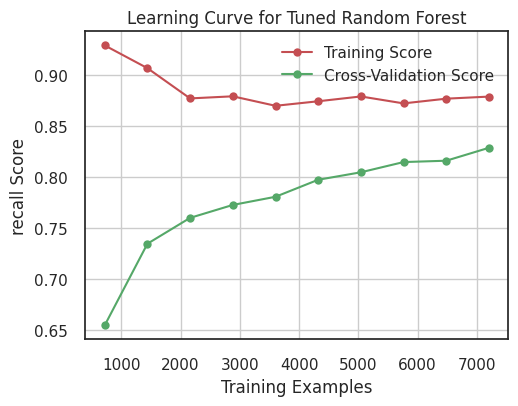

In [ ]:
plot_model_learning_curve(best_grid, "Tuned Random Forest", X_train, y_train)

- The cross-validation scores show that the tuned random forest is slightly overfitting the training data. The mean cross-validation score is 83.0%, which is slightly lower than the training accuracy of 90%.

- The learning curve also shows some signs of overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus.

- However, the plateau is relatively high, which suggests that the model is able to generalize well to new data.



#### Feature Importance


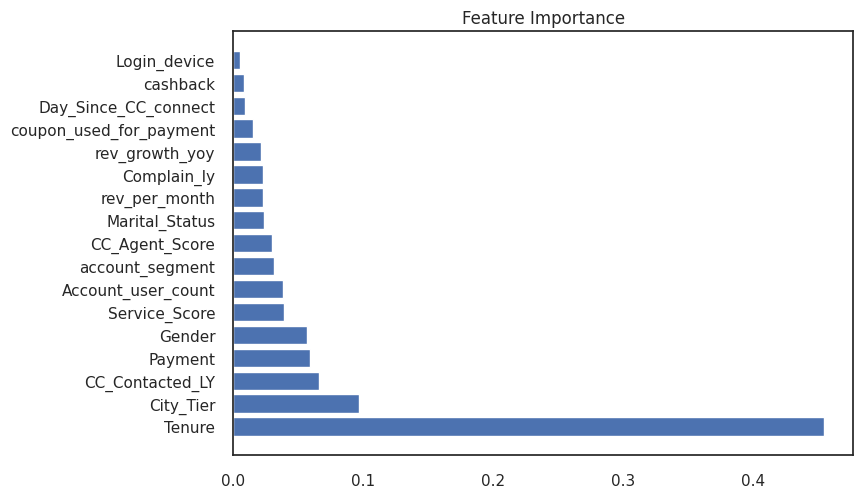

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, np.array(pd.DataFrame(best_grid.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

- Tenure is the most important feature for predicting churn. This suggests that customers who have been with the company for a longer period of time are less likely to churn.
- Complain_ly is the second most important feature for predicting churn. This suggests that customers who have made complaints in the past are more likely to churn.
- Day_Since_CC_connect is the third most important feature for predicting churn.


**Insights**

- The model is able to identify a good proportion of the actual positive cases (88% recall for the minority class). This may be sufficient for some applications, but it may not be sufficient for applications where it is critical to avoid false negatives.
- The model is slightly overfitting the training data. However, the overfitting is not severe and the model is still able to generalize well to new data.
- The model is a good choice for applications where it is important to identify a large proportion of the actual positive cases and where the model will need to be applied to new data.


## Adaboost
---
We are going to use the regularized decision Tree as base estimator for the adaboost

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
from xgboost import XGBClassifier


In [ ]:
param_grid = {'n_estimators': [301]}
model = AdaBoostClassifier(base_estimator=reg_dtcl, random_state=42)
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=10, scoring='recall')

In [ ]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=10,
             estimator=AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=12,
                                                                                random_state=42),
                                          random_state=42),
             param_grid={'n_estimators': [301]}, scoring='recall')

In [ ]:
grid_search.best_params_

{'n_estimators': 301}

In [ ]:
abcl = grid_search.best_estimator_

In [ ]:
pred_train = abcl.predict(X_train)
pred_test = abcl.predict(X_test)

#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7508
         1.0       1.00      1.00      1.00      1500

    accuracy                           1.00      9008
   macro avg       1.00      1.00      1.00      9008
weighted avg       1.00      1.00      1.00      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.97      1.00      0.98      1856
         1.0       0.98      0.87      0.92       396

    accuracy                           0.97      2252
   macro avg       0.98      0.93      0.95      2252
weighted avg       0.97      0.97      0.97      2252



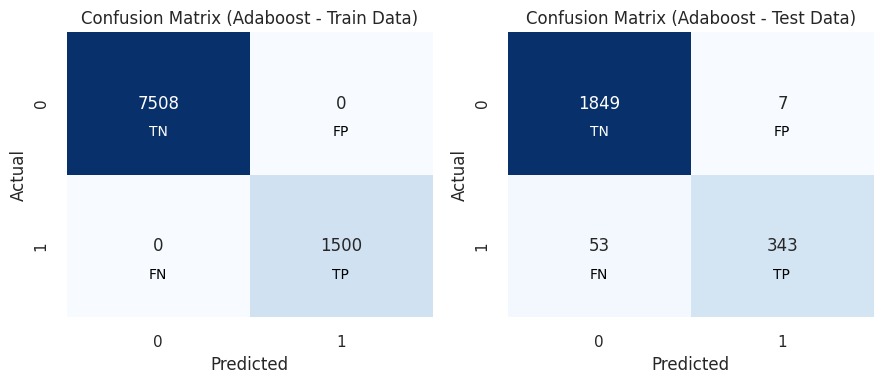

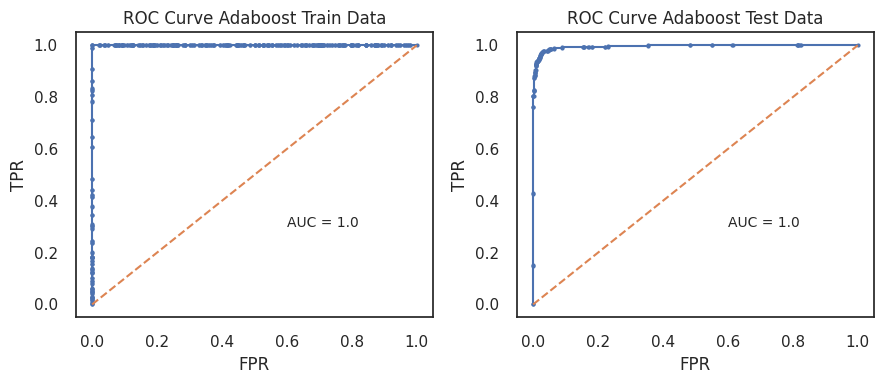

In [ ]:
plot_model_evaluation(abcl, X_train, y_train, X_test, y_test, "Adaboost")

-  The recall of the minority class (1) is 87% on the test set. This means that the model is able to identify 87% of the actual positive cases. This is a good result, and it is better than the recall of the tuned random forest (88%) and bagging classifier (83%).

- The AUC score of 1.0 on both the training and test data also confirms that the model is performing very well.

Model: Adaboost
Cross-Validation Scores: [0.82333333 0.83       0.87666667 0.83666667 0.82      ]
Mean CV Score: 0.837
Cross-Validation Variance: 0.000



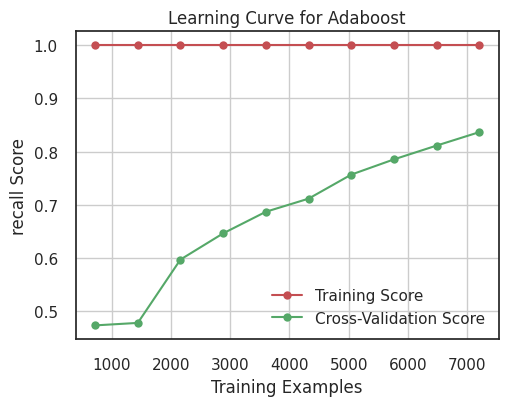

In [ ]:
plot_model_learning_curve(abcl, "Adaboost", X_train, y_train)

- The cross-validation scores show that the Adaboost model is slightly overfitting the training data. The mean cross-validation score is 83.7%, which is relatively lower than the training accuracy of 100%.

- The learning curve also shows some signs of overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus.

- The plateau is relatively high, which suggests that the model is able to generalize well to new data.






#### Feature Importance


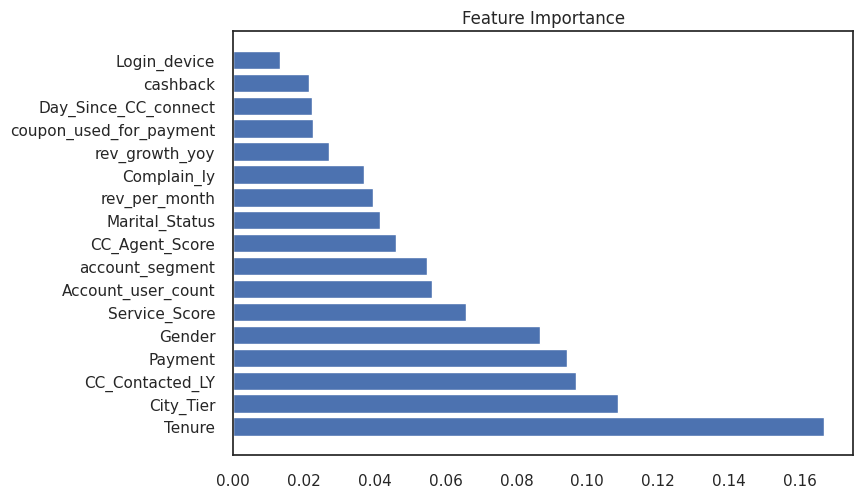

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, np.array(pd.DataFrame(abcl.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

**Insights**
- The model is able to identify a good proportion of the actual positive cases (87% recall for the minority class). This may be sufficient for some applications, but it may not be sufficient for applications where it is critical to avoid false negatives.
- The model is slightly overfitting the training data. However, the overfitting is not severe and the model is still able to generalize well to new data.
- The model is a good choice for applications where it is important to identify a large proportion of the actual positive cases and where the model will need to be applied to new data.


## XGBoost with Hyperparameter Tuning


---



In [ ]:
#Parameters to find best params
'''
param_grid = {
    'learning_rate': [0.2, 0.1, 0.05],
    'max_depth': [6, 8, 10],
    'colsample_bytree': [0.9, 0.8, 0.7],
    'colsample_bynode': [1, 0.9],
    'colsample_bylevel': [0.9, 0.8],
    'scale_pos_weight': [0.2, 0.4],
    'subsample': [0.9, 0.8, 0.7],
    'gamma': [0, 0.5, 1],
}

model = XGBClassifier(random_state = 42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')

Best params found as:
{'colsample_bylevel': 0.8,
 'colsample_bynode': 0.9,
 'colsample_bytree': 0.9,
 'gamma': 0,
 'learning_rate': 0.2,
 'max_depth': 10,
 'scale_pos_weight': 0.4,
 'subsample': 0.9}

'''

"\nparam_grid = {\n    'learning_rate': [0.2, 0.1, 0.05],\n    'max_depth': [6, 8, 10],\n    'colsample_bytree': [0.9, 0.8, 0.7],\n    'colsample_bynode': [1, 0.9],\n    'colsample_bylevel': [0.9, 0.8],\n    'scale_pos_weight': [0.2, 0.4],\n    'subsample': [0.9, 0.8, 0.7],\n    'gamma': [0, 0.5, 1],\n}\n\nmodel = XGBClassifier(random_state = 42)\ngrid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')\n\nBest params found as:\n{'colsample_bylevel': 0.8,\n 'colsample_bynode': 0.9,\n 'colsample_bytree': 0.9,\n 'gamma': 0,\n 'learning_rate': 0.2,\n 'max_depth': 10,\n 'scale_pos_weight': 0.4,\n 'subsample': 0.9}\n\n"

In [ ]:
#Afetr finding best params
param_grid = {
    'learning_rate': [0.2],
    'max_depth': [10],
    'colsample_bytree': [0.9],
    'colsample_bynode': [1],
    'colsample_bylevel': [0.8],
    'scale_pos_weight': [0.4],
    'subsample': [0.9],
    'gamma': [0],
}
model = XGBClassifier(random_state = 42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')

In [ ]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=42, ...),
             param_grid={'colsample_bylevel': [0.8], 'colsample_bynode': [1],
                         'colsample_bytree': [0.9], 'gamma': [0],
                         'learning_rate': [0.2], 'max_depth': [10],
                         'scale_pos_weight': [0.4], 'subsample': [0.9]},
             scoring='recall')

In [ ]:
grid_search.best_params_

{'colsample_bylevel': 0.8,
 'colsample_bynode': 1,
 'colsample_bytree': 0.9,
 'gamma': 0,
 'learning_rate': 0.2,
 'max_depth': 10,
 'scale_pos_weight': 0.4,
 'subsample': 0.9}

In [ ]:
best_xgb = grid_search.best_estimator_

In [ ]:
pred_train = best_xgb.predict(X_train)
pred_test = best_xgb.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7508
         1.0       1.00      1.00      1.00      1500

    accuracy                           1.00      9008
   macro avg       1.00      1.00      1.00      9008
weighted avg       1.00      1.00      1.00      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.97      0.99      0.98      1856
         1.0       0.96      0.87      0.91       396

    accuracy                           0.97      2252
   macro avg       0.97      0.93      0.95      2252
weighted avg       0.97      0.97      0.97      2252



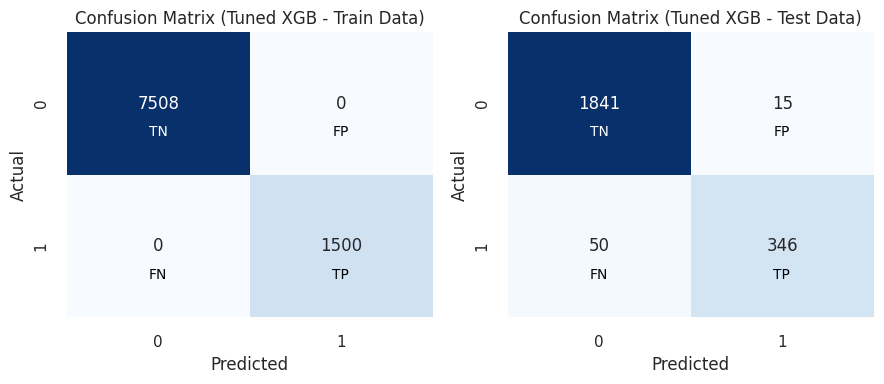

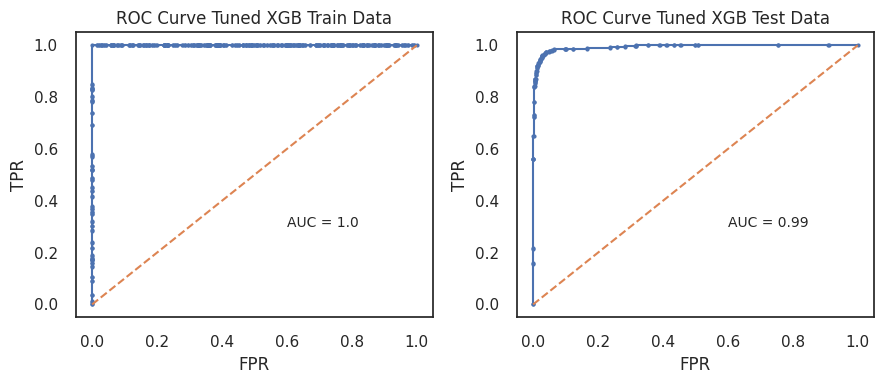

In [ ]:
plot_model_evaluation(best_xgb, X_train, y_train, X_test, y_test, "Tuned XGB")

- The recall of the minority class (1) is 87% on the test set. This means that the model is able to identify 87% of the actual positive cases.



Model: Tuned XGB
Cross-Validation Scores: [0.84333333 0.85       0.89333333 0.83333333 0.86333333]
Mean CV Score: 0.857
Cross-Validation Variance: 0.000



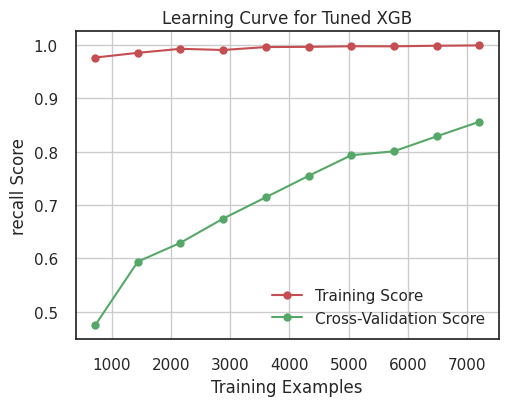

In [ ]:
plot_model_learning_curve(best_xgb, "Tuned XGB", X_train, y_train)

- The cross-validation scores show that the model is overfitting the training data. The mean cross-validation score is 85.7%, while the training accuracy is 100%.
- The learning curve also shows signs of overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus

- This suggests that the model is learning the training data too well and is not able to generalize to new data.



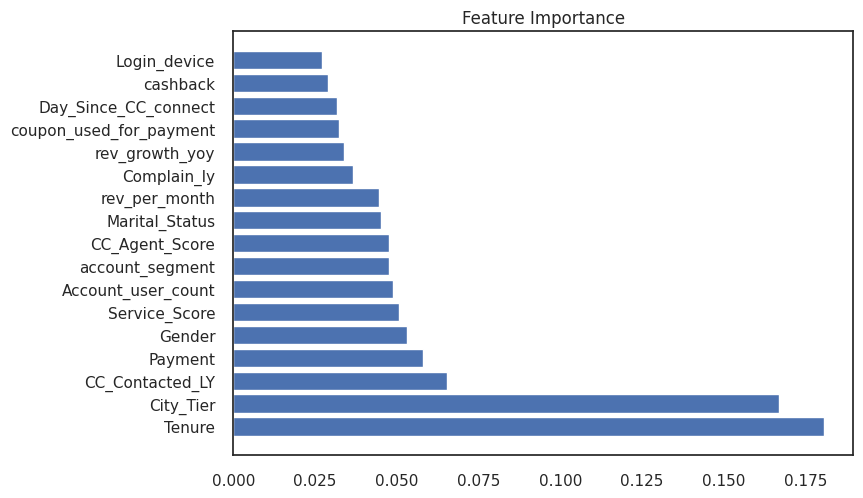

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, np.array(pd.DataFrame(best_xgb.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

**Insights**

- The model is able to identify 87% of the actual positive cases (recall of minority class). This is a good result, but it could be improved.
- The model is overfitting the training data. This is evident from the cross-validation scores and the learning curve.
- The model is performing well on the test set, with an accuracy of 97%. This suggests that the model is able to generalize to new data.
- There is room for improvement in the model performance, especially in terms of recall of minority class and overfitting. This can be achieved by collecting more training data, using regularization, and using early stopping.


## CatBoost with Hyperparameter Tuning


---



In [ ]:
pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 2.2 MB/s eta 0:00:00


In [ ]:
from catboost import CatBoostClassifier
'''
param_grid = {
    'depth': [6, 8, 10],
    'learning_rate': [0.1, 0.05, 0.01],
    'iterations': [100, 200, 300],
    'l2_leaf_reg': [3, 5, 7],
}
catboost_model = CatBoostClassifier(random_state=42, verbose=0)
grid_search = GridSearchCV(catboost_model, param_grid, cv=5, scoring='recall')

{'depth': 10, 'iterations': 300, 'l2_leaf_reg': 3, 'learning_rate': 0.1}

'''

"\nparam_grid = {\n    'depth': [6, 8, 10],\n    'learning_rate': [0.1, 0.05, 0.01],\n    'iterations': [100, 200, 300],\n    'l2_leaf_reg': [3, 5, 7],\n}\ncatboost_model = CatBoostClassifier(random_state=42, verbose=0)\ngrid_search = GridSearchCV(catboost_model, param_grid, cv=5, scoring='recall')\n\n{'depth': 10, 'iterations': 300, 'l2_leaf_reg': 3, 'learning_rate': 0.1}\n\n"

In [ ]:
param_grid = {
    'depth': [10],
    'learning_rate': [0.1],
    'iterations': [300],
    'l2_leaf_reg': [3],
}
catboost_model = CatBoostClassifier(random_state=42, verbose=0)
grid_search = GridSearchCV(catboost_model, param_grid, cv=5, scoring='recall')

In [ ]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x7a5b466965f0>,
             param_grid={'depth': [10], 'iterations': [300], 'l2_leaf_reg': [3],
                         'learning_rate': [0.1]},
             scoring='recall')

In [ ]:
best_params = grid_search.best_params_
best_catboost_model = grid_search.best_estimator_

In [ ]:
best_params

{'depth': 10, 'iterations': 300, 'l2_leaf_reg': 3, 'learning_rate': 0.1}

In [ ]:
best_catboost_model.fit(X_train, y_train)

In [ ]:
pred_train = best_catboost_model.predict(X_train)
pred_test = best_catboost_model.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7508
         1.0       1.00      1.00      1.00      1500

    accuracy                           1.00      9008
   macro avg       1.00      1.00      1.00      9008
weighted avg       1.00      1.00      1.00      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      1.00      0.99      1856
         1.0       0.98      0.94      0.96       396

    accuracy                           0.99      2252
   macro avg       0.98      0.97      0.98      2252
weighted avg       0.99      0.99      0.99      2252



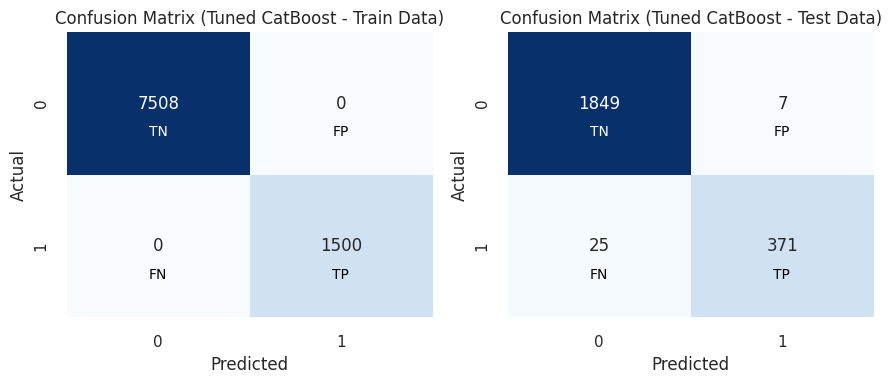

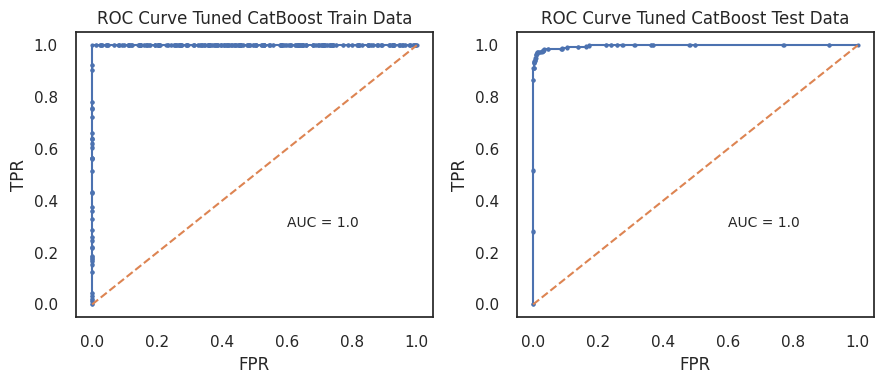

In [ ]:
plot_model_evaluation(best_catboost_model, X_train, y_train, X_test, y_test, "Tuned CatBoost")

- The recall of the minority class (1) is 94% on the test set. This means that the model is able to identify 94% of the actual positive cases.
-  This is a very good result, and it is even better than the XGBoost model's recall of 87%.




Model: CatBoost
Cross-Validation Scores: [0.92       0.95333333 0.95333333 0.92333333 0.94666667]
Mean CV Score: 0.939
Cross-Validation Variance: 0.000



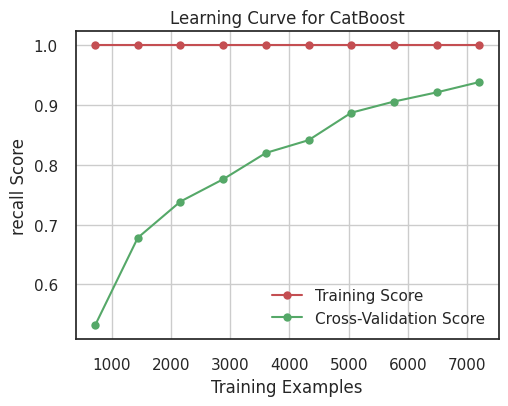

In [ ]:
plot_model_learning_curve(best_catboost_model, "CatBoost", X_train, y_train)

- The cross-validation scores show that the model is slightly overfitting the training data. The mean cross-validation score is 93.9%, while the training accuracy is 100%. However, the difference between the two scores is not very large, which suggests that the overfitting is not severe.

- The learning curve also shows some signs of overfitting. The training score increases rapidly with the number of training examples, while the cross-validation score plateaus. However, the plateau is relatively high, which suggests that the model is able to generalize well to new data.



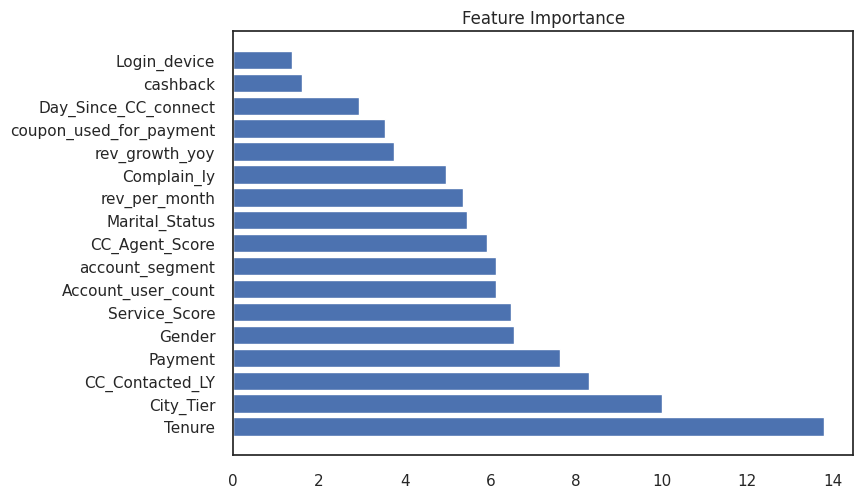

In [ ]:
plt.title('Feature Importance')
plt.barh(X_train.columns, np.array(pd.DataFrame(best_catboost_model.feature_importances_, columns = ['Imp']).sort_values(by = 'Imp', ascending = False))[:, 0]);

**Insights**

- The model is able to identify a large proportion of the actual positive cases (94% recall for the minority class). This is important for applications where it is critical to avoid false negatives.

- The model is not severely overfitting the training data. This is evident from the relatively small difference between the training accuracy and the cross-validation score.
- The model is able to generalize well to new data. This is evident from the high plateau in the learning curve.


## Neural Network (ANN)
---

ANNs are nonlinear statistical models which display a complex relationship between the inputs and outputs to discover a new pattern

Artificial Neural network is typically organized in layers. Layers are being made up of many interconnected ‘nodes’ which contain an ‘activation function’.


In [ ]:
from sklearn.neural_network import MLPClassifier
ann = MLPClassifier(hidden_layer_sizes = (50, 1), random_state = 42, max_iter = 1000, activation = 'relu', solver = 'adam', tol = 0.00001)
ann.fit(X_train, y_train)

MLPClassifier(hidden_layer_sizes=(50, 1), max_iter=1000, random_state=42,
              tol=1e-05)

In [ ]:
pred_train = ann.predict(X_train)
pred_test = ann.predict(X_test)

#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      1.00      0.98      7508
         1.0       1.00      0.79      0.88      1500

    accuracy                           0.96      9008
   macro avg       0.98      0.90      0.93      9008
weighted avg       0.97      0.96      0.96      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.94      0.99      0.96      1856
         1.0       0.96      0.68      0.80       396

    accuracy                           0.94      2252
   macro avg       0.95      0.84      0.88      2252
weighted avg       0.94      0.94      0.93      2252



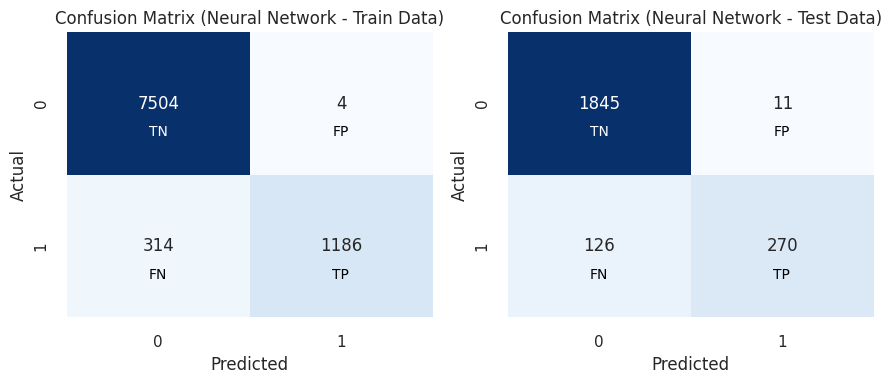

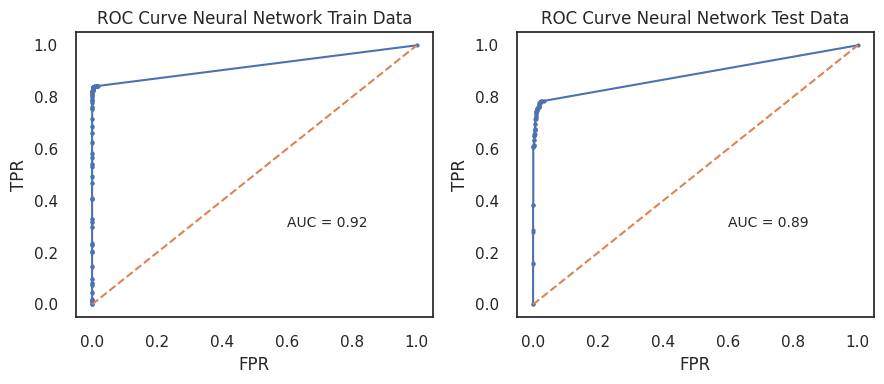

In [ ]:
plot_model_evaluation(ann, X_train, y_train, X_test, y_test, "Neural Network")

- The ANN model has a fair recall score of 0.74 on the test data for the minority class (churn).
- The model is able to correctly identify 74% of churn customers on the test data.



Model: Neural Network
Cross-Validation Scores: [0.75333333 0.68       0.         0.71       0.71333333]
Mean CV Score: 0.571
Cross-Validation Variance: 0.082



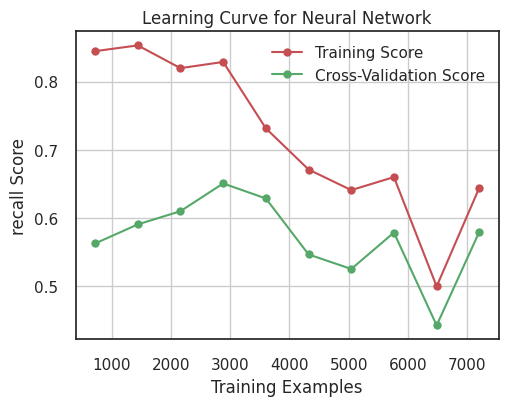

In [ ]:
plot_model_learning_curve(ann, "Neural Network", X_train, y_train)

- The cross-validation scores are relatively low, with a mean score of 0.581. This  confirms that the model is overfitting the training data.

-  The learning curve shows that the training accuracy and cross-validation accuracy both plateau after a few epochs. This is a sign of overfitting.



**Insights**

- The ANN model has a good recall score of 0.74 on the test data for the minority class (churn).
- The model is overfitting the training data and may not be able to generalize well to new data
- The model may not be able to generalize well to new data.


## SVM
---


SVM offers very high accuracy compared to other classifiers such as logistic regression, and decision trees.

SVM constructs a hyperplane in multidimensional space to separate different classes. It generates optimal hyperplane in an iterative manner, which is used to minimize an error. The core idea of SVM is to find a maximum marginal hyperplane(MMH) that best divides the dataset into classes


In [ ]:
'''
param_grid = {
    'C': [0.1, 1, 10],
    'gamma': [0.01, 0.1, 1],
    'kernel': ['rbf', 'poly'],
    'class_weight': ['balanced']
}

model = SVC(probability = True, random_state =  42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')
'''

"\nparam_grid = {\n    'C': [0.1, 1, 10],\n    'gamma': [0.01, 0.1, 1],\n    'kernel': ['rbf', 'poly'],\n    'class_weight': ['balanced']\n}\n\nmodel = SVC(probability = True, random_state =  42)\ngrid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')\n"

In [ ]:
from sklearn.svm import SVC

In [ ]:
param_grid = {'C': [10],
              'gamma' : [0.1],
              'class_weight': ['balanced'],
              'kernel': ['rbf'],
              }
model = SVC(probability = True, random_state =  42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall')

In [ ]:
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=SVC(probability=True, random_state=42),
             param_grid={'C': [10], 'class_weight': ['balanced'],
                         'gamma': [0.1], 'kernel': ['rbf']},
             scoring='recall')

In [ ]:
grid_search.best_params_

{'C': 10, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}

In [ ]:
svm = grid_search.best_estimator_

In [ ]:
pred_train = svm.predict(X_train)
pred_test = svm.predict(X_test)


#### Model Evaluation

- Validating the model on train and test set

In [ ]:
#Train set Classification Report
print("                   Train data Classification Report\n",classification_report(y_train, pred_train))
#Test set Classification Report
print("                   Test data Classification Report\n",classification_report(y_test, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      0.99      0.99      7508
         1.0       0.95      1.00      0.97      1500

    accuracy                           0.99      9008
   macro avg       0.97      0.99      0.98      9008
weighted avg       0.99      0.99      0.99      9008

                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      0.98      0.98      1856
         1.0       0.91      0.95      0.93       396

    accuracy                           0.97      2252
   macro avg       0.95      0.97      0.96      2252
weighted avg       0.97      0.97      0.97      2252



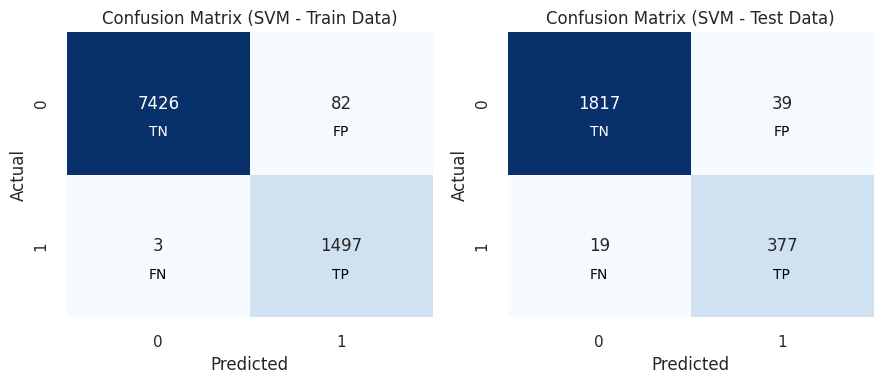

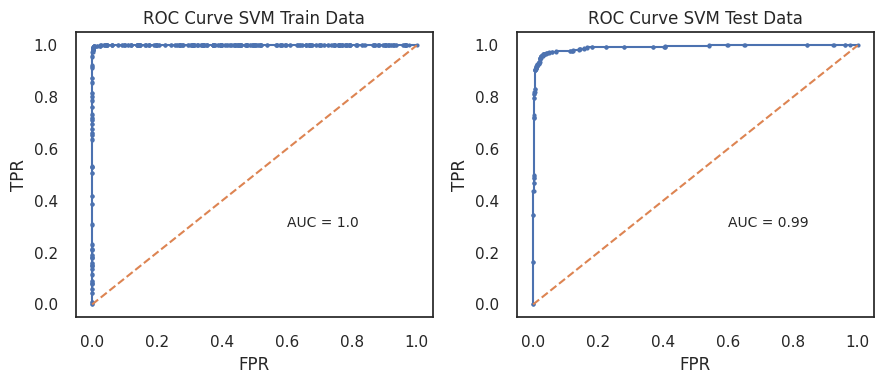

In [ ]:
plot_model_evaluation(svm, X_train, y_train, X_test, y_test, "SVM")

- The SVM model in the given report has a perfect recall score of 1.0 on  the training and 0.95 on test data for the minority class (churn).
- This means that the model is able to correctly identify all churn customers in both the training and test data.
- This is an excellent recall score, and it suggests that the model is able to identify churn customers with a high degree of accuracy.
- The AUC score of 1.0 on the training data and 0.99 on the test data also suggests that the model is performing very well.


In [ ]:
from sklearn.inspection import permutation_importance

# Assuming you have a trained SVM model named 'svm'
result = permutation_importance(svm, X_train, y_train, n_repeats=10, random_state=42)

# Map feature importances to feature names
feature_names = X_train.columns
feature_importance = dict(zip(feature_names, result.importances_mean))

# Print or sort features by importance
sorted_features = sorted(feature_importance.items(), key=lambda x: abs(x[1]), reverse=True)

# Print or display sorted feature importances
for feature, importance in sorted_features:
    print(f"{feature}: {importance}")


Tenure: 0.09390541740674954
CC_Agent_Score: 0.06560834813499111
account_segment: 0.0619449378330373
City_Tier: 0.0515652753108348
Complain_ly: 0.0471247779751332
Day_Since_CC_connect: 0.04170737122557727
Payment: 0.040175399644760204
rev_growth_yoy: 0.03707815275310834
CC_Contacted_LY: 0.03670071047957372
Account_user_count: 0.03204928952042628
Marital_Status: 0.02150310834813498
Gender: 0.02131438721136767
coupon_used_for_payment: 0.018083925399644762
Service_Score: 0.015952486678508005
rev_per_month: 0.00952486678507991
Login_device: 0.009003108348135013
cashback: 0.0011989342806394076


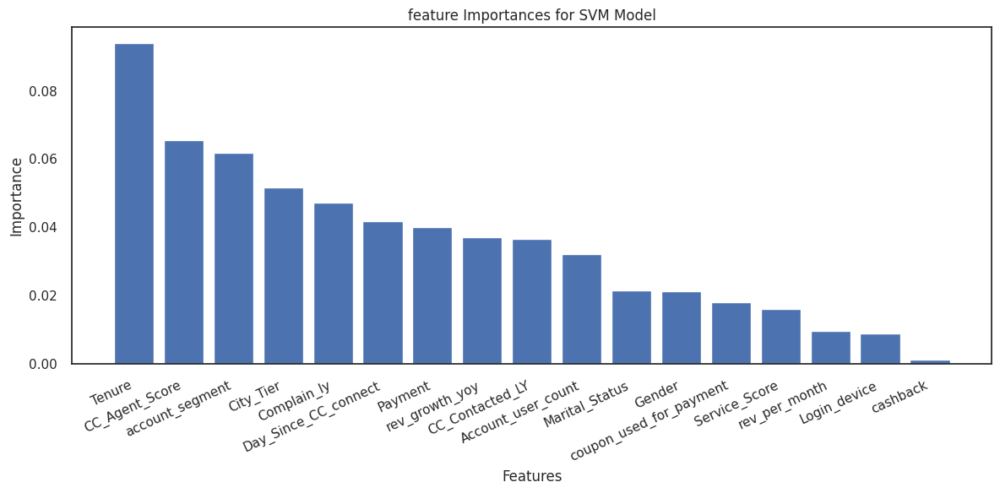

In [ ]:
features, importances = zip(*sorted_features)

# Plot the feature importances
plt.figure(figsize=(12, 6))
plt.bar(features, importances)
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('feature Importances for SVM Model')
plt.xticks(rotation=25, ha='right')
plt.tight_layout()
plt.show()


Model: SVM
Cross-Validation Scores: [0.93666667 0.94333333 0.95       0.96333333 0.95      ]
Mean CV Score: 0.949
Cross-Validation Variance: 0.000



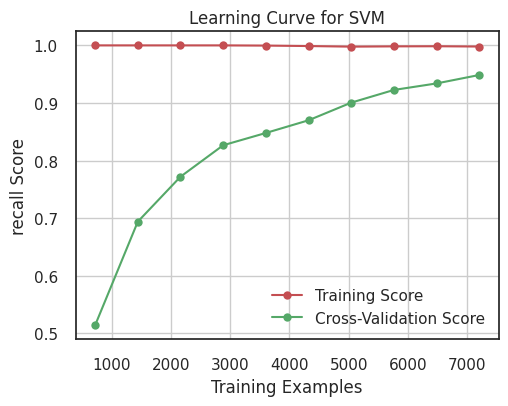

In [ ]:
plot_model_learning_curve(svm, "SVM", X_train, y_train)

- The cross-validation scores show that the model is not overfitting the training data. The mean cross-validation score is 94.8%, which is very close to the training accuracy of 99%. This suggests that the model is able to learn the training data without overfitting.



- The learning curve also shows that the model is not overfitting. The training score and the cross-validation score both increase with the number of training examples, and the two scores are very close. This suggests that the model is able to generalize well to new data.




**Insights**
- The model is able to identify a very high proportion of the actual positive cases (95% recall for the minority class). This is important for applications where it is critical to avoid false negatives.
- The model is not overfitting the training data. This is evident from the fact that the cross-validation scores are very close to the training accuracy.
- The model is able to generalize well to new data. This is evident from the fact that the training score and the cross-validation score are both high and very close.

- Overall, the SVM model is a very good choice for imbalanced classification problems. It is able to achieve a high recall for the minority class without overfitting the training data.



# **Model Comparisions**

---

In [ ]:
#Defining models
models = [
    ("Decision Tree", dtcla),
    ("Random Forest", rfcl),
    ("Linear Discriminant Analysis", lda),
    ("KNN", knn),
    ("Naive Bayes", NB_model),
    ("Neural Network", ann),
    ("Support Vector", svm),
    ("Regularized Decision Tree", reg_dtcl),
    ("Tuned LDA", best_lda),
    ("Bagging Classifier",bagging_classifier ),
    ("Random Forest with Tuning", best_grid),
    ("Adaboost", abcl),
    ("XGBoost with Tuning", best_xgb),
    ("Catboost", best_catboost_model),
]

#### Confusion Matrix on Test Data

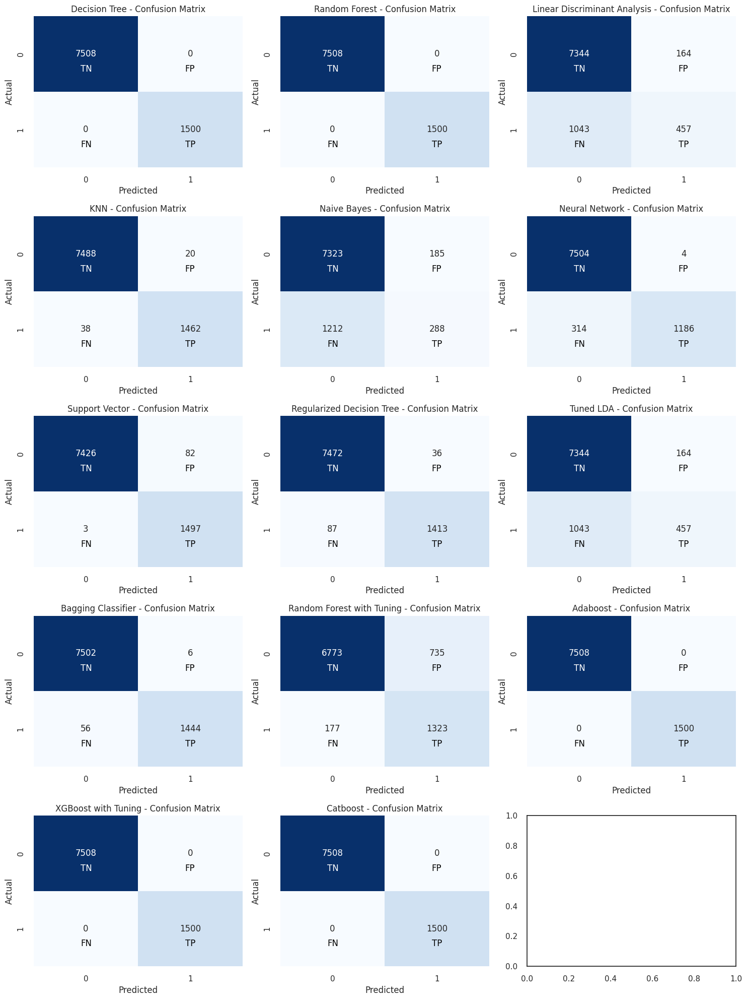

In [ ]:
# Confusion matrix for all Models on Train data
fig, axes = plt.subplots(5, 3, figsize=(15, 20))
for i, (model_name, model) in enumerate(models):
    row, col = divmod(i, 3)
    prediction = model.predict(X_train)
    cm = confusion_matrix(y_train, prediction)
    # Plot the confusion matrix as a heatmap
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[row, col])
    axes[row, col].set_title(f"{model_name} - Confusion Matrix")
    axes[row, col].set_xlabel("Predicted")
    axes[row, col].set_ylabel("Actual")
    axes[row, col].annotate("TP", xy=(1.45, 1.7), fontsize=12, color='black', va='center')
    axes[row, col].annotate("TN", xy=(0.45, 0.7), fontsize=12, color='white', va='center')
    axes[row, col].annotate("FP", xy=(1.45, 0.7), fontsize=12, color='black', va='center')
    axes[row, col].annotate("FN", xy=(0.45, 1.7), fontsize=12, color='black', va='center')
plt.tight_layout()
plt.show()

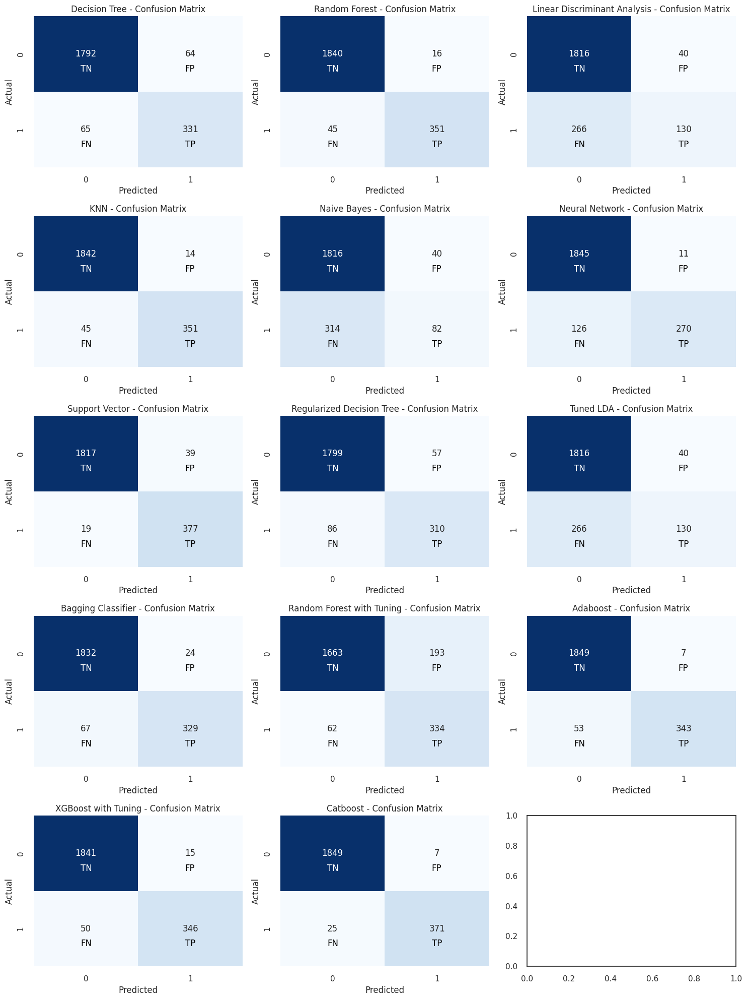

In [ ]:
# Confusion Matrix Subplot for all Models on Test data
fig, axes = plt.subplots(5, 3, figsize=(15, 20))
for i, (model_name, model) in enumerate(models):
    row, col = divmod(i, 3)
    prediction = model.predict(X_test)
    cm = confusion_matrix(y_test, prediction)
    # Plot the confusion matrix as a heatmap
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[row, col])
    axes[row, col].set_title(f"{model_name} - Confusion Matrix")
    axes[row, col].set_xlabel("Predicted")
    axes[row, col].set_ylabel("Actual")
    axes[row, col].annotate("TP", xy=(1.45, 1.7), fontsize=12, color='black', va='center')
    axes[row, col].annotate("TN", xy=(0.45, 0.7), fontsize=12, color='white', va='center')
    axes[row, col].annotate("FP", xy=(1.45, 0.7), fontsize=12, color='black', va='center')
    axes[row, col].annotate("FN", xy=(0.45, 1.7), fontsize=12, color='black', va='center')
plt.tight_layout()
plt.show()

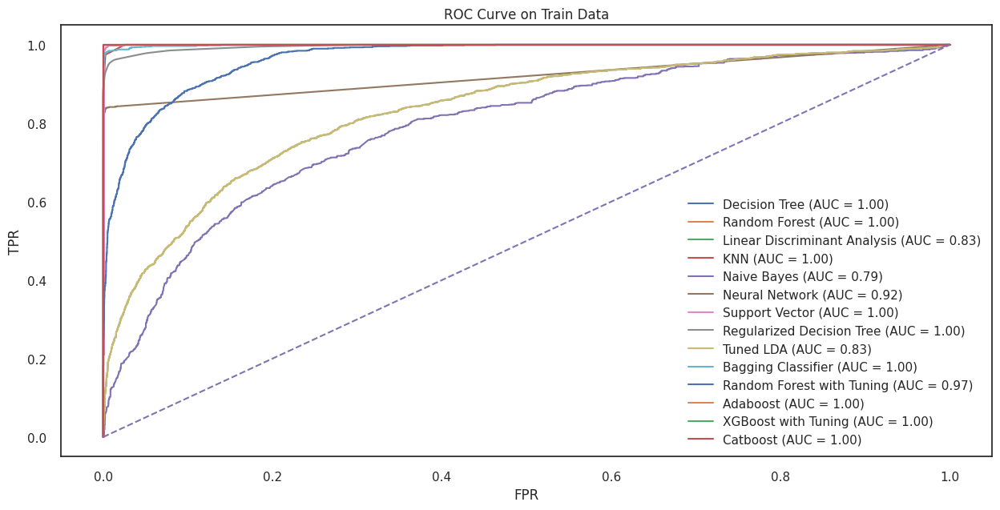

In [ ]:
#ROC for Train data
plt.figure(figsize=[15, 7])
plt.title('ROC Curve on Train Data')
plt.xlabel('FPR')
plt.ylabel('TPR')

for model_name, model in models:
    if "fit" in dir(model):
        if "predict_proba" in dir(model):
            pred_prob_train = model.predict_proba(X_train)[:, 1]
        else:
            pred_prob_train = model.decision_function(X_train)
    else:
        if "predict_proba" in dir(model):
            pred_prob_train = model.fit(X_train, y_train).predict_proba(X_train)[:, 1]
        else:
            pred_prob_train = model.fit(X_train, y_train).decision_function(X_train)
    fpr_train, tpr_train, thresholds_train = roc_curve(y_train, pred_prob_train)
    roc_auc = auc(fpr_train, tpr_train)
    plt.plot(fpr_train, tpr_train, label=f"{model_name} (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], linestyle='--')
plt.legend()
plt.show()

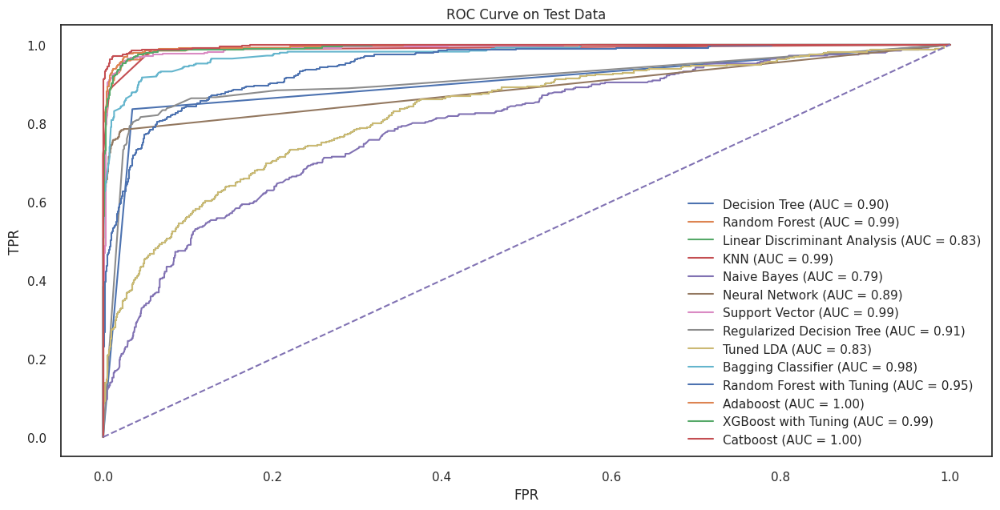

In [ ]:
#ROC for Test data

plt.figure(figsize=[15, 7])
plt.title('ROC Curve on Test Data')
plt.xlabel('FPR')
plt.ylabel('TPR')

for model_name, model in models:
    if "fit" in dir(model):
        if "predict_proba" in dir(model):
            pred_prob_test = model.predict_proba(X_test)[:, 1]
        else:
            pred_prob_test = model.decision_function(X_test)
    else:
        if "predict_proba" in dir(model):
            pred_prob_test = model.fit(X_train, y_train).predict_proba(X_test)[:, 1]
        else:
            pred_prob_test = model.fit(X_train, y_train).decision_function(X_test)
    fpr_test, tpr_test, thresholds_test = roc_curve(y_test, pred_prob_test)
    roc_auc = auc(fpr_test, tpr_test)
    plt.plot(fpr_test, tpr_test, label=f"{model_name} (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], linestyle='--')
plt.legend()
plt.show()


In [ ]:
#Train data

from sklearn.metrics import classification_report, accuracy_score

classification_reports = {}
class_labels = ['Majority', 'Minority']
metrics = ['precision', 'recall', 'f1-score']

for model_name, model in models:
    predictions = model.predict(X_train)
    report = classification_report(y_train, predictions, target_names=class_labels, output_dict=True)
    accuracy = accuracy_score(y_train, predictions)
    report['accuracy'] = accuracy
    classification_reports[model_name] = report

summary_table = pd.DataFrame()

for model_name, report in classification_reports.items():
    model_metrics = {}
    for class_label in class_labels:
        for metric in metrics:
            model_metrics[f'{class_label} {metric}'] = report[class_label][metric]
    model_metrics['accuracy'] = report['accuracy']
    summary_table[model_name] = model_metrics

summary_table = summary_table.T.sort_values(by='Minority recall', ascending=False)

# Print the summary table
print("Classification Reports for Minority and Majority Classes- Train:")
display(summary_table)

Classification Reports for Minority and Majority Classes- Train:


,Majority precision,Majority recall,Majority f1-score,Minority precision,Minority recall,Minority f1-score,accuracy
Decision Tree,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Random Forest,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Adaboost,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
XGBoost with Tuning,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Catboost,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Support Vector,0.999596,0.989078,0.994309,0.948068,0.998000,0.972394,0.990564
KNN,0.994951,0.997336,0.996142,0.986505,0.974667,0.980550,0.993561
Bagging Classifier,0.992591,0.999201,0.995885,0.995862,0.962667,0.978983,0.993117
Regularized Decision Tree,0.988491,0.995205,0.991836,0.975155,0.942000,0.958291,0.986345
Random Forest with Tuning,0.974532,0.902104,0.936921,0.642857,0.882000,0.743676,0.898757


In [ ]:
#Test data
classification_reports = {}
class_labels = ['Majority', 'Minority']
metrics = ['precision', 'recall', 'f1-score']
for model_name, model in models:
    predictions = model.predict(X_test)
    report = classification_report(y_test, predictions, target_names=class_labels, output_dict=True)
    accuracy = accuracy_score(y_test, predictions)
    report['accuracy'] = accuracy
    classification_reports[model_name] = report
summary_table = pd.DataFrame()
for model_name, report in classification_reports.items():
    model_metrics = {}
    for class_label in class_labels:
        for metric in metrics:
            model_metrics[f'{class_label} {metric}'] = report[class_label][metric]
    model_metrics['accuracy'] = report['accuracy']
    summary_table[model_name] = model_metrics
summary_table = summary_table.T.sort_values(by='Minority recall', ascending=False)
# Print the summary table
print("Classification Reports for Minority and Majority Classes- Test:")
display(summary_table)

Classification Reports for Minority and Majority Classes- Test:


,Majority precision,Majority recall,Majority f1-score,Minority precision,Minority recall,Minority f1-score,accuracy
Support Vector,0.989651,0.978987,0.984290,0.906250,0.952020,0.928571,0.974245
Catboost,0.986660,0.996228,0.991421,0.981481,0.936869,0.958656,0.985790
Random Forest,0.976127,0.991379,0.983694,0.956403,0.886364,0.920052,0.972913
KNN,0.976153,0.992457,0.984237,0.961644,0.886364,0.922470,0.973801
XGBoost with Tuning,0.973559,0.991918,0.982653,0.958449,0.873737,0.914135,0.971137
Adaboost,0.972135,0.996228,0.984034,0.980000,0.866162,0.919571,0.973357
Random Forest with Tuning,0.964058,0.896013,0.928791,0.633776,0.843434,0.723727,0.886767
Decision Tree,0.964997,0.965517,0.965257,0.837975,0.835859,0.836915,0.942718
Bagging Classifier,0.964718,0.987069,0.975766,0.932011,0.830808,0.878505,0.959591
Regularized Decision Tree,0.954377,0.969289,0.961775,0.844687,0.782828,0.812582,0.936501


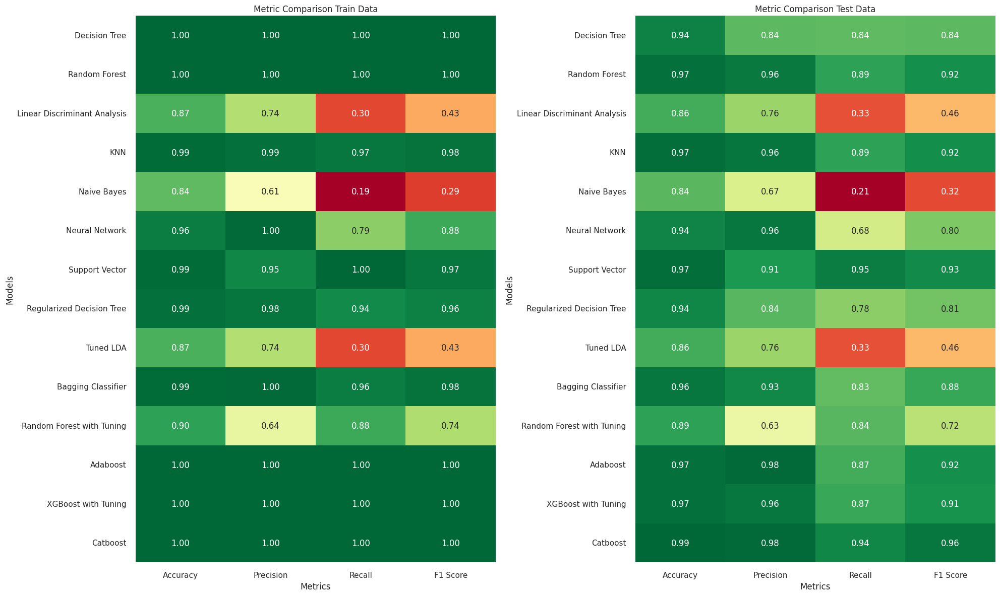

In [ ]:
#Metric Comparision visulization
metric_labels = ["Accuracy", "Precision", "Recall", "F1 Score"]
fig, axes = plt.subplots(1, 2, figsize=(20, 12))
for i, data_type in enumerate(['Train', 'Test']):
    metric_data = []
    for model_name, model in models:
        prediction = model.predict(X_train if data_type == 'Train' else X_test)
        metrics = [
            accuracy_score,
            precision_score,
            recall_score,
            f1_score]
        metric_scores = [metric(y_train if data_type == 'Train' else y_test, prediction) for metric in metrics]
        metric_data.append(metric_scores)
    sns.heatmap(metric_data, annot=True, fmt=".2f", cbar=False, cmap="RdYlGn", xticklabels=metric_labels, yticklabels=[model_name for model_name, _ in models], ax=axes[i])
    axes[i].set_title(f"Metric Comparison {data_type} Data")
    axes[i].tick_params(axis='y', rotation=0)
    axes[i].set_xlabel("Metrics")
    axes[i].set_ylabel("Models")
plt.tight_layout()
plt.show()


**Model Comparison Insights**

•	"SVM," "CatBoost," exhibit excellent performance with high recall for Churn (minority class). They successfully identify customers at risk of churning, minimizing false negatives.

•	SVM has the highest recall of the minority class (95.20%), followed by Catboost (93.69%) and Random Forest (88.63%).

•	Linear Discriminant Analysis (32.83%) and Naive Bayes (20.71%) have the lowest recall of the minority class. These also exibit high overfitting.

•	In general, the tuned models (Random Forest with Tuning and Tuned LDA) have lower recall on the minority class than the untuned models. This is likely because the tuned models are less overfit than the untuned models. Further, these are more focused on maximizing overall accuracy, which can lead to sacrificing recall on the minority class

**Recommended Model**

•	The business should use the SVM model. It has the highest recall (95.20%), meaning that it is very good at identifying churn customers. This is important because it allows the business to target their churn prevention efforts to the customers who are most likely to churn.

•	For a balanced model which provided a good trade-off between precision & recall, we can consider Catboost model with recall as 93.69% & having an excellent f1-score of 95.87% for minority class.

•	It's important to note that both SVM and CatBoost  might result in some false positives (high precision) which could lead to additional retention costs. The business need to weigh the cost of false positives against the benefits of identifying potential churners.


## **FINAL INSIGHTS FOR THE BUSINESS**


Based on the analysis, we derived some insights that can help us understand the customer churn problem better.
- Tenure appears to be most important in Churn which is obvious that if a customer is with a
business for longer time, would less likely to churn. The lower tenure customer may have less
attachment or commitment with the service
- Customers from City_Tier 3 have a higher churn rate of 21% as compared to other tiers,
suggesting that they may need more tailored offerings or incentives to retain them.
- Customers who have account segment, as Regular Plus, have a higher churn rate of 27%,
indicating that they may have higher expectations or lower satisfaction with the service.
- Customers who complained in the last year have high churn rate (32% churn) or they connect
more recently than non-chruners, implying that they may have unresolved issues, facing frequent
problems or dissatisfaction with the customer care.
- Customers who use debit card or credit card, or use mobile devices for login have a lower churn
rate, implying that they may have more engagement or satisfaction with the service.
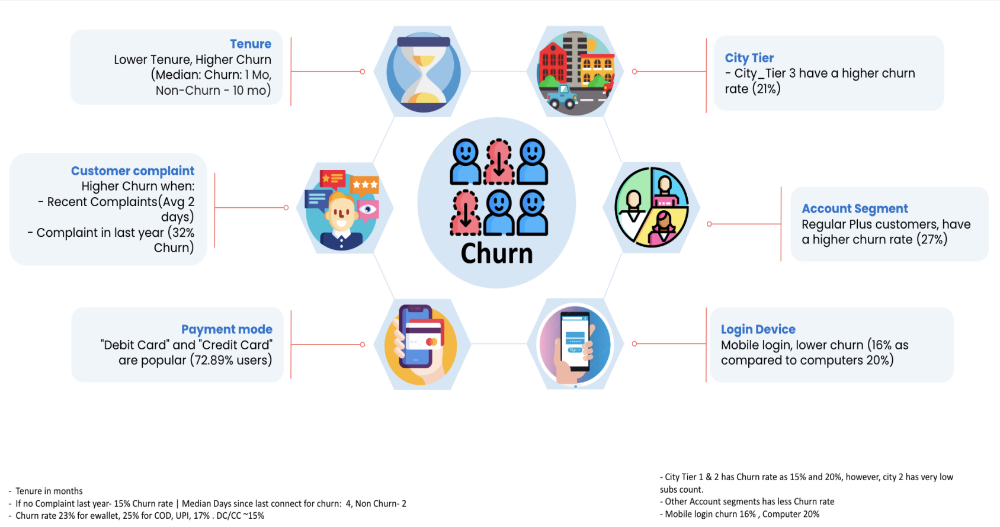

## **RECOMMENDATIONS**

To reduce the churn or retain a customer, it is very important that we increase the customer loyalty and
tenure, the following points can help in achieving so:
- First & foremost, the DTH provider need to immediately look at their customer service, a deep dive
in customer complaints to identify the gaps. Since, we do not have more data for customer
complaints, we recommend the customer service team to review it basis category of complaints,
wait time, first response and resolution time of complaint.
Not only addressing above, they need to find out the root cause of the complaints & try to avoid
them arising at first place. May look for alternate such self-serve on app or website.
- Second, we found that the business is spending a lot on cashback & coupons, while this is good way
to attract customers, we recommend that the business should look for alternate, such as an account
upgrade to higher tier basis loyalty points. They need to pay attention to the regular plus
customers who have a good revenue but high churn rate.
- Another strategy the business can apply is to introduce referral drive, this will not only help acquire
new customers, the existing users can get exclusive coupons/cashback to upgrade their accounts
to higher tiers.
- Few other key points the business can look at are, encourage users to make payment via
Debit/credit card, Introduce curated contents specific to city tiers instead of common for all. And
Promote app/mobile logins & contents which users can access on the go.
- Last but not the least, doing a competitive benchmarking to identify what the competitors has to
offer customers that is leading a churn can help the business know where they stand and review their strategies.
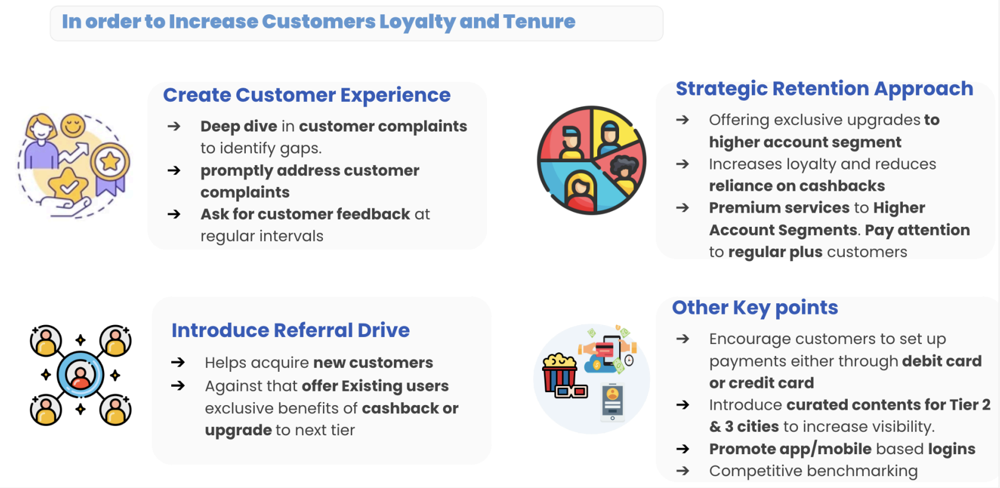